In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter 
from matplotlib.ticker import EngFormatter
import math
%matplotlib inline


def parse_if_number(s):
    try: return float(s)
    except: return True if s=="true" else False if s=="false" else s if s else None

def parse_ndarray(s):
    return np.fromstring(s, sep=' ') if s else None

# accepts table (dataframe) of loaded statistics, does pivot on the atributes, add them as separate columns and
# runnattr (row) as a column for easy legend plotting
def addItervarsCol(loaded_csv):
    
    #get only three columns (run, attribute name, attribute value)
    itervars_df = loaded_csv.loc[loaded_csv.type=='itervar', ['run', 'attrname', 'attrvalue']]
    #pivot the table around attrname
    itervarsprivot_df = itervars_df.pivot(index = 'run', columns = 'attrname', values = 'attrvalue')
    #merge it with the original table i.e. add the new columns
    loaded_csv_merged = loaded_csv.merge(itervarsprivot_df, left_on='run', right_index=True, how='outer')
    
    # concat all parameters into one and add it as iterationvars column
    itervarscol_df = loaded_csv.loc[(loaded_csv.type=='runattr') & (loaded_csv.attrname.astype(str)=='iterationvars'), ['run', 'attrvalue']]
    itervarscol_df = itervarscol_df.rename(columns={'attrvalue': 'iterationvars'})
    
    #add iterationvars column to the final table
    loaded_csv3 = loaded_csv_merged.merge(itervarscol_df, left_on='run', right_on='run', how='outer')
    
    return loaded_csv3


def resampleVecvalue(loaded_csv, key="10ms"):
    loaded_csv.loc[(loaded_csv.type == "vector"),('resampled')] = loaded_csv.loc[(loaded_csv.type == "vector"),('vectime', 'vecvalue')].apply(lambda x:  pd.DataFrame(pd.Series(x.vecvalue, index = (pd.to_timedelta(x.vectime, unit='s'))).resample(key=key).sum()*8), axis= 1)
    return loaded_csv


def isnan(x):
    if isinstance(x, (int, float, complex)) and math.isnan(x):
        return True
    
def trimTimeDeltaSeries(series, after=pd.Timedelta.max, before=pd.Timedelta.min):
    return series[(series.index >= before) & (series.index <= after)]



In [119]:
# load csv

file_to_load = 'results/udpEcn/Hex_UdpEcnIntAlpha6.csv'
loaded_csv = pd.read_csv(file_to_load, converters = {
    'attrvalue': parse_if_number,
    'binedges': parse_ndarray,
    'binvalues': parse_ndarray,
    'vectime': parse_ndarray,
    'vecvalue': parse_ndarray})

loaded_csv = addItervarsCol(loaded_csv)
loaded_csv.head(10)

,run,type,module,name,attrname,attrvalue,value,vectime,vecvalue,alpha,interval,iterationvars
0,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,configname,HexSingleUdpSimpleCross,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
1,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,datetime,20190423-09:07:12,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
2,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,experiment,HexSingleUdpSimpleCross,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
3,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,inifile,omnetpp.ini,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
4,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,iterationvars,"$interval=0.001, $alpha=0.001",NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
5,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,iterationvarsf,"interval=0.001,alpha=0.001-",NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
6,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,measurement,"$interval=0.001, $alpha=0.001",NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
7,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,network,Hexagon,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
8,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,processid,2010,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"
9,HexSingleUdpSimpleCross-7-20190423-09:07:12-2010,runattr,NaN,NaN,repetition,0,NaN,None,None,0.001,0.001,"$interval=0.001, $alpha=0.001"


In [120]:
#eliminate multiple rows for the same run X module X name (avoids getting 'duplicates' error on pivot later on)

# pd.set_option('max_colwidth', 80)
# save column order
col_order= loaded_csv.columns.tolist()
#create dictionary of reduce functions (need to list all columns)           
agg_dict = {"type": "first","attrname": "first", "attrvalue" : "first","value": "first","vectime": lambda x: list(np.hstack(x)), "vecvalue": lambda x: list(np.hstack(x)),"alpha": "first", "interval": "first","iterationvars": "first"}
#get copy of vectors
df_slice = loaded_csv[(loaded_csv.type=="vector")]

loaded_csv = df_slice.groupby(['run', 'module', 'name'], as_index = False).agg(agg_dict) 
loaded_csv = loaded_csv[col_order]
loaded_csv.head(25)

,run,type,module,name,attrname,attrvalue,value,vectime,vecvalue,alpha,interval,iterationvars
0,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.client499.app[0],rcvdPk:vector(packetBytes),NaN,None,NaN,"[20.01918592, 20.01930864, 20.01943136, 20.019...","[1468.0, 1468.0, 1468.0, 1468.0, 1468.0, 1468....",0.1,0.001,"$interval=0.001, $alpha=0.1"
1,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,congLevel.192.168.4.0_eth[1]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
2,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,congLevel.192.168.4.0_eth[2]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
3,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,fwdCongLevel.192.168.4.0_eth[1]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
4,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,fwdCongLevel.192.168.4.0_eth[2]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
5,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,fwdPacketCount.192.168.4.0_eth[1]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
6,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,fwdPacketCount.192.168.4.0_eth[2]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
7,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,inUseCongLevel.192.168.4.0_eth[1]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
8,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.dmpr,inUseCongLevel.192.168.4.0_eth[2]:vector,NaN,None,NaN,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1,0.001,"$interval=0.001, $alpha=0.1"
9,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,vector,Hexagon.routerCore1.eth[1].encap,decapPk:vector(packetBytes),NaN,None,NaN,"[20.02437024, 20.02449296, 20.0247384, 20.0249...","[46.0, 46.0, 46.0, 46.0, 46.0, 46.0, 46.0, 46....",0.1,0.001,"$interval=0.001, $alpha=0.1"


In [121]:
# transform vectime and vecvalue into timedelta series for easier manipulation and plotting
# name which columns you want to include (usually all the variables you iterates over)
new_df = loaded_csv[['run', 'alpha', 'interval', 'iterationvars']].drop_duplicates('run').set_index(keys='run')
# print(new_df)
# loaded_csv.loc[:, [0,2,3,7] + list(range(8,loaded_csv.shape[1]))]

vectors = loaded_csv.loc[loaded_csv.type=="vector"]
vectors["module_name"] = vectors["module"].map(str) + "." +  vectors["name"]
vectors = vectors.iloc[:, [0,2,3,7] + list(range(8,vectors.shape[1]))]
# vectors["time_series"] = pd.Series(vectors["vecvalue"], index = pd.to_timedelta(vectors["vectime"],  unit='s'))

# a = vectors.iloc[0, 3]
# b = vectors.iloc[0, 4]
# # print(a)
# # print(b)
# pd.Series(b, index = pd.to_timedelta(a,  unit='s'))
# pd.Series(x["vecvalue"], index = pd.to_timedelta(x["vectime"],  unit='s'))
vectors["ser"] = vectors.apply(lambda x: pd.DataFrame(pd.Series(x["vecvalue"], index = pd.to_timedelta(x["vectime"],  unit='s'))), axis=1) 
# vectors
# vectors.assign(meh=lambda x: pd.Series(x["vecvalue"].tolist(), index = pd.to_timedelta(x["vectime"].tolist(),  unit='s')) )
vectors


,run,module,name,vectime,vecvalue,alpha,interval,iterationvars,module_name,ser
0,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.client499.app[0],rcvdPk:vector(packetBytes),"[20.01918592, 20.01930864, 20.01943136, 20.019...","[1468.0, 1468.0, 1468.0, 1468.0, 1468.0, 1468....",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.client499.app[0].rcvdPk:vector(packetB...,0 00:00:20.019185 1468....
1,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,congLevel.192.168.4.0_eth[1]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.congLevel.192.168.4.0...,0 00:00:20.007385 0.0 00:0...
2,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,congLevel.192.168.4.0_eth[2]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.congLevel.192.168.4.0...,0 00:00:20.007385 0.0 00:0...
3,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,fwdCongLevel.192.168.4.0_eth[1]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.fwdCongLevel.192.168....,0 00:00:20.007385 0.0 00:0...
4,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,fwdCongLevel.192.168.4.0_eth[2]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.fwdCongLevel.192.168....,0 00:00:20.007385 0.0 00:0...
5,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,fwdPacketCount.192.168.4.0_eth[1]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.fwdPacketCount.192.16...,0 00:00:20.007385 3.0 00:0...
6,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,fwdPacketCount.192.168.4.0_eth[2]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.fwdPacketCount.192.16...,0 00:00:20.007385 3.0 00:0...
7,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,inUseCongLevel.192.168.4.0_eth[1]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.inUseCongLevel.192.16...,0 00:00:20.007385 0.0 00:0...
8,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.dmpr,inUseCongLevel.192.168.4.0_eth[2]:vector,"[20.00738552, 20.00909952, 20.01081352, 20.012...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.dmpr.inUseCongLevel.192.16...,0 00:00:20.007385 0.0 00:0...
9,HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,Hexagon.routerCore1.eth[1].encap,decapPk:vector(packetBytes),"[20.02437024, 20.02449296, 20.0247384, 20.0249...","[46.0, 46.0, 46.0, 46.0, 46.0, 46.0, 46.0, 46....",0.1000,0.001,"$interval=0.001, $alpha=0.1",Hexagon.routerCore1.eth[1].encap.decapPk:vecto...,0 00:00:20.024370 46.0 00...


In [122]:
res=vectors.pivot(index = 'run', columns = 'module_name', values = ['ser'])
res.columns = res.columns.droplevel()
res

module_name,Hexagon.client499.app[0].rcvdPk:vector(packetBytes),Hexagon.routerCore1.dmpr.congLevel.192.168.4.0_eth[1]:vector,Hexagon.routerCore1.dmpr.congLevel.192.168.4.0_eth[2]:vector,Hexagon.routerCore1.dmpr.fwdCongLevel.192.168.4.0_eth[1]:vector,Hexagon.routerCore1.dmpr.fwdCongLevel.192.168.4.0_eth[2]:vector,Hexagon.routerCore1.dmpr.fwdPacketCount.192.168.4.0_eth[1]:vector,Hexagon.routerCore1.dmpr.fwdPacketCount.192.168.4.0_eth[2]:vector,Hexagon.routerCore1.dmpr.inUseCongLevel.192.168.4.0_eth[1]:vector,Hexagon.routerCore1.dmpr.inUseCongLevel.192.168.4.0_eth[2]:vector,Hexagon.routerCore1.eth[1].encap.decapPk:vector(packetBytes),...,Hexagon.routerCore4.eth[2].encap.decapPk:vector(packetBytes),Hexagon.routerCore4.eth[2].encap.encapPk:vector(packetBytes),Hexagon.routerCore5.eth[1].encap.decapPk:vector(packetBytes),Hexagon.routerCore5.eth[1].encap.encapPk:vector(packetBytes),Hexagon.routerCore5.eth[2].encap.decapPk:vector(packetBytes),Hexagon.routerCore5.eth[2].encap.encapPk:vector(packetBytes),Hexagon.routerCore6.eth[1].encap.decapPk:vector(packetBytes),Hexagon.routerCore6.eth[1].encap.encapPk:vector(packetBytes),Hexagon.routerCore6.eth[2].encap.decapPk:vector(packetBytes),Hexagon.routerCore6.eth[2].encap.encapPk:vector(packetBytes)
run,,,,,,,,,,,,,,,,,,,,,
HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,0 00:00:20.019185 1468....,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.024370 46.0 00...,...,0 00:00:20.015157 1496....,0 00:00:20.021442 34.0 ...,0 00:00:20.022500 46.0 00...,0 00:00:20.012939 1496....,0 00:00:20.009664 46....,0 00:00:20.009664 28.0 ...,0 00:00:20.010722 46.0 00...,0 00:00:20.008606 28....,0 00:00:20.008606 1496....,0 00:00:20.023558 34.0 ...
HexSingleUdpSimpleCross-1-20190423-09:06:19-1984,0 00:00:20.019308 1468....,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.024738 46.0 00...,...,0 00:00:20.013042 1496....,0 00:00:20.021320 34.0 ...,0 00:00:20.022377 46.0 00...,0 00:00:20.010824 1496....,0 00:00:20.010824 1496....,0 00:00:20.022377 34.0 ...,0 00:00:20.023435 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023435 34.0 ...
HexSingleUdpSimpleCross-10-20190423-09:06:44-1974,0 00:00:20.019185 1468....,0 00:00:20.011670 0.0...,0 00:00:20.011670 0.0...,0 00:00:20.011670 0.0 00:0...,0 00:00:20.011670 0.0 00:0...,0 00:00:20.011670 6.0 00:0...,0 00:00:20.011670 5.0 00:0...,0 00:00:20.011670 0.0...,0 00:00:20.011670 0.0...,0 00:00:20.024370 46.0 00...,...,0 00:00:20.011882 46....,0 00:00:20.011882 28.0 ...,0 00:00:20.012939 46.0 00...,0 00:00:20.010824 28....,0 00:00:20.010824 1496....,0 00:00:20.022500 34.0 ...,0 00:00:20.023558 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023558 34.0 ...
HexSingleUdpSimpleCross-100-20190423-09:05:52-1981,0 00:00:20.019185 1468....,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0...,0 00:00:20.024370 46.0 00...,...,0 00:00:20.013042 1496....,0 00:00:20.021320 34.0 ...,0 00:00:20.022377 46.0 00...,0 00:00:20.010824 1496....,0 00:00:20.010824 1496....,0 00:00:20.022377 34.0 ...,0 00:00:20.023435 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023435 34.0 ...
HexSingleUdpSimpleCross-101-20190423-09:06:18-1981,0 00:00:20.019185 1468....,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 0.0...,0 00:0

In [123]:
#check there are no duplicate rows
vectors[vectors.duplicated(subset=['run', 'module_name'], keep=False)]

,run,module,name,vectime,vecvalue,alpha,interval,iterationvars,module_name,ser


In [124]:
vectors_toPlot = new_df.join(res)
vectors_toPlot.columns = vectors_toPlot.columns.str.replace(r'[\s+:\].\[\(\)]', '_')
vectors_toPlot.head(5)

,alpha,interval,iterationvars,Hexagon_client499_app_0__rcvdPk_vector_packetBytes_,Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_1__vector,Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_2__vector,Hexagon_routerCore1_dmpr_fwdCongLevel_192_168_4_0_eth_1__vector,Hexagon_routerCore1_dmpr_fwdCongLevel_192_168_4_0_eth_2__vector,Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_1__vector,Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_2__vector,...,Hexagon_routerCore4_eth_2__encap_decapPk_vector_packetBytes_,Hexagon_routerCore4_eth_2__encap_encapPk_vector_packetBytes_,Hexagon_routerCore5_eth_1__encap_decapPk_vector_packetBytes_,Hexagon_routerCore5_eth_1__encap_encapPk_vector_packetBytes_,Hexagon_routerCore5_eth_2__encap_decapPk_vector_packetBytes_,Hexagon_routerCore5_eth_2__encap_encapPk_vector_packetBytes_,Hexagon_routerCore6_eth_1__encap_decapPk_vector_packetBytes_,Hexagon_routerCore6_eth_1__encap_encapPk_vector_packetBytes_,Hexagon_routerCore6_eth_2__encap_decapPk_vector_packetBytes_,Hexagon_routerCore6_eth_2__encap_encapPk_vector_packetBytes_
run,,,,,,,,,,,,,,,,,,,,,
HexSingleUdpSimpleCross-0-20190423-09:05:52-1984,0.10,0.001,"$interval=0.001, $alpha=0.1",0 00:00:20.019185 1468....,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 3.0 00:0...,...,0 00:00:20.015157 1496....,0 00:00:20.021442 34.0 ...,0 00:00:20.022500 46.0 00...,0 00:00:20.012939 1496....,0 00:00:20.009664 46....,0 00:00:20.009664 28.0 ...,0 00:00:20.010722 46.0 00...,0 00:00:20.008606 28....,0 00:00:20.008606 1496....,0 00:00:20.023558 34.0 ...
HexSingleUdpSimpleCross-1-20190423-09:06:19-1984,0.08,0.001,"$interval=0.001, $alpha=0.08",0 00:00:20.019308 1468....,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 0.0 00:0...,0 00:00:20.007385 3.0 00:0...,0 00:00:20.007385 3.0 00:0...,...,0 00:00:20.013042 1496....,0 00:00:20.021320 34.0 ...,0 00:00:20.022377 46.0 00...,0 00:00:20.010824 1496....,0 00:00:20.010824 1496....,0 00:00:20.022377 34.0 ...,0 00:00:20.023435 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023435 34.0 ...
HexSingleUdpSimpleCross-10-20190423-09:06:44-1974,0.10,0.005,"$interval=0.005, $alpha=0.1",0 00:00:20.019185 1468....,0 00:00:20.011670 0.0...,0 00:00:20.011670 0.0...,0 00:00:20.011670 0.0 00:0...,0 00:00:20.011670 0.0 00:0...,0 00:00:20.011670 6.0 00:0...,0 00:00:20.011670 5.0 00:0...,...,0 00:00:20.011882 46....,0 00:00:20.011882 28.0 ...,0 00:00:20.012939 46.0 00...,0 00:00:20.010824 28....,0 00:00:20.010824 1496....,0 00:00:20.022500 34.0 ...,0 00:00:20.023558 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023558 34.0 ...
HexSingleUdpSimpleCross-100-20190423-09:05:52-1981,0.10,0.090,"$interval=0.09, $alpha=0.1",0 00:00:20.019185 1468....,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 55.0 00...,...,0 00:00:20.013042 1496....,0 00:00:20.021320 34.0 ...,0 00:00:20.022377 46.0 00...,0 00:00:20.010824 1496....,0 00:00:20.010824 1496....,0 00:00:20.022377 34.0 ...,0 00:00:20.023435 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023435 34.0 ...
HexSingleUdpSimpleCross-101-20190423-09:06:18-1981,0.08,0.090,"$interval=0.09, $alpha=0.08",0 00:00:20.019185 1468....,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 0.0 00:0...,0 00:00:20.096513 55.0 00...,0 00:00:20.096513 55.0 00...,...,0 00:00:20.013042 1496....,0 00:00:20.021320 34.0 ...,0 00:00:20.022377 46.0 00...,0 00:00:20.010824 1496....,0 00:00:20.010824 1496....,0 00:00:20.022377 34.0 ...,0 00:00:20.023435 46.0 00...,0 00:00:20.008606 1496....,0 00:00:20.008606 1496....,0 00:00:20.023435 34.0 ...


In [125]:
print(vectors_toPlot.columns)

Index(['alpha', 'interval', 'iterationvars',
       'Hexagon_client499_app_0__rcvdPk_vector_packetBytes_',
       'Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_1__vector',
       'Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_2__vector',
       'Hexagon_routerCore1_dmpr_fwdCongLevel_192_168_4_0_eth_1__vector',
       'Hexagon_routerCore1_dmpr_fwdCongLevel_192_168_4_0_eth_2__vector',
       'Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_1__vector',
       'Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_2__vector',
       'Hexagon_routerCore1_dmpr_inUseCongLevel_192_168_4_0_eth_1__vector',
       'Hexagon_routerCore1_dmpr_inUseCongLevel_192_168_4_0_eth_2__vector',
       'Hexagon_routerCore1_eth_1__encap_decapPk_vector_packetBytes_',
       'Hexagon_routerCore1_eth_1__encap_encapPk_vector_packetBytes_',
       'Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_',
       'Hexagon_routerCore1_eth_2__encap_decapPk_vector_packetBytes_'

In [ ]:
#dump vectors_toPlot into binary file using Pickle
import pickle
pickle_file_name = "UdpEcnWithFwdF_vectors_toPlot.pickle"
pickle.dump(vectors_toPlot, open(pickle_file_name, "wb"))

# vectors_toPlot = pickle.load(open(pickle_file_name, "rb"))

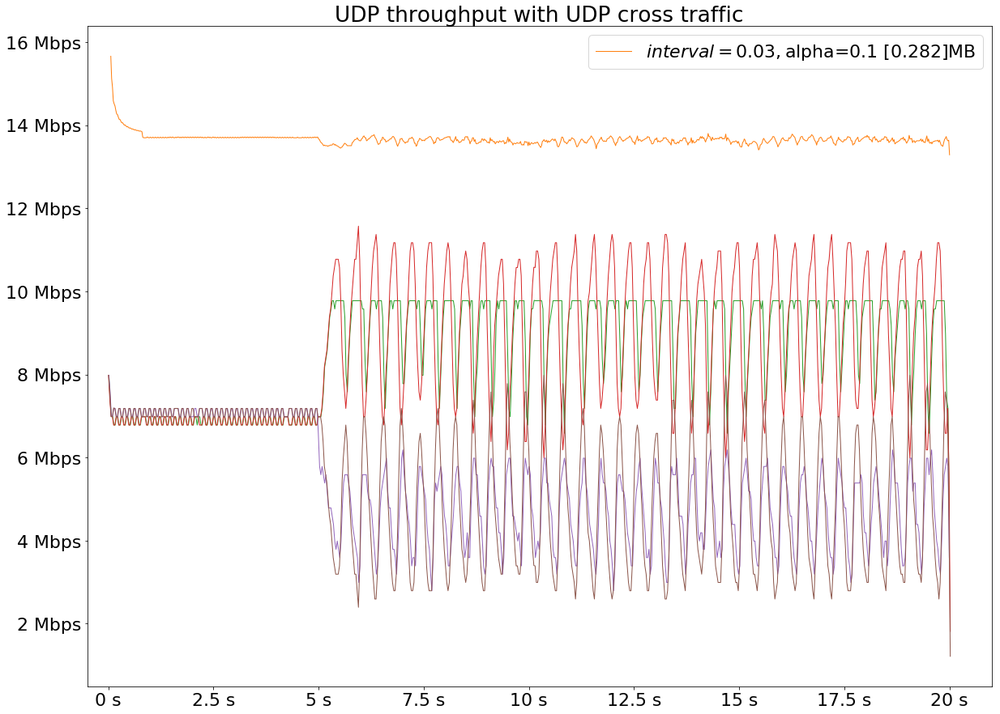

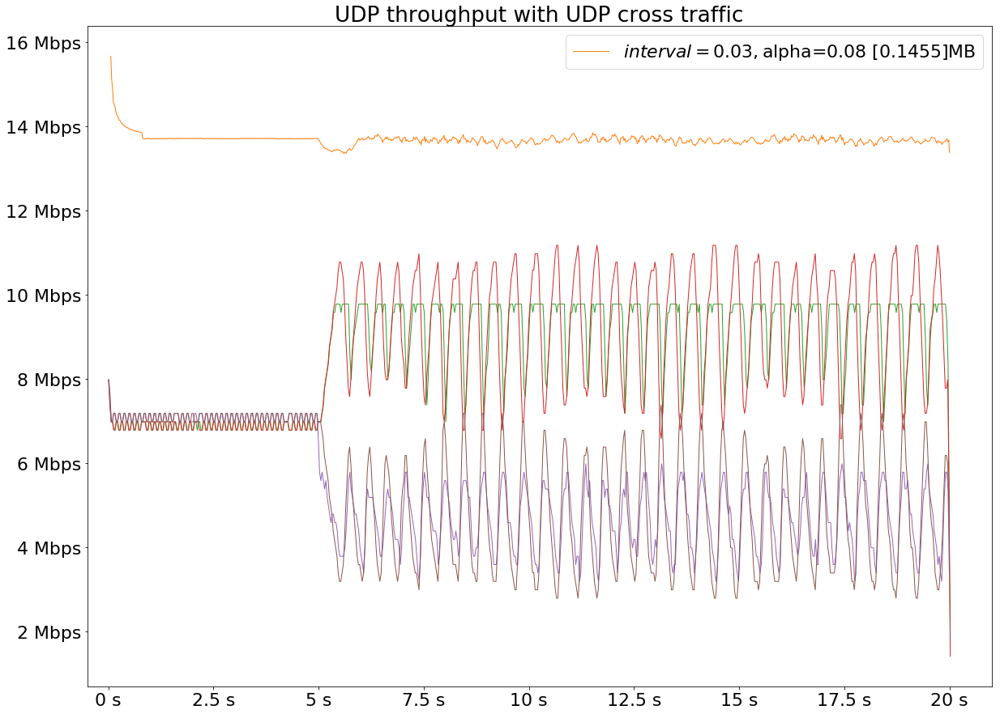

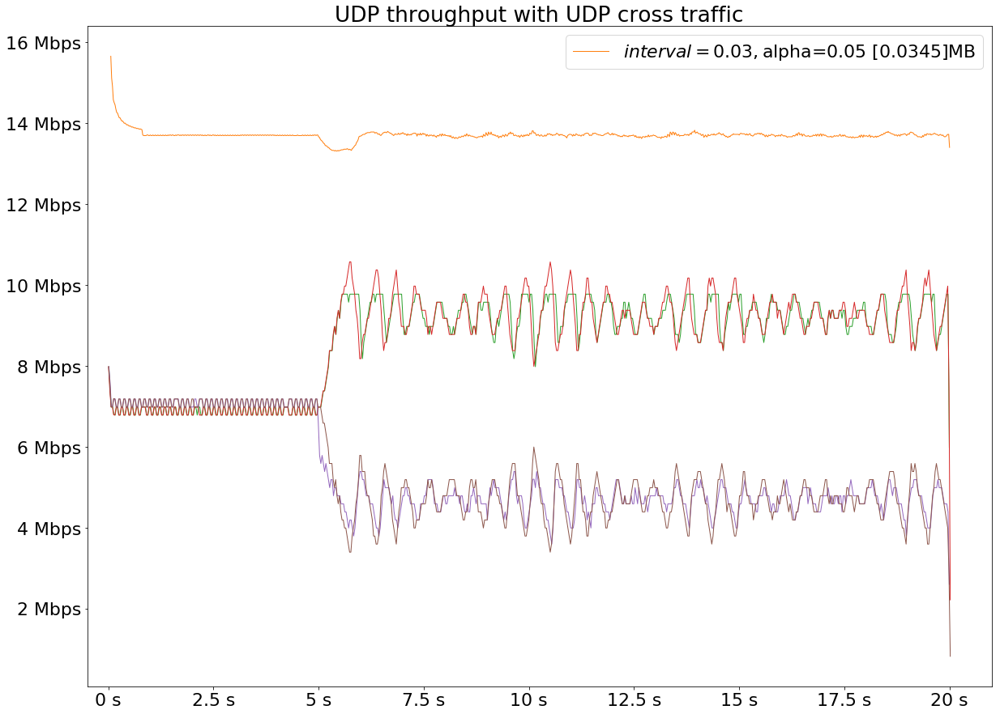

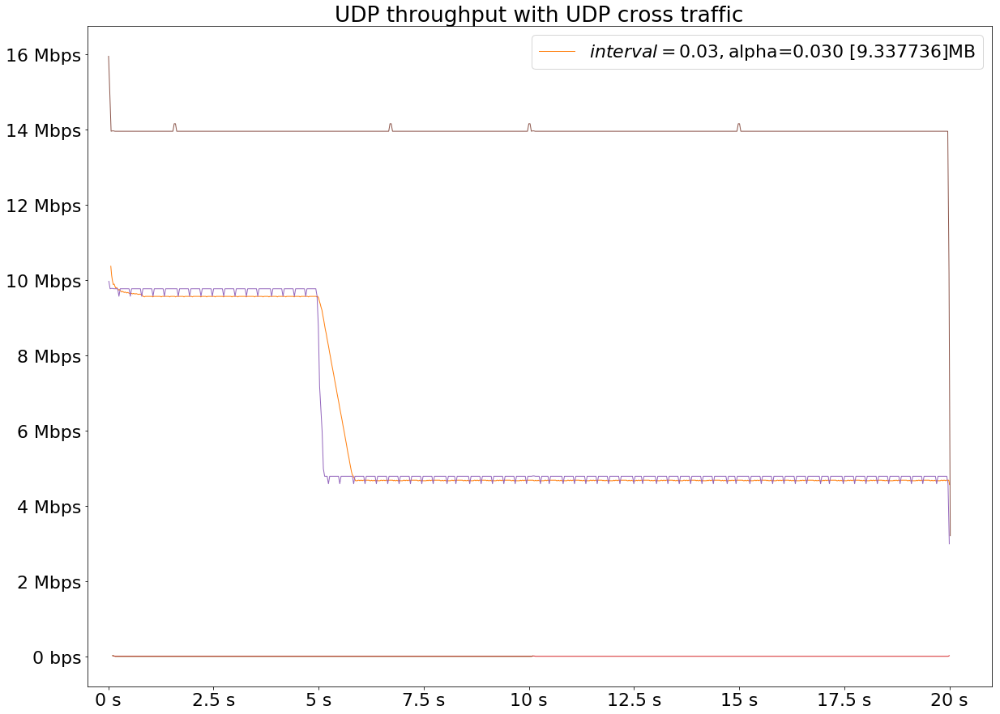

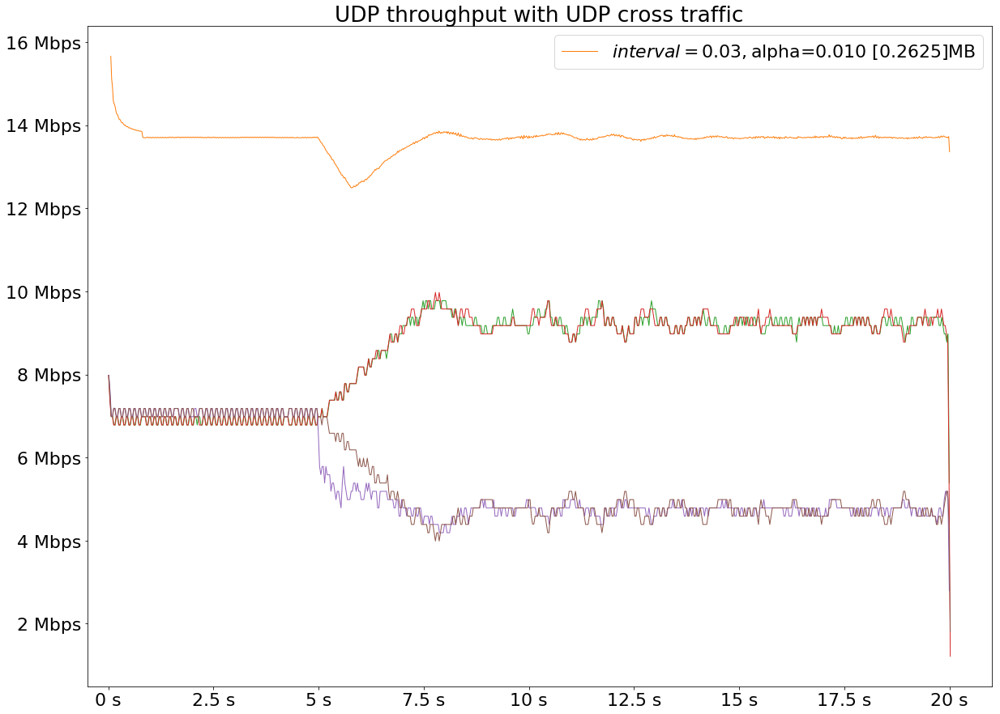

...

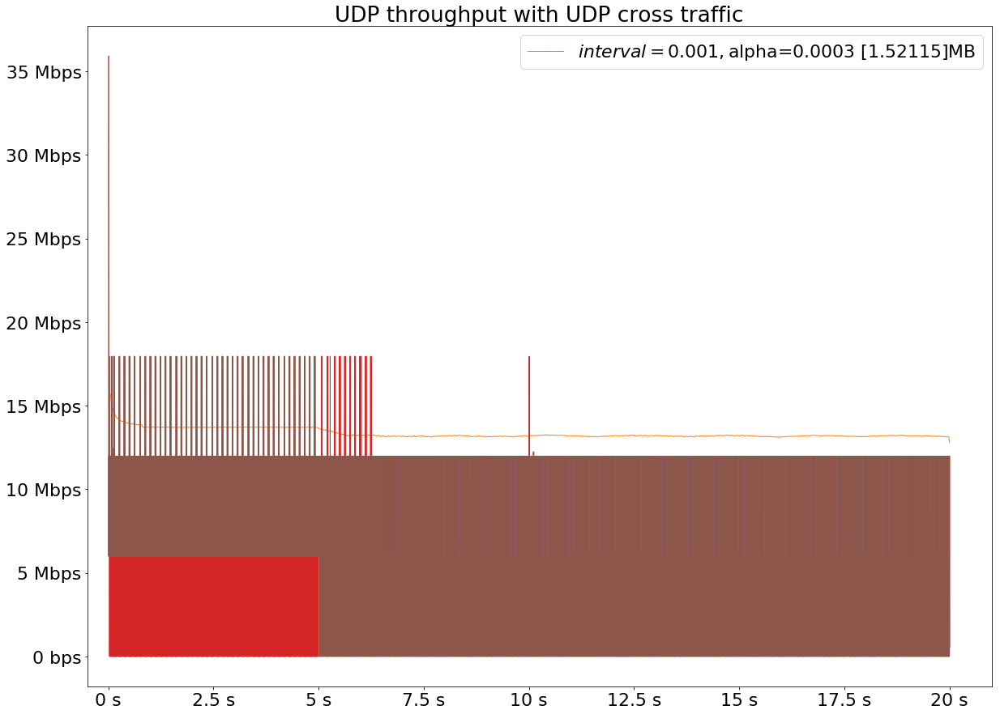

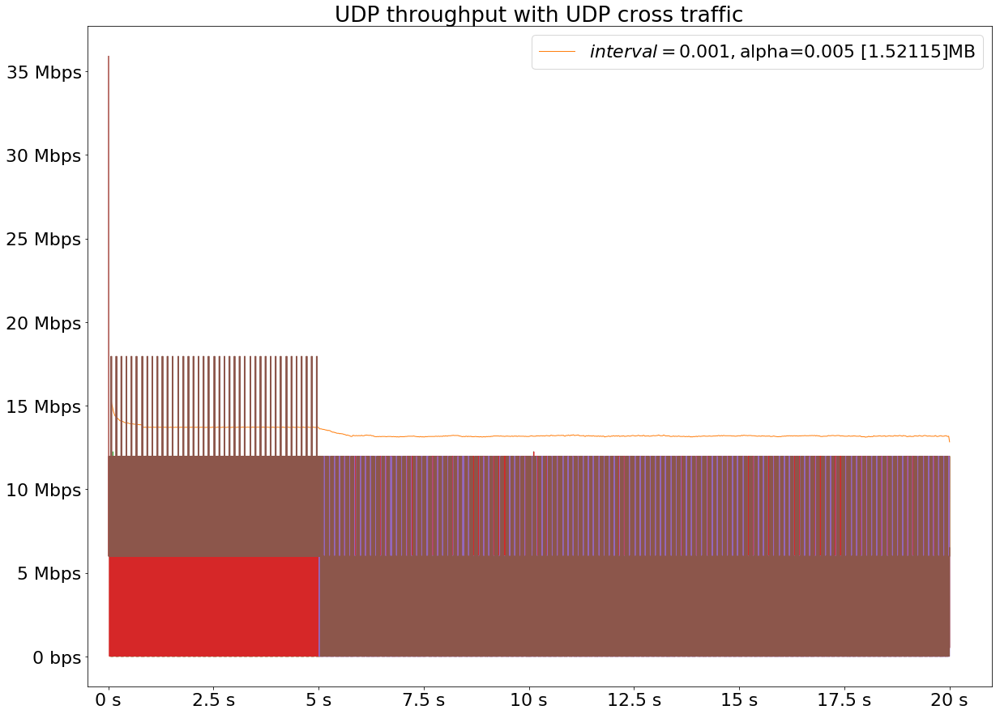

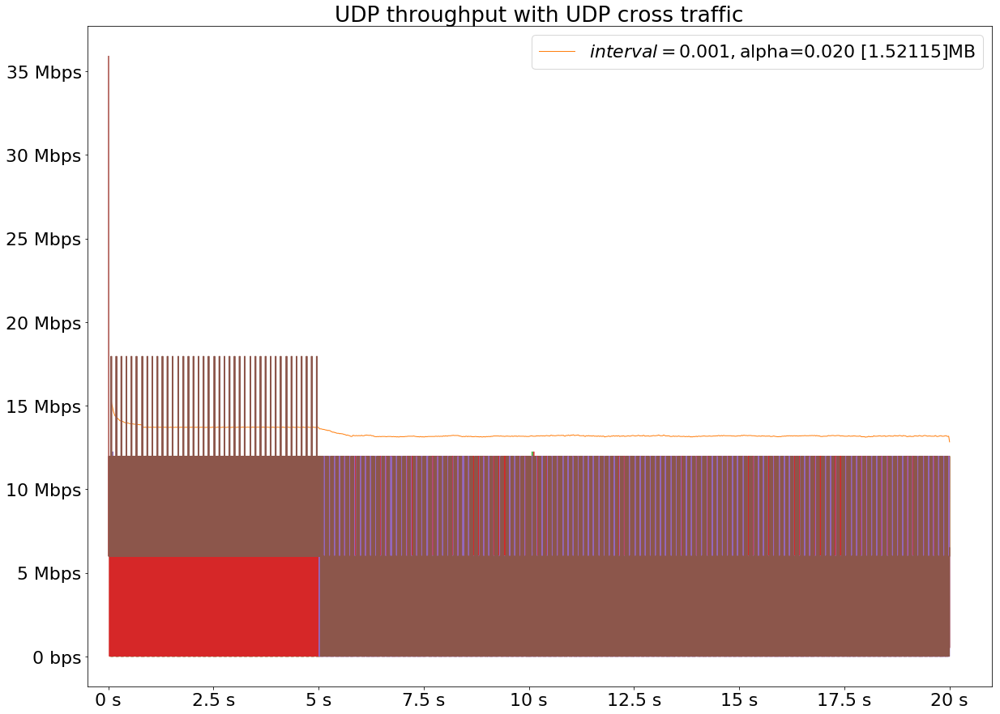

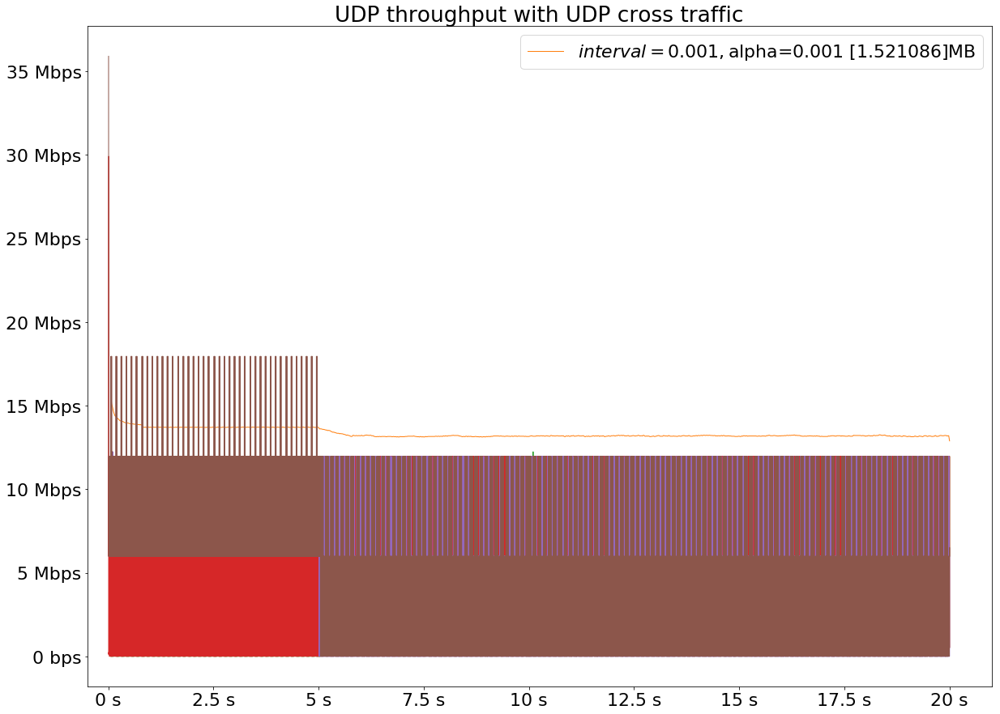

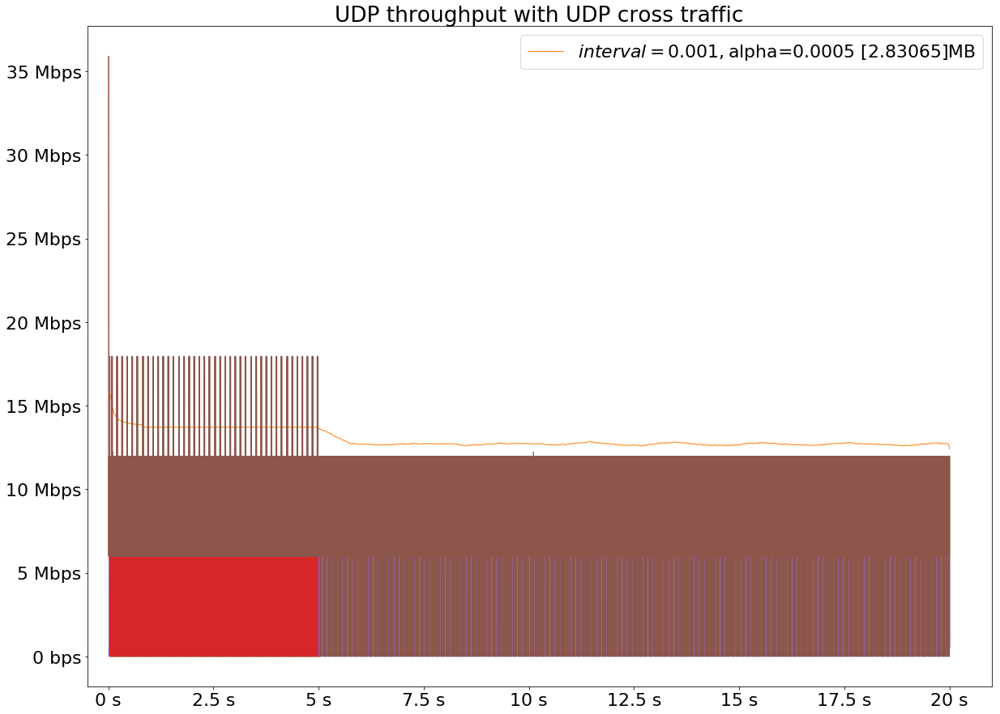

In [16]:
# Trying to plot throughput until first drop, plot the first drop time (at least as a tick on X-axis)

final_version = False
save_figure = False
alphas= {0.1, 0.08, 0.05, 0.030, 0.020, 0.010, 0.005, 0.001, 0.0005, 0.0003}
intervals = {0.001, 0.005, 0.010, 0.020, 0.030, 0.040, 0.050, 0.060, 0.070, 0.080, 0.090, 0.1}
for interval in intervals:
    for alpha in alphas:
        figureName="fig/single_conn/Hex_UdpEcnFwdFThrough_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"
        backupFigureName="fig/single_conn/Backup_UdpEcnFwdFThrough_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"
        
        plt.rcParams["figure.figsize"] =(20,15)
        plt.rcParams.update({'font.size': 22})
        formatter_x = EngFormatter(unit='s')
        formatter_y = EngFormatter(unit='bps')

        # max_min = vectors_arranged.drop_min_vectime.max()
        max_min = 0
        fig, ax = plt.subplots()
        ax.xaxis.set_major_formatter(formatter_x)
        # ax.set_yscale('log')
        ax.yaxis.set_major_formatter(formatter_y)
        if(not final_version):
            ax.set_title("UDP throughput with UDP cross traffic")
        legend = list()
        # print(vectors_arranged[(vectors_arranged.queueCap > 1) &  (vectors_arranged.cross == "\"On\"")].columns)
        for row in vectors_toPlot[ (vectors_toPlot.alpha == alpha)  & (vectors_toPlot.interval == interval)].itertuples():
#             print(row._fields)

        #     appThrough = row._5 # Hexagon.client499.app[0].rcvdPk:vector(packetBytes)
            appThrough = row.Hexagon_client499_app_0__rcvdPk_vector_packetBytes_
        #     bottom = row._14   
            bottom = row.Hexagon_routerCore4_eth_1__encap_decapPk_vector_packetBytes_
            bottomRC1 = row.Hexagon_routerCore1_eth_1__encap_encapPk_vector_packetBytes_ #bottom RouterCore1

        #     top = row._15
            top = row.Hexagon_routerCore4_eth_2__encap_decapPk_vector_packetBytes_
            topRC1 = row.Hexagon_routerCore1_eth_2__encap_encapPk_vector_packetBytes_ #top RouterCore1
            
        
            dropSum = 0
            if("Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_.sum()

            if("Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_.sum()

            if("Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_.sum()
            
            if("Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_.sum()
                
            
            itervar = row.iterationvars
        


        #     hasDmpr = row.hasDmpr
            hasDmpr = True
            
            dropSum = dropSum/1000000  #in MB

        #     max_min = max(max_min, drop_min_vectime)
            if(final_version):
                if(hasDmpr):
                    legend.append("With mechanism")
                else:
                    legend.append("Without mechanism")
            else: 
                legend.append(itervar + " " + str(dropSum.real) + str("MB"))
        #         legend.append(itervar + str(" top"))
        #         legend.append(itervar + str(" bottom"))

            color = next(ax._get_lines.prop_cycler)['color']

            appThroughResampled = appThrough.resample(str(interval*1000) + 'ms',label='right').sum()*8*(1000/(interval*1000))
            appThroughRolling = appThroughResampled.rolling( window=2, min_periods=1).mean()

            plt.plot(appThroughRolling.index.total_seconds() - 20, appThroughRolling.values,  linewidth=1, )



            topResampled = top.resample(str(interval*1000) + 'ms',label='right').sum()*8*(1000/(interval*1000))
            topRolling = topResampled.rolling( window=2, min_periods=1).mean()

            plt.plot(topRolling.index.total_seconds() - 20, topRolling.values,  linewidth=1, ) #color=color ,label='_nolegend_'
            
            topRC1Resampled = topRC1.resample(str(interval*1000) + 'ms',label='right').sum()*8*(1000/(interval*1000))
            topRC1Rolling = topRC1Resampled.rolling( window=2, min_periods=1).mean()
            
            plt.plot(topRC1Rolling.index.total_seconds() - 20, topRC1Rolling.values,  linewidth=1, ) #color=color ,label='_nolegend_'
            
            bottomResampled = bottom.resample(str(interval*1000) + 'ms',label='right').sum()*8*(1000/(interval*1000))
            bottomRolling = bottomResampled.rolling( window=2, min_periods=1).mean()

            plt.plot(bottomRolling.index.total_seconds() - 20, bottomRolling.values,  linewidth=1,)
            
            bottomRC1Resampled = bottomRC1.resample(str(interval*1000) + 'ms',label='right').sum()*8*(1000/(interval*1000))
            bottomRC1Rolling = bottomRC1Resampled.rolling( window=2, min_periods=1).mean()

            plt.plot(bottomRC1Rolling.index.total_seconds() - 20, bottomRC1Rolling.values,  linewidth=1,)


                #max line
        #     print(appThroughRolling.fillna(0).values.max())
        #     print(np.max(appThroughRolling.values))
        #     plt.axhline(appThroughRolling.fillna(0).values.max(), linestyle='dashed', linewidth=1.7, color=color, label='_nolegend_')
        #     legend.append(itervar + "; max=" + formatter_y(appThroughRolling.fillna(0).values.max()))

        #     print_series = pd.Series(appThroughputValue, index = pd.to_timedelta(appThroughputIndex,  unit='s'))
        # #     print_series = trimTimeDeltaSeries(print_series, after=pd.to_timedelta(drop_min_vectime, unit='s'))
        #     result = print_series.resample('10ms',label='right').sum()*8*100
        #     resultPlot = result.rolling( window=40, min_periods=3).mean()

        # #     resultPlot = print_series.cumsum()
        # #     resultPlot = trimTimeDeltaSeries(resultPlot, after=pd.to_timedelta(drop_min_vectime, unit='s'))


        #     #get closest index from resultPlot
        # #     idx = resultPlot.index.get_loc(pd.to_timedelta(drop_min_vectime, unit='s'), 'nearest')

        # #     meanLine = result.rolling(window=result.size, min_periods=10).mean()
        #     start = print_series.index.min()
        #     end = print_series.index.max()
        #     avg_speed = 100*8*1000*1000/(end.total_seconds()-20.0)

        #     print(meanLine)

        #     plt.plot(resultPlot.index.total_seconds() - 20, resultPlot.values,  linewidth=1,) #

        #     plt.plot(meanLine.index.total_seconds(), meanLine.values, color='red')
        #     plt.plot(resultPlot.index.total_seconds(), np.ndarray((resultPlot.size), dtype=meanPoint))
        #     dropArray = np.concatenate((row[7], row[8], row[9], row[10]))



        #     ax.scatter(dropArray, np.ones(shape=(dropArray.size, )))
        #     ax.scatter(dropArray, resultPlot[resultPlot.index.get_loc(key=dropArray,method="nearest")], color="green")
            # vertical dotted line originating at mean value


        #     #average line
        #     meanPoint = resultPlot.mean()
        #     meanPoint_text = formatter_y(avg_speed)
        #     legend.append(itervar + "; avg=" + meanPoint_text)
        #     plt.axhline(meanPoint, linestyle='dashed', linewidth=0.7)

        # #     print(row.iterationvars)

        #     fig.savefig("fig/single_conn/Full_SingleConn_"+row[12] + ".png", bbox_inches='tight') 



        plt.xlim(left= -0.5,right= 21)
        ax.legend(legend)
        plt.show()
        if(save_figure):
            if(final_version):
                fig.savefig(figureName, bbox_inches='tight') 
            else:
                ax.legend(legend)
                fig.savefig(backupFigureName, bbox_inches='tight')

In [ ]:
vectors_toPlot

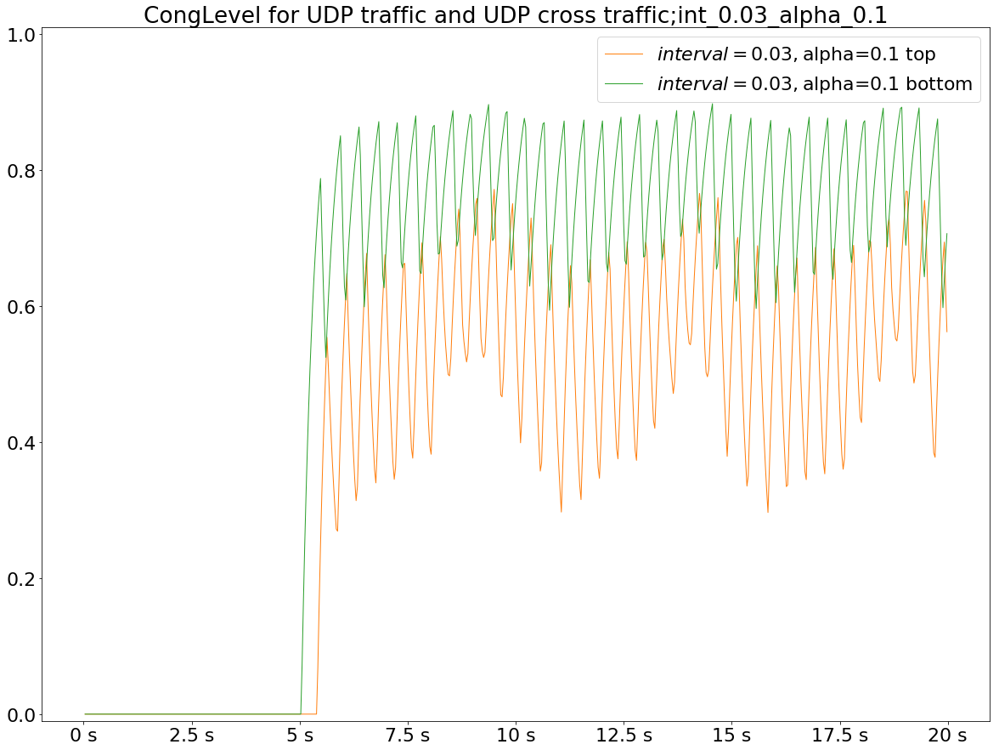

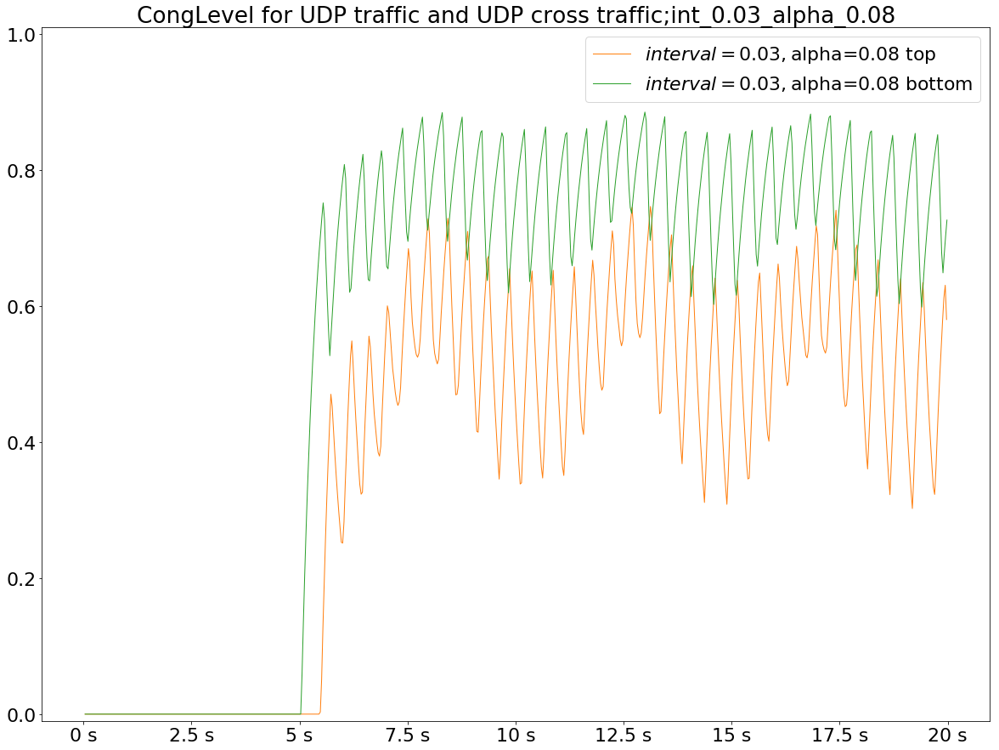

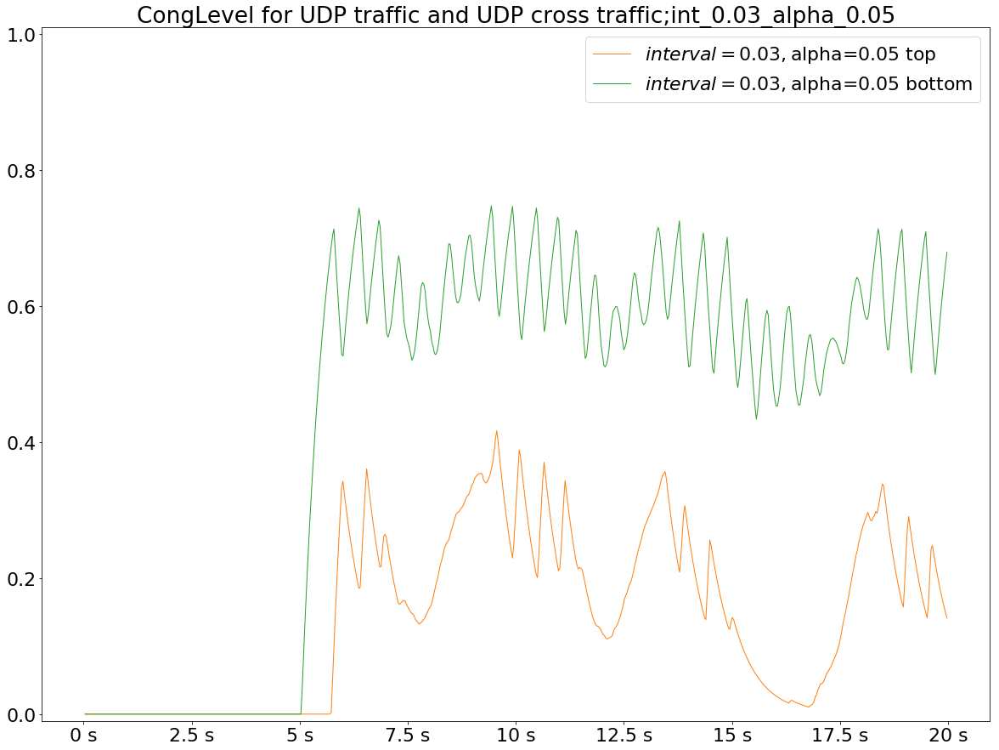

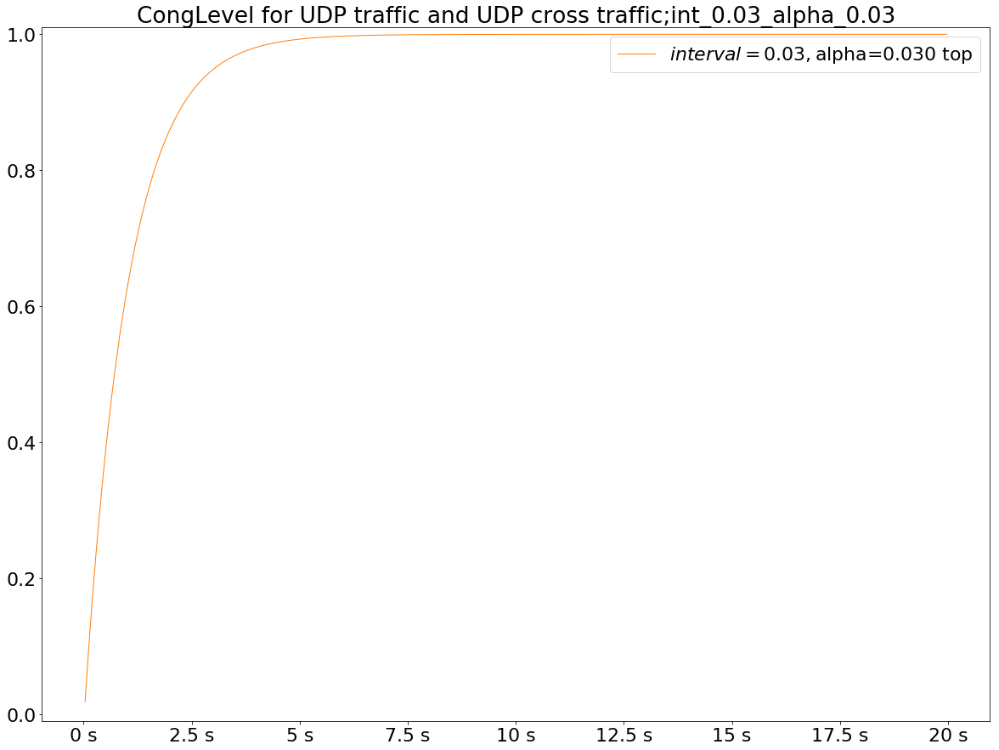

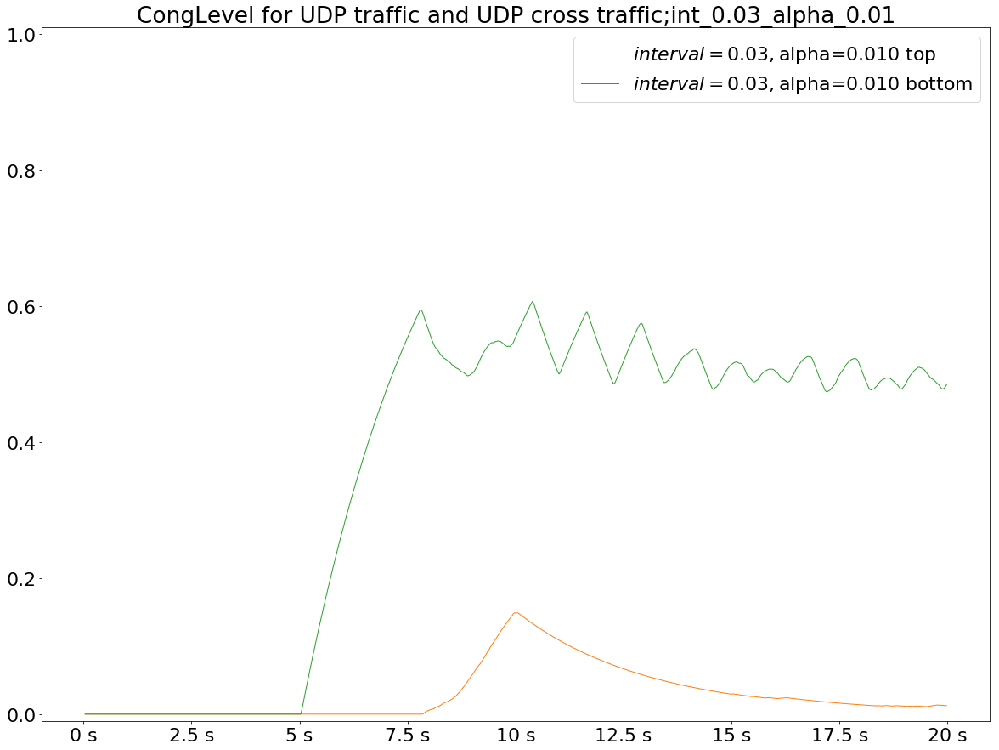

...

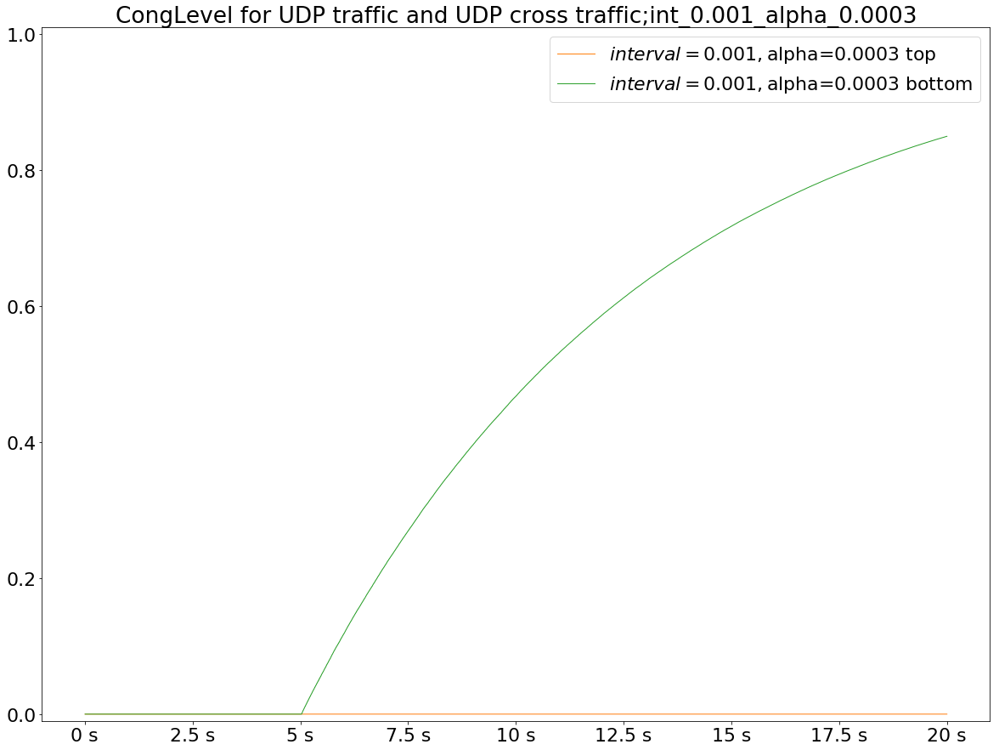

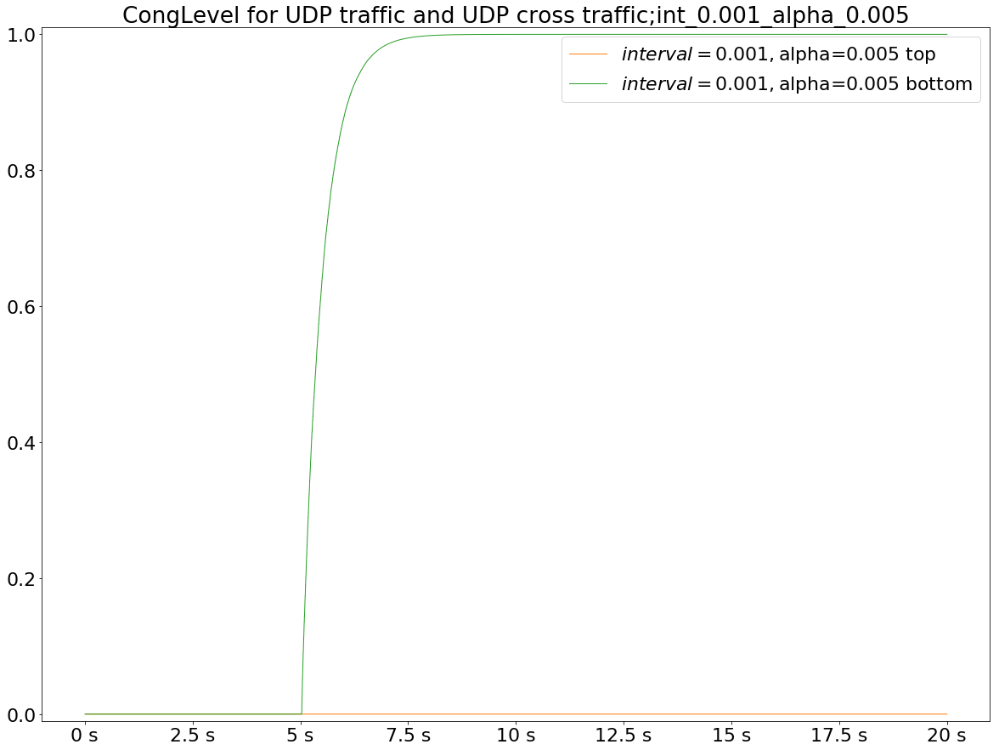

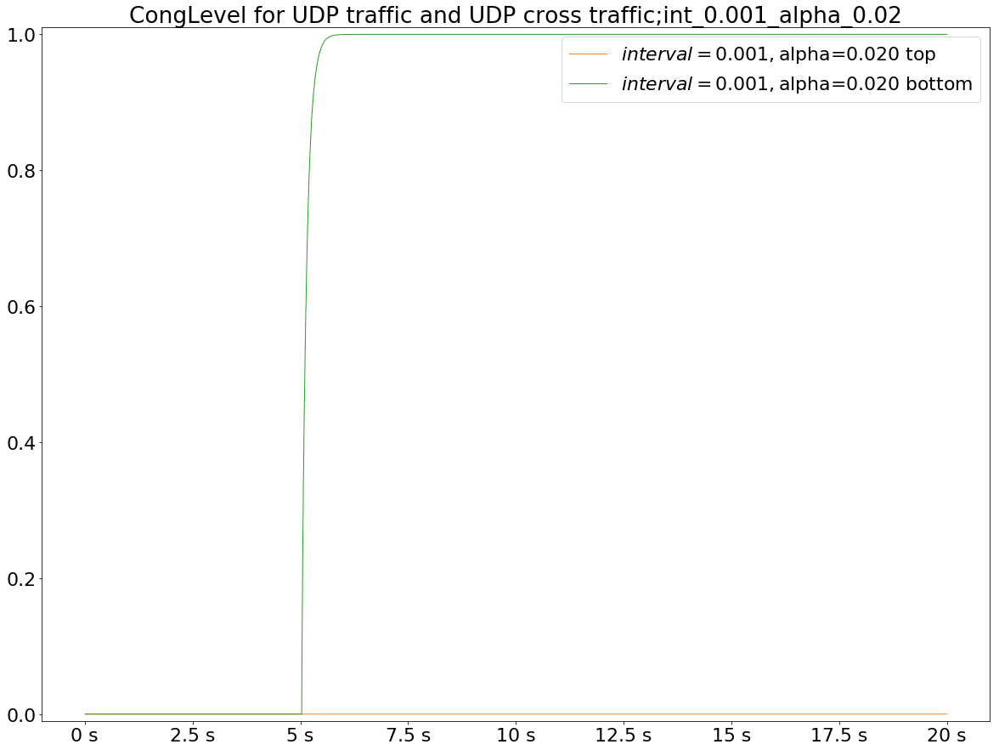

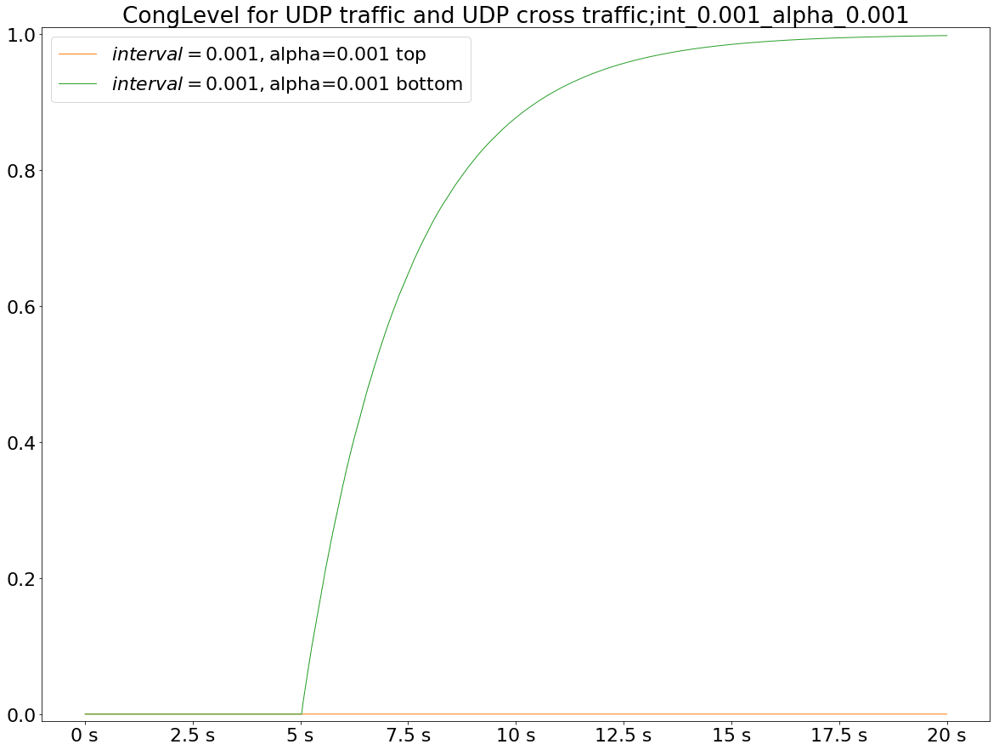

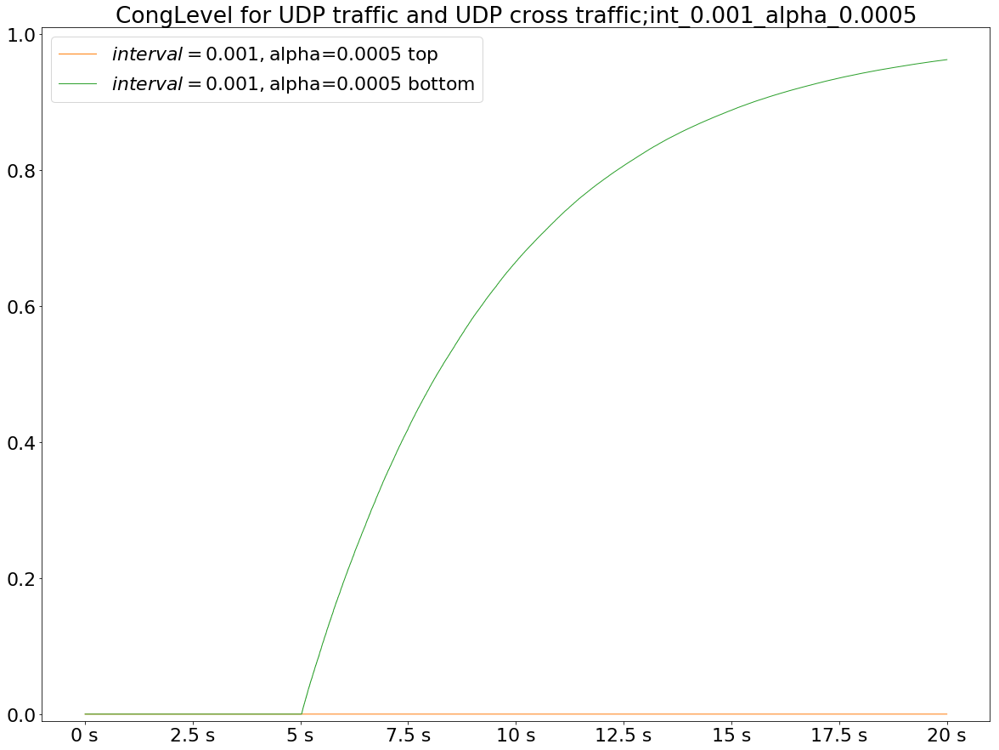

In [9]:
# CongLevel

final_version = False
save_figure = False
alphas= {0.1, 0.08, 0.05, 0.030, 0.020, 0.010, 0.005, 0.001, 0.0005, 0.0003}
intervals = {0.001, 0.005, 0.010, 0.020, 0.030, 0.040, 0.050, 0.060, 0.070, 0.080, 0.090, 0.1}
for interval in intervals:
    for alpha in alphas:
        figureName="fig/single_conn/Hex_UdpEcnFwdFCongLev_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"
        backupFigureName="fig/single_conn/Backup_UdpEcnFwdFCongLev_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"

        plt.rcParams["figure.figsize"] =(20,15)
        plt.rcParams.update({'font.size': 22})
        formatter_x = EngFormatter(unit='s')
        # formatter_y = EngFormatter(unit='bps')

        # max_min = vectors_arranged.drop_min_vectime.max()
        max_min = 0
        fig, ax = plt.subplots()
        ax.xaxis.set_major_formatter(formatter_x)
        # ax.set_yscale('log')
        # ax.yaxis.set_major_formatter(formatter_y)
        if(not final_version):
            ax.set_title("CongLevel for UDP traffic and UDP cross traffic;int_"+ str(interval) + "_alpha_"+ str(alpha))
        legend = list()
        # print(vectors_arranged[(vectors_arranged.queueCap > 1) &  (vectors_arranged.cross == "\"On\"")].columns)
        for row in vectors_toPlot[(vectors_toPlot.alpha == alpha)  & (vectors_toPlot.interval == interval)].itertuples():
        #     print(row)

        #     appThrough = row._5 # Hexagon.client499.app[0].rcvdPk:vector(packetBytes)
        #     appThrough = row.Hexagon_client499_app_0__rcvdPk_vector_packetBytes_
        #     bottom = row._14   
            bottom = row.Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_1__vector

        #     top = row._15
            top = row.Hexagon_routerCore1_dmpr_congLevel_192_168_4_0_eth_2__vector


            itervar = row.iterationvars

        #     hasDmpr = row.hasDmpr
            hasDmpr = True

        #     max_min = max(max_min, drop_min_vectime)
            if(final_version):
                if(hasDmpr):
                    legend.append("With mechanism")
                else:
                    legend.append("Without mechanism")
            else: 
        #         legend.append(itervar)
                legend.append(itervar + str(" top"))
                legend.append(itervar + str(" bottom"))

            color = next(ax._get_lines.prop_cycler)['color']

        #     appThroughResampled = appThrough.resample('20ms',label='right').sum()*8*50
        #     appThroughRolling = appThroughResampled.rolling( window=40, min_periods=3).mean()

        #     plt.plot(appThroughRolling.index.total_seconds() - 20, appThroughRolling.values,  linewidth=1, color=color)



        #     topResampled = top.resample('20ms',label='right').sum()*8*50
        #     topRolling = topResampled.rolling( window=40, min_periods=3).mean()
            if(not isnan(top)):
                plt.plot(top.index.total_seconds() - 20, top.values,  linewidth=1, )

        #     bottomResampled = bottom.resample('20ms',label='right').sum()*8*50
        #     bottomRolling = bottomResampled.rolling( window=40, min_periods=3).mean()

            if(not isnan( bottom)):
                plt.plot(bottom.index.total_seconds() - 20, bottom.values,  linewidth=1,)


                #max line
        #     print(appThroughRolling.fillna(0).values.max())
        #     print(np.max(appThroughRolling.values))
        #     plt.axhline(appThroughRolling.fillna(0).values.max(), linestyle='dashed', linewidth=1.7, color=color, label='_nolegend_')
        #     legend.append(itervar + "; max=" + formatter_y(appThroughRolling.fillna(0).values.max()))

        #     print_series = pd.Series(appThroughputValue, index = pd.to_timedelta(appThroughputIndex,  unit='s'))
        # #     print_series = trimTimeDeltaSeries(print_series, after=pd.to_timedelta(drop_min_vectime, unit='s'))
        #     result = print_series.resample('10ms',label='right').sum()*8*100
        #     resultPlot = result.rolling( window=40, min_periods=3).mean()

        # #     resultPlot = print_series.cumsum()
        # #     resultPlot = trimTimeDeltaSeries(resultPlot, after=pd.to_timedelta(drop_min_vectime, unit='s'))


        #     #get closest index from resultPlot
        # #     idx = resultPlot.index.get_loc(pd.to_timedelta(drop_min_vectime, unit='s'), 'nearest')

        # #     meanLine = result.rolling(window=result.size, min_periods=10).mean()
        #     start = print_series.index.min()
        #     end = print_series.index.max()
        #     avg_speed = 100*8*1000*1000/(end.total_seconds()-20.0)

        #     print(meanLine)

        #     plt.plot(resultPlot.index.total_seconds() - 20, resultPlot.values,  linewidth=1,) #

        #     plt.plot(meanLine.index.total_seconds(), meanLine.values, color='red')
        #     plt.plot(resultPlot.index.total_seconds(), np.ndarray((resultPlot.size), dtype=meanPoint))
        #     dropArray = np.concatenate((row[7], row[8], row[9], row[10]))



        #     ax.scatter(dropArray, np.ones(shape=(dropArray.size, )))
        #     ax.scatter(dropArray, resultPlot[resultPlot.index.get_loc(key=dropArray,method="nearest")], color="green")
            # vertical dotted line originating at mean value


        #     #average line
        #     meanPoint = resultPlot.mean()
        #     meanPoint_text = formatter_y(avg_speed)
        #     legend.append(itervar + "; avg=" + meanPoint_text)
        #     plt.axhline(meanPoint, linestyle='dashed', linewidth=0.7)

        # #     print(row.iterationvars)

        #     fig.savefig("fig/single_conn/Full_SingleConn_"+row[12] + ".png", bbox_inches='tight') 



        plt.xlim(left= -0.5,right= 21)
        plt.ylim(bottom=-0.01, top=1.01)
        ax.legend(legend)
        plt.show()
        if(save_figure):
            if(final_version):
                fig.savefig(figureName, bbox_inches='tight') 
            else:
                ax.legend(legend)
                fig.savefig(backupFigureName, bbox_inches='tight')

[29.]


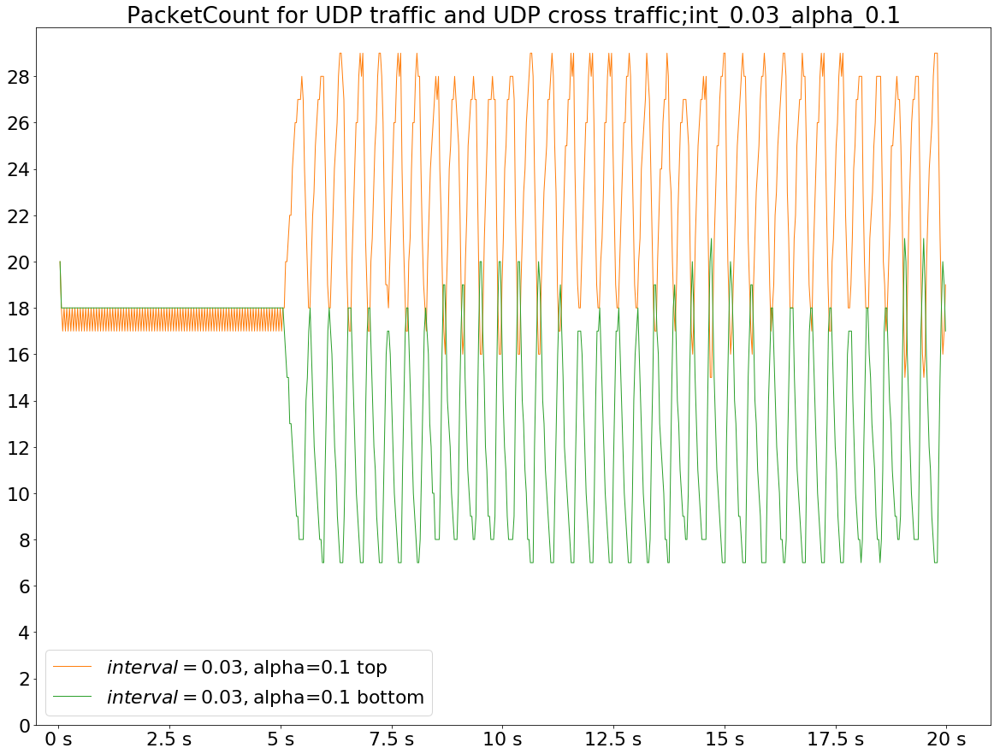

[29.]


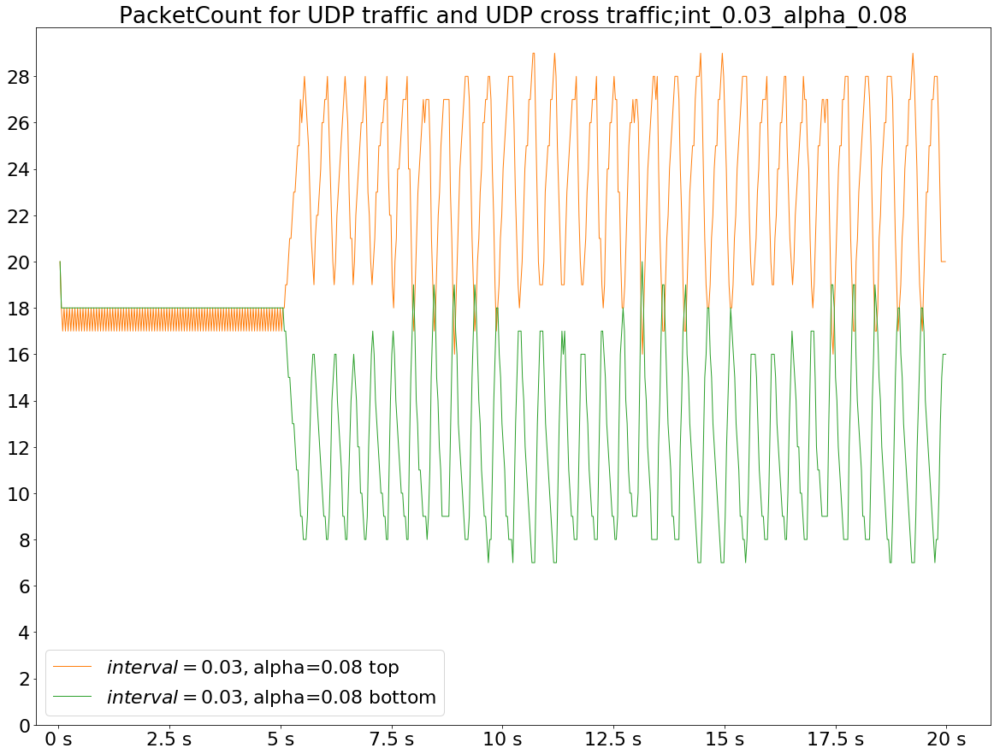

[27.]


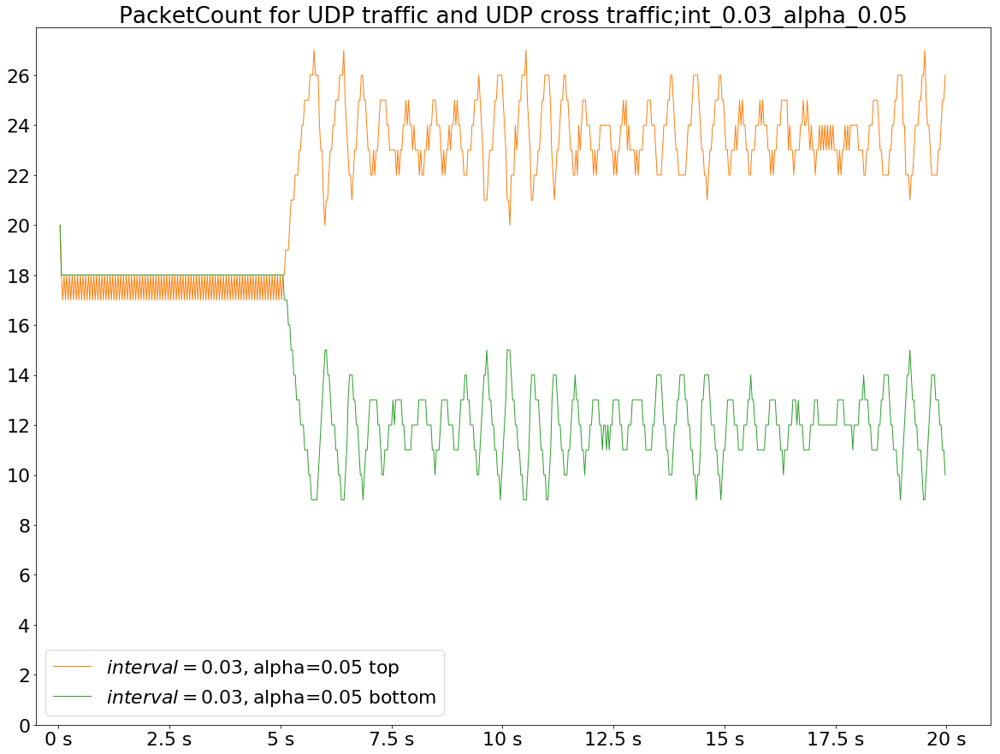

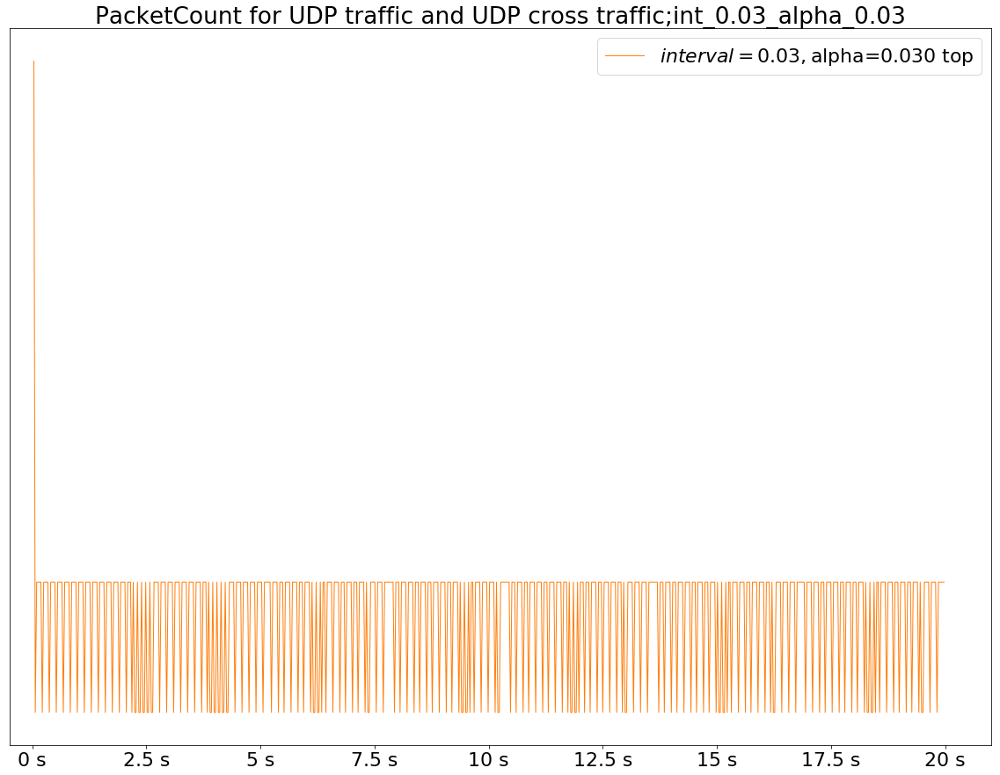

[25.]


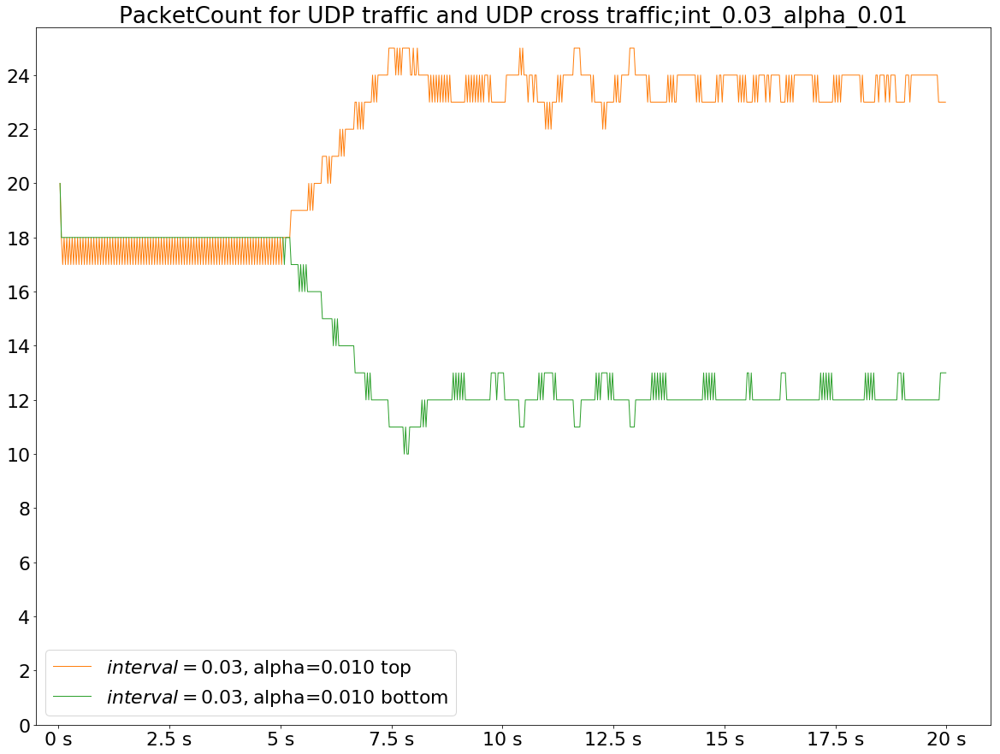

[20.]


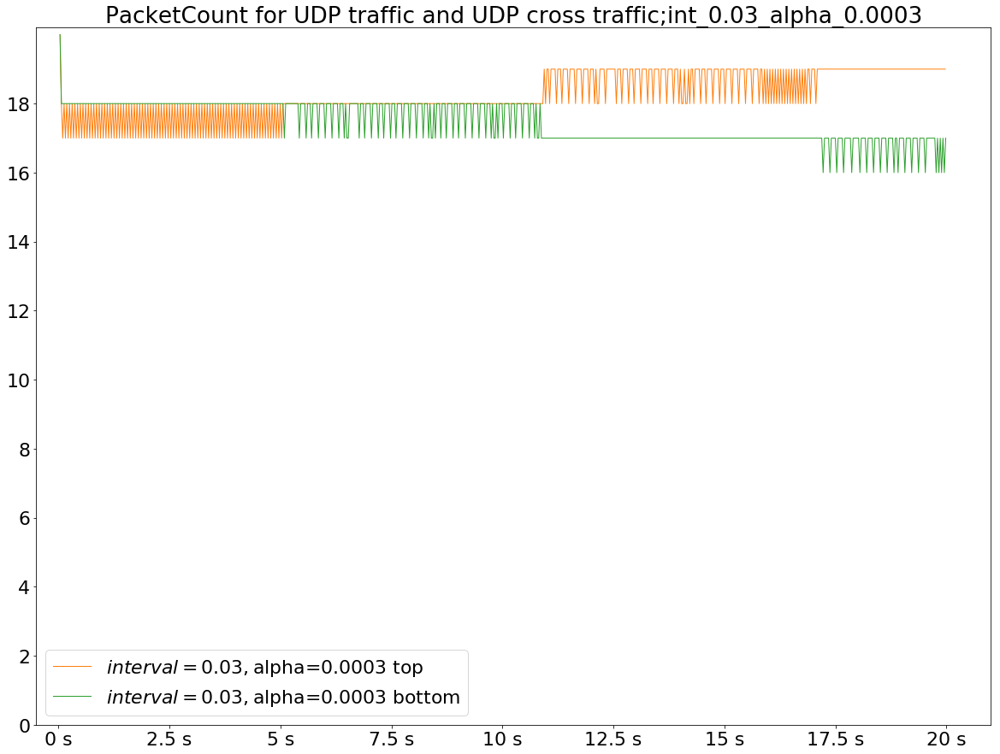

[25.]


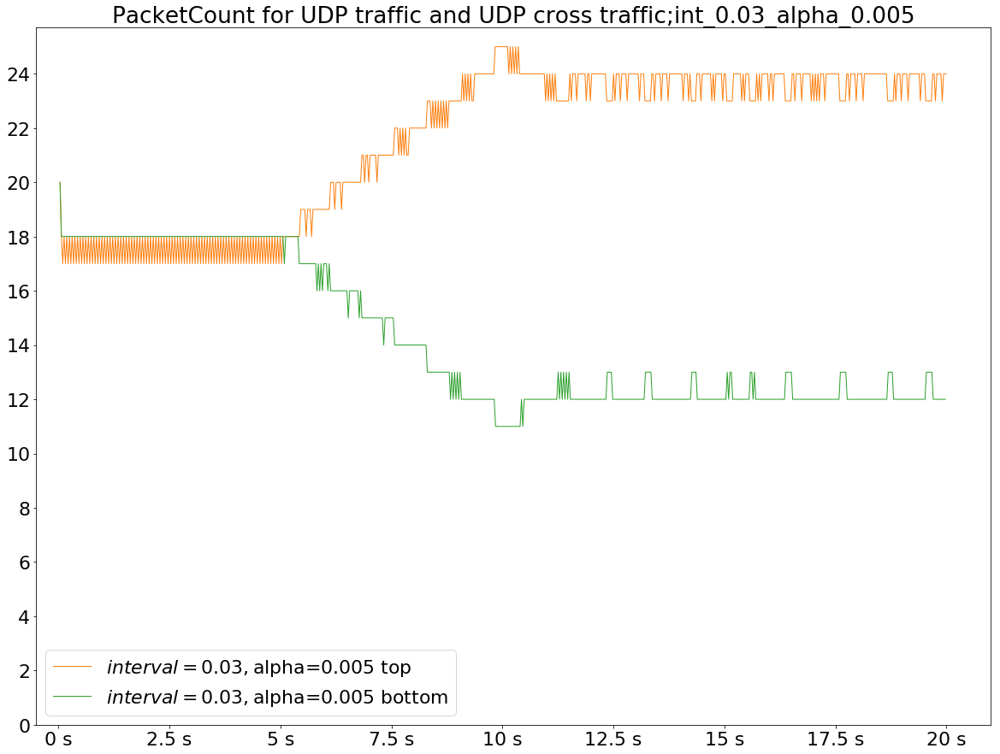

[26.]


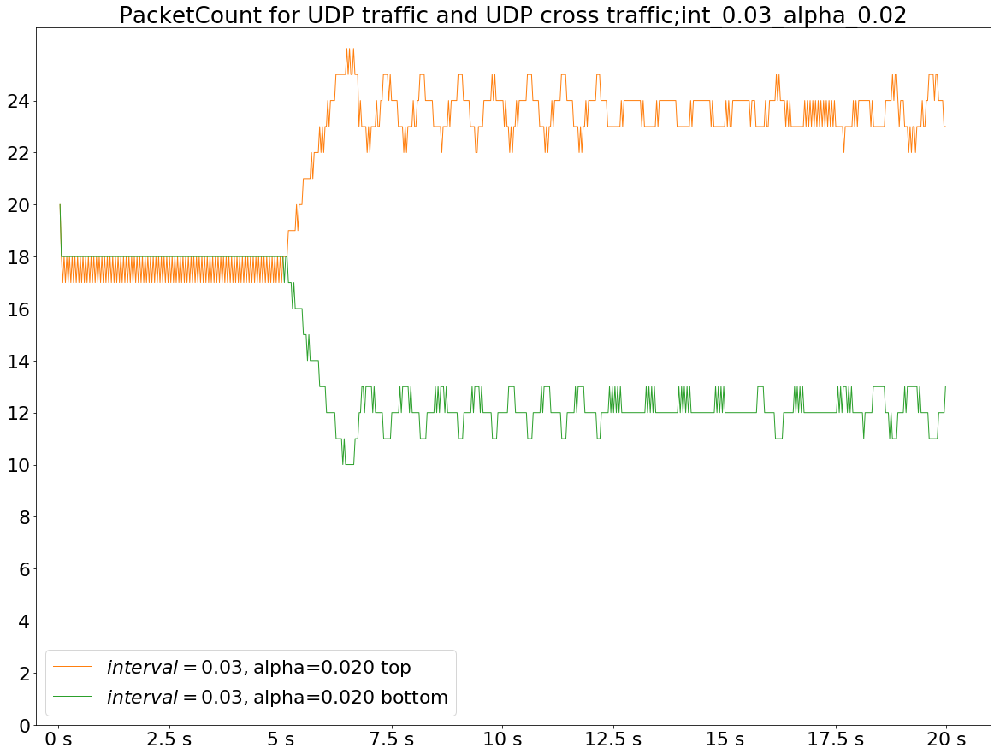

[22.]


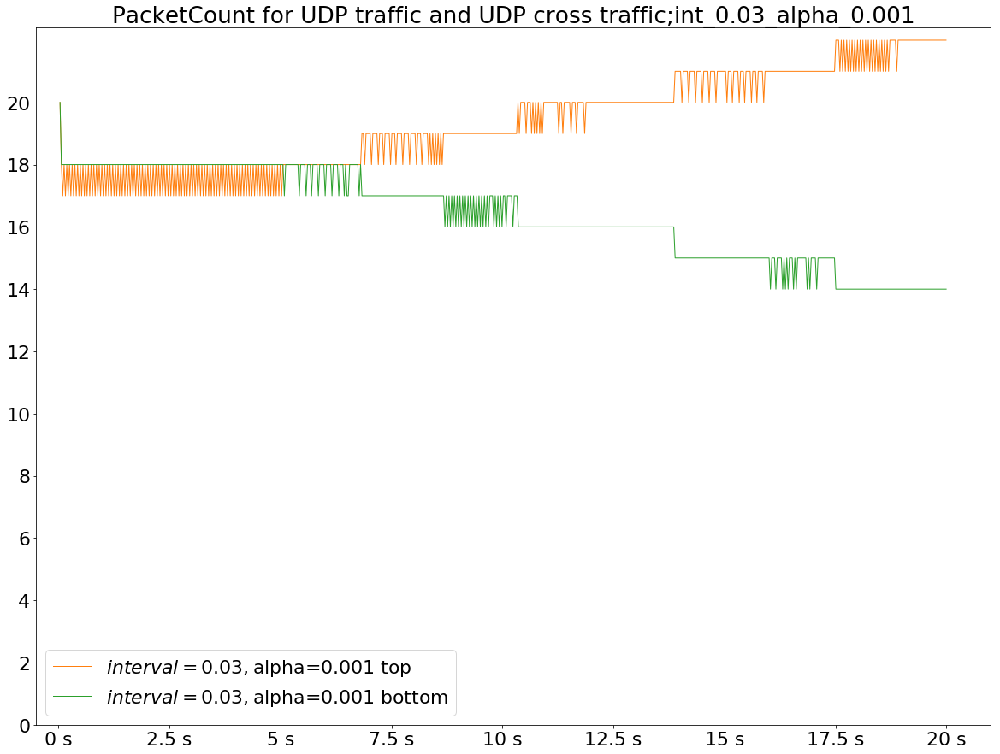

[20.]


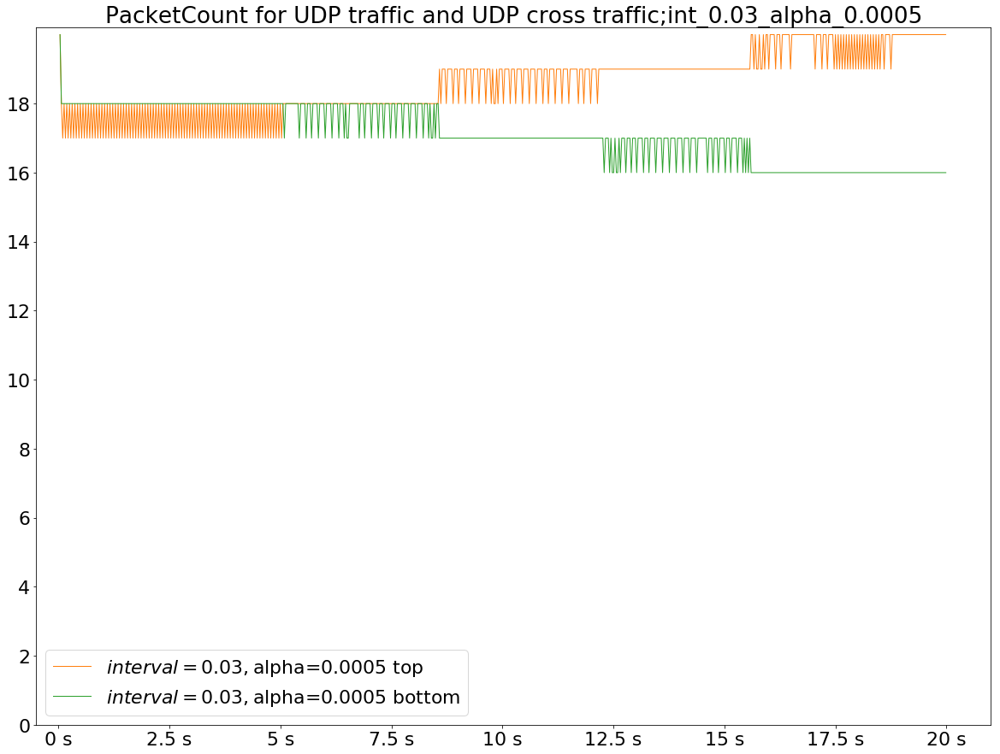

[47.]


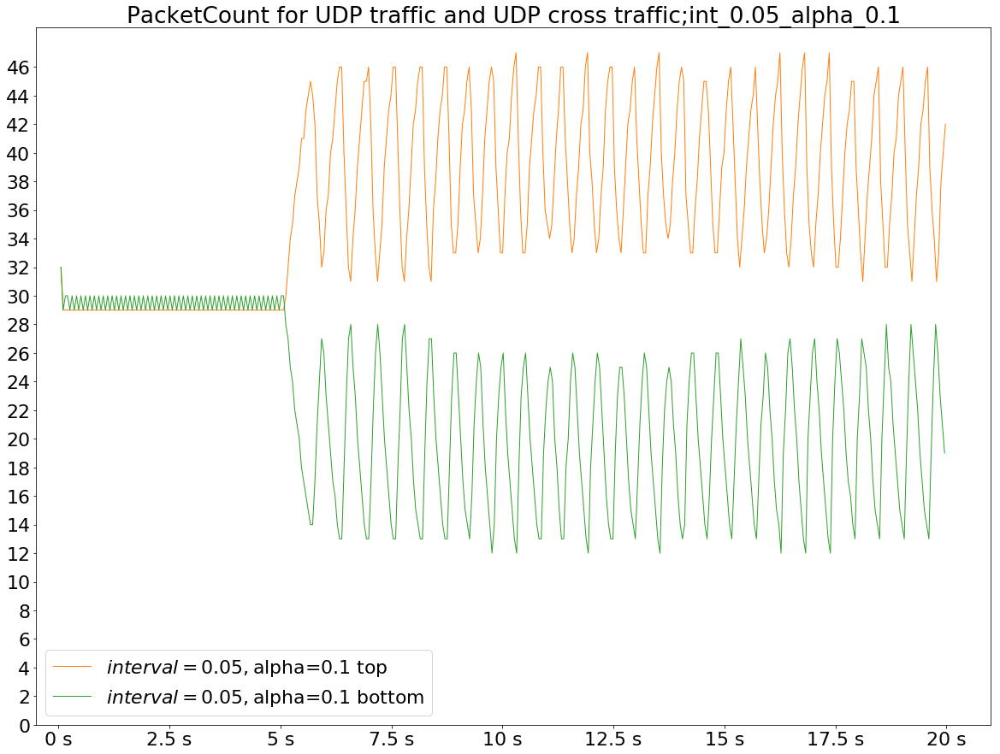

[45.]


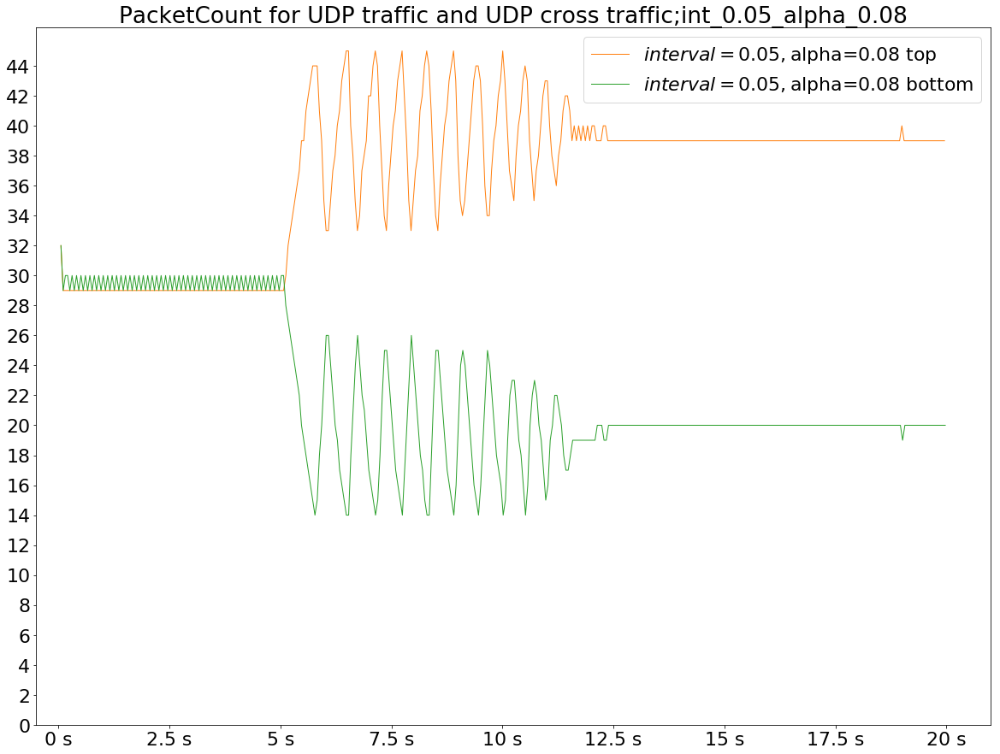

[44.]


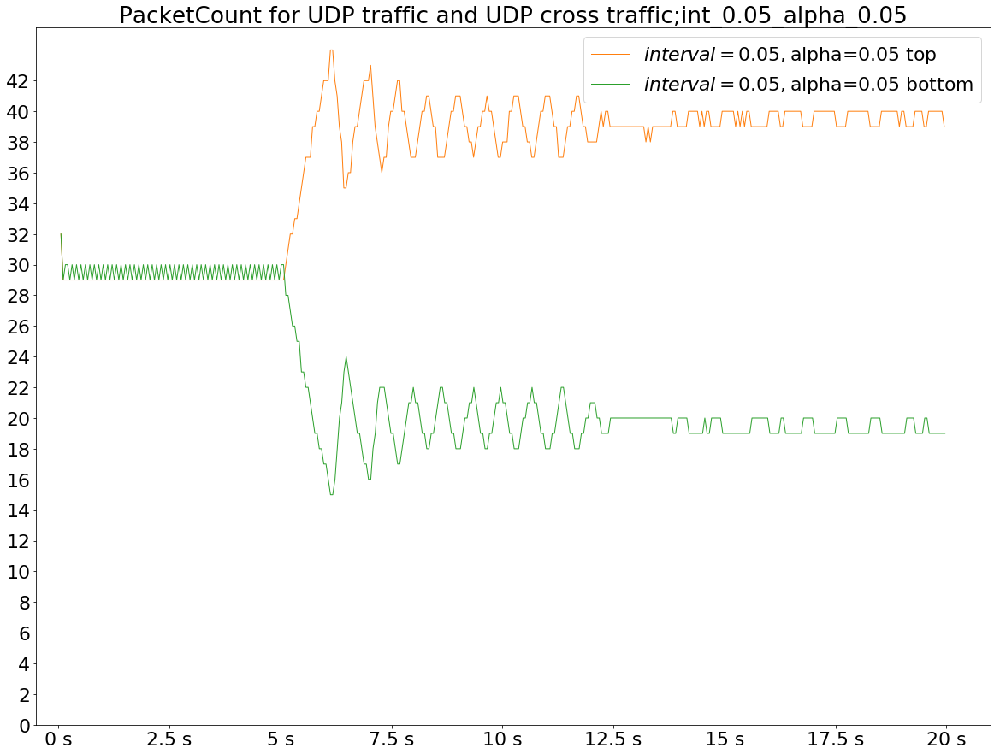

[43.]


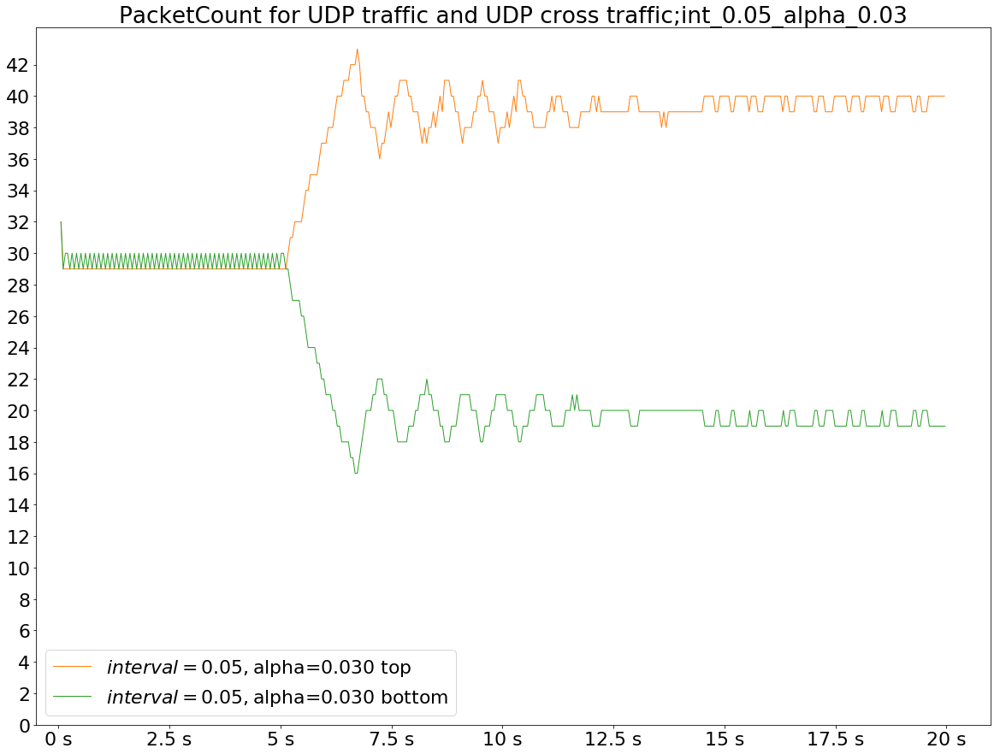

[41.]


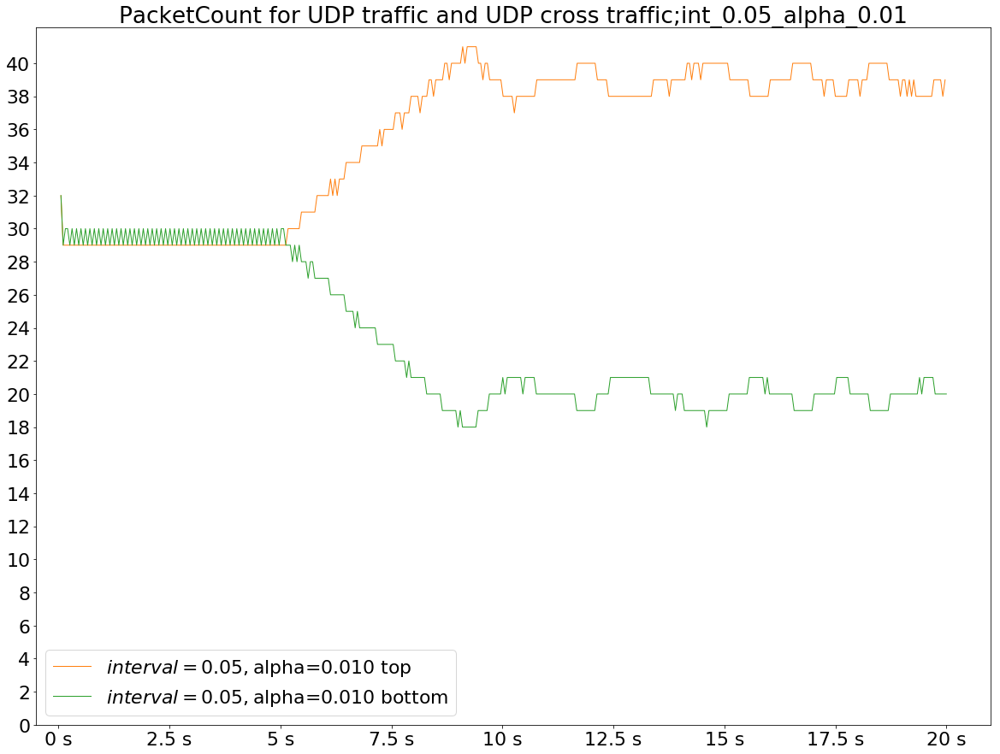

[32.]


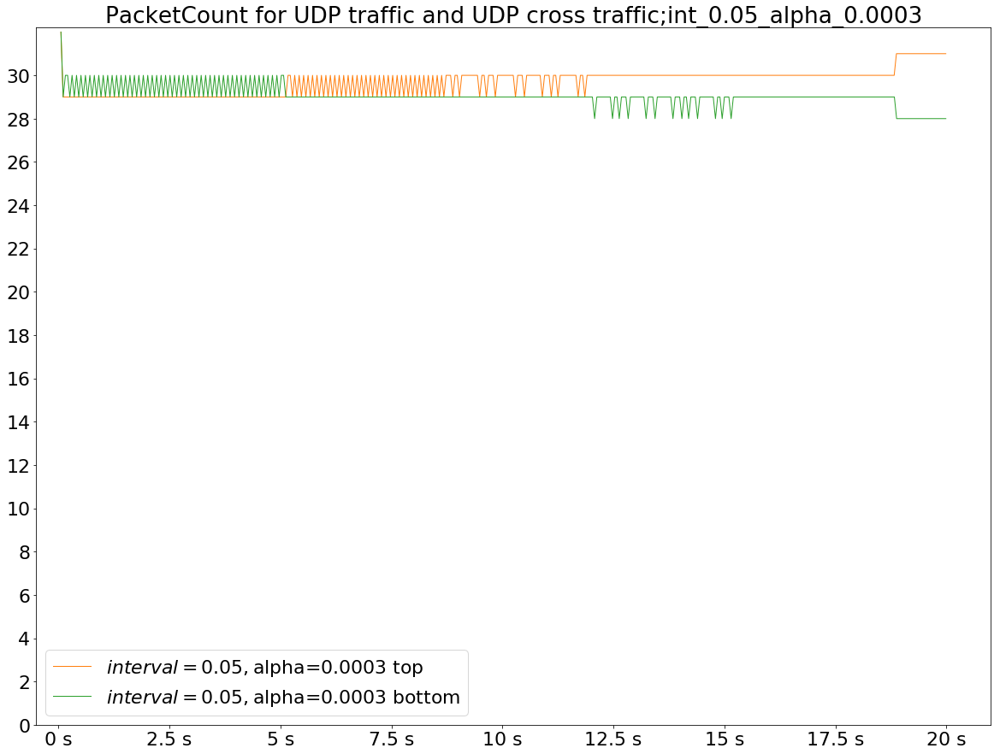

[40.]


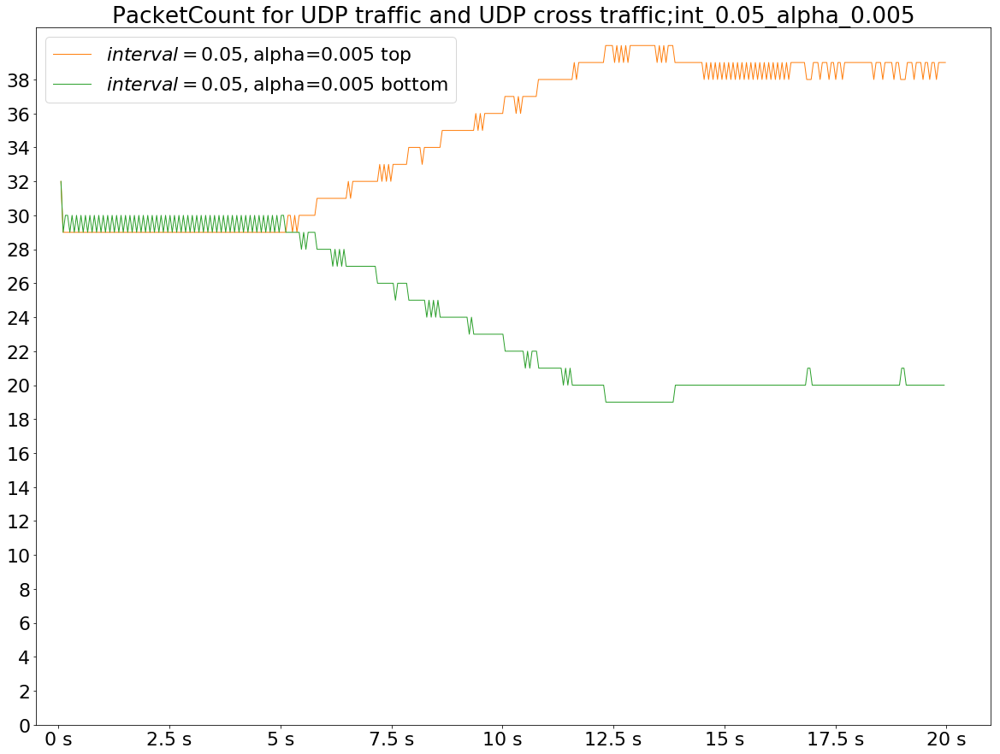

[42.]


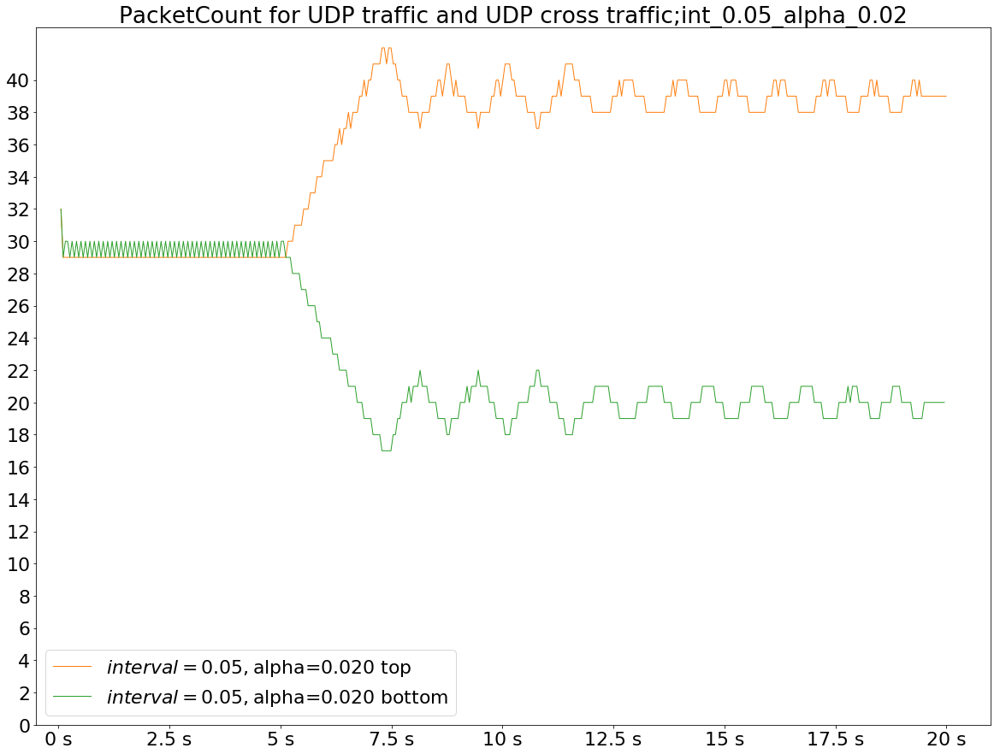

[34.]


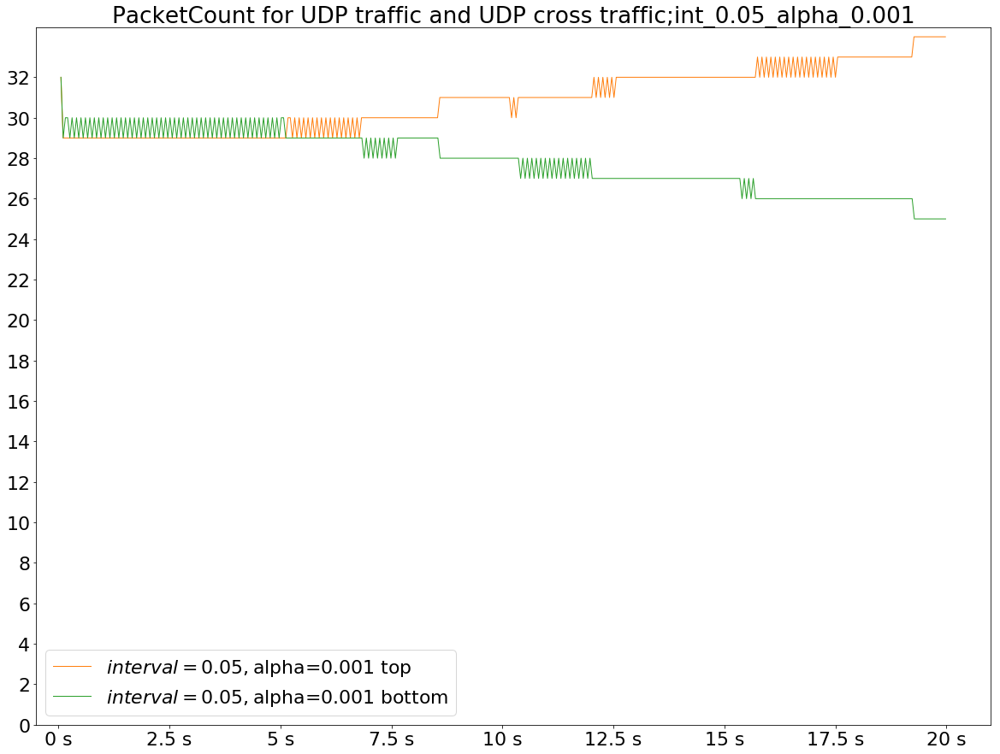

[32.]


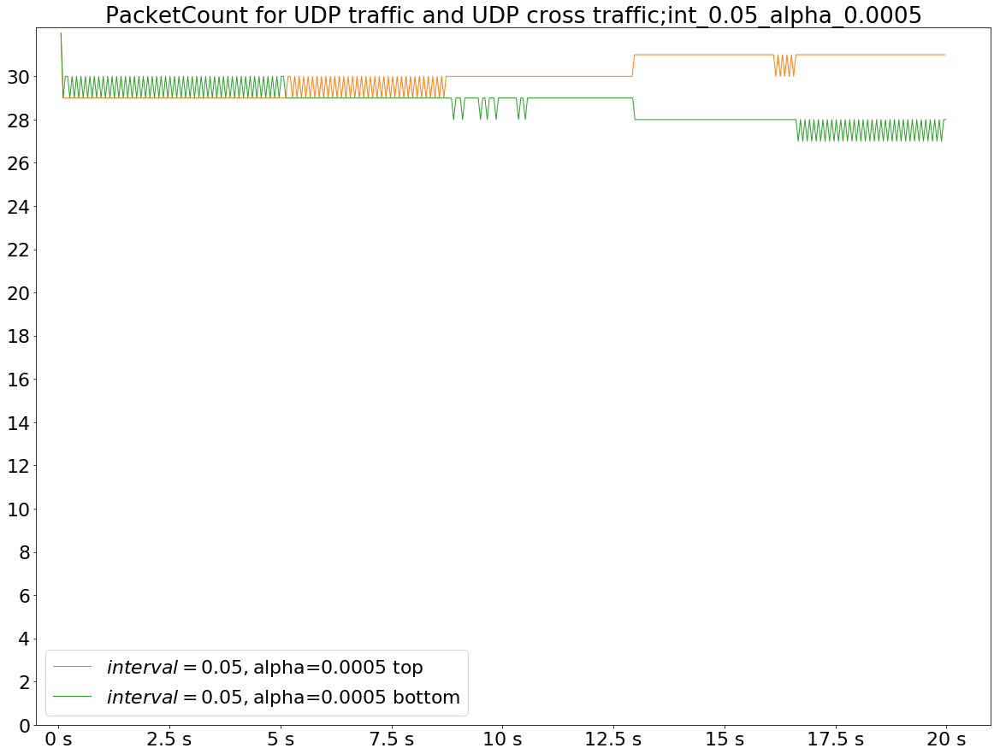

[55.]


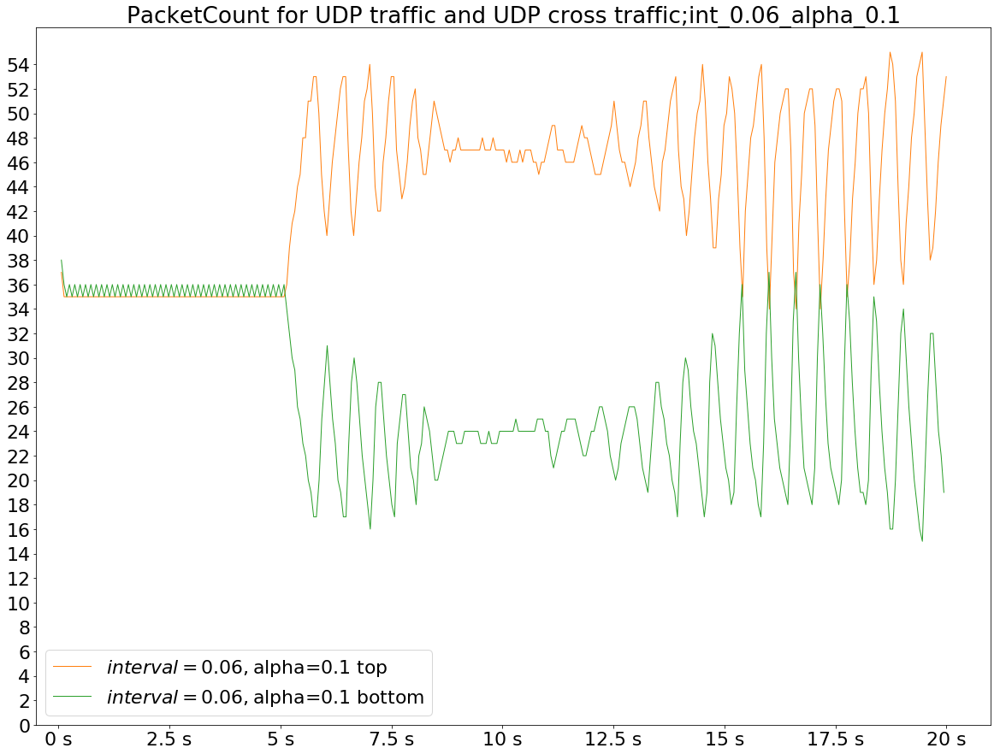

[53.]


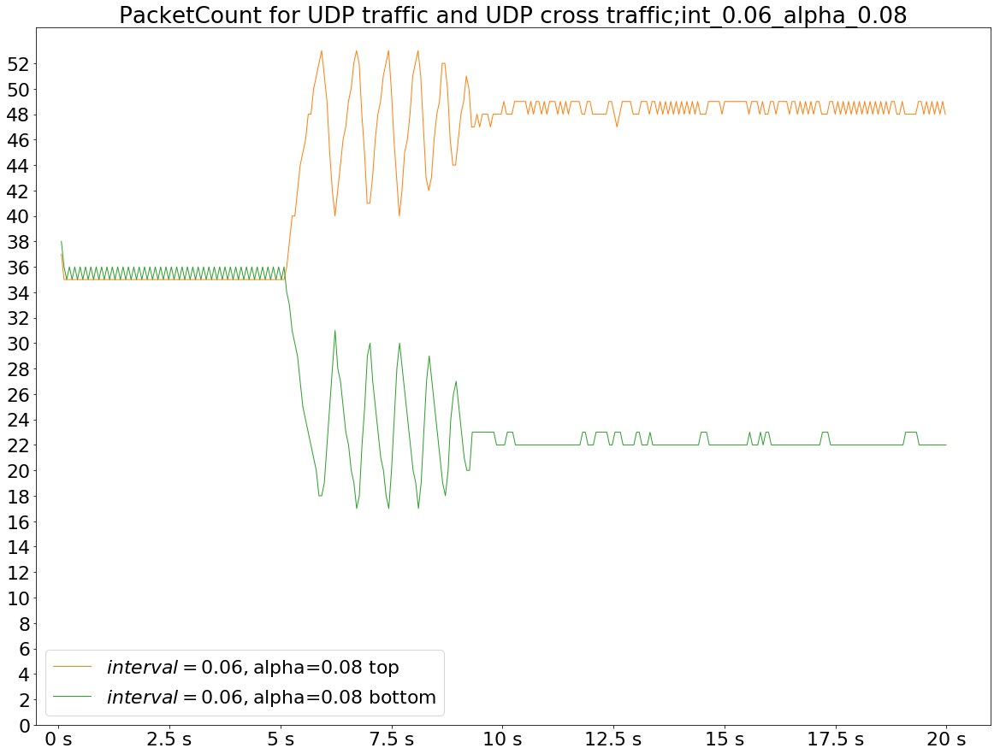

[52.]


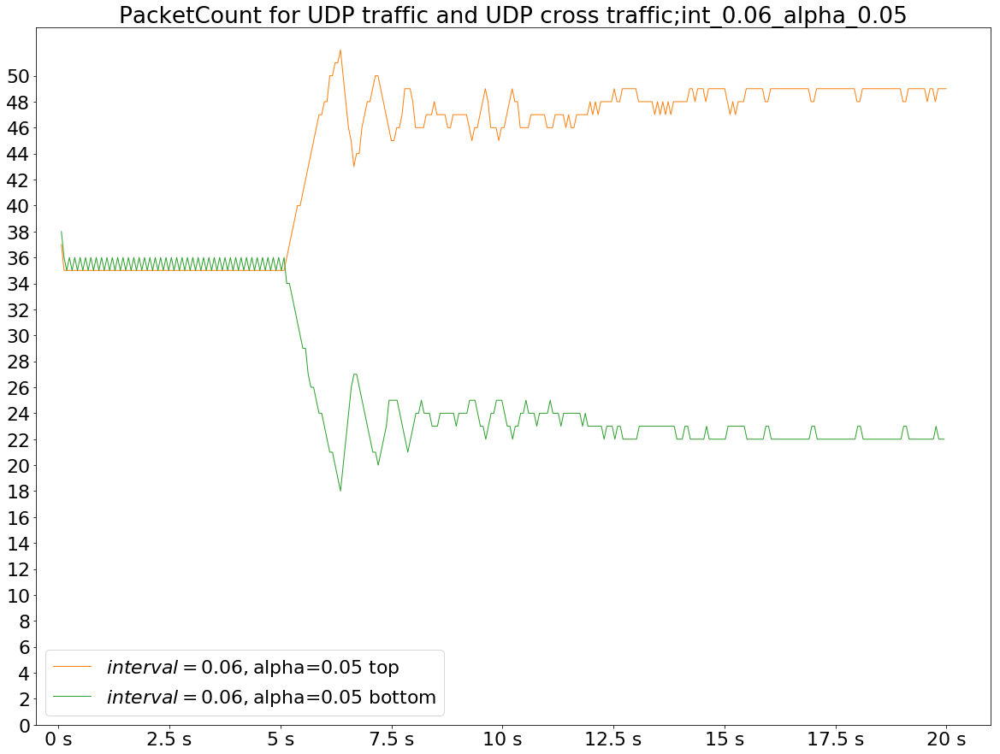

[51.]


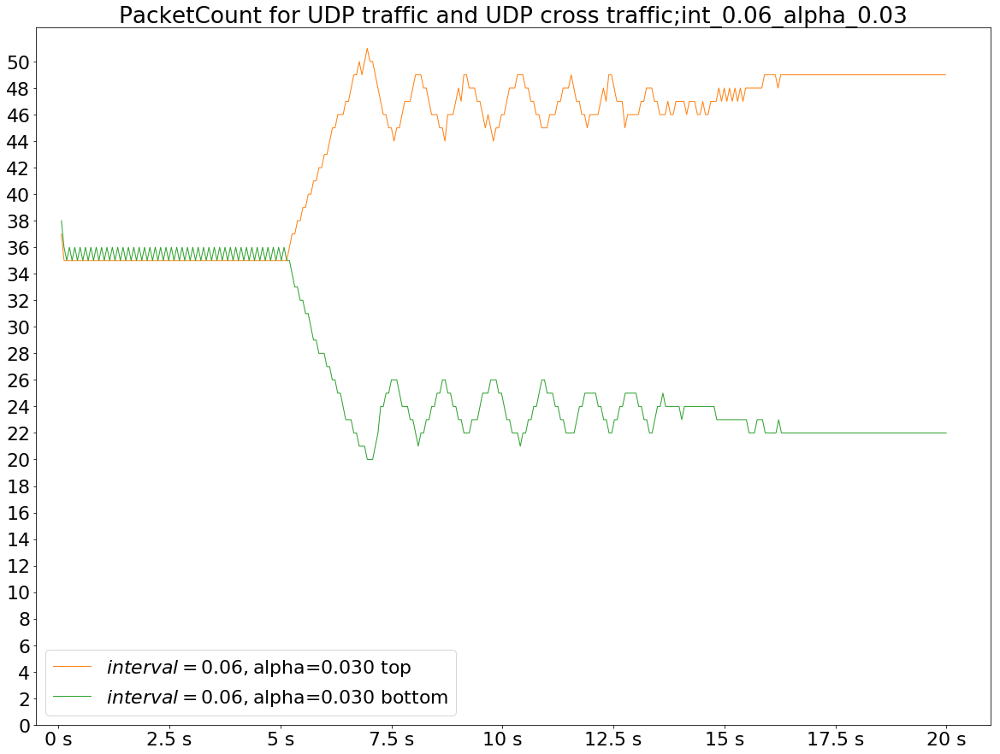

[49.]


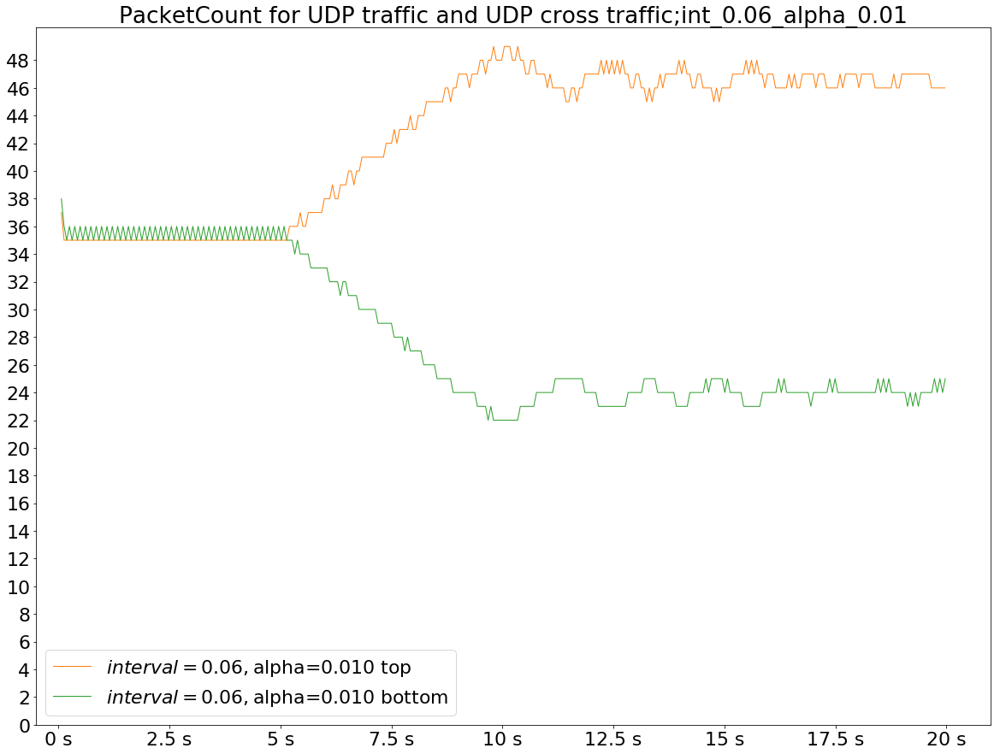

[75.]


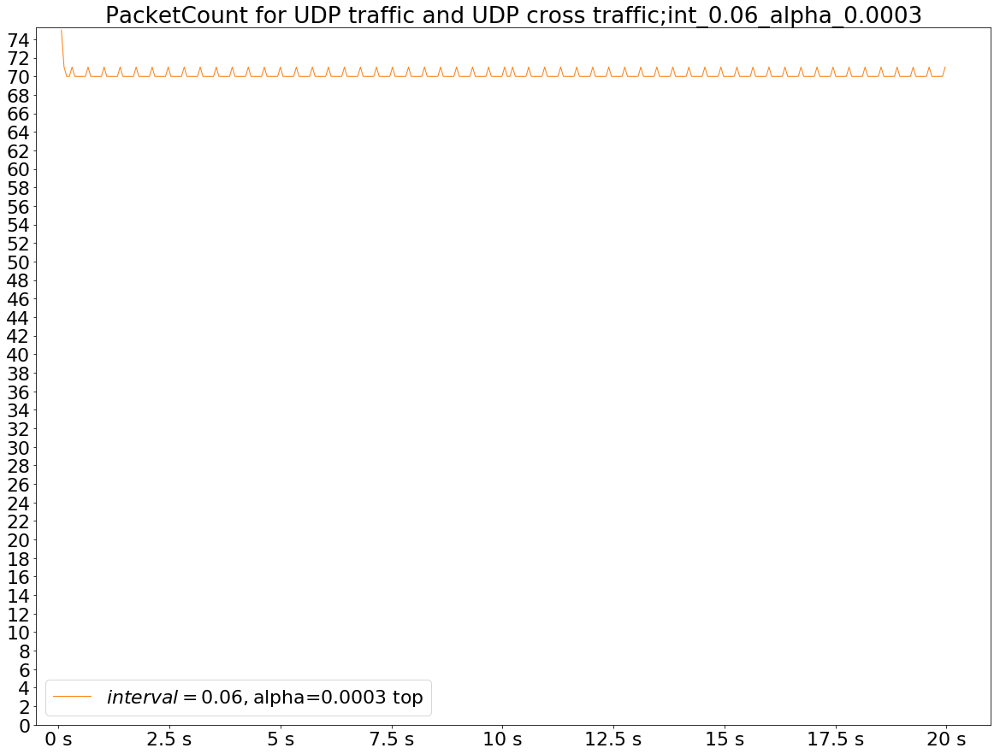

[49.]


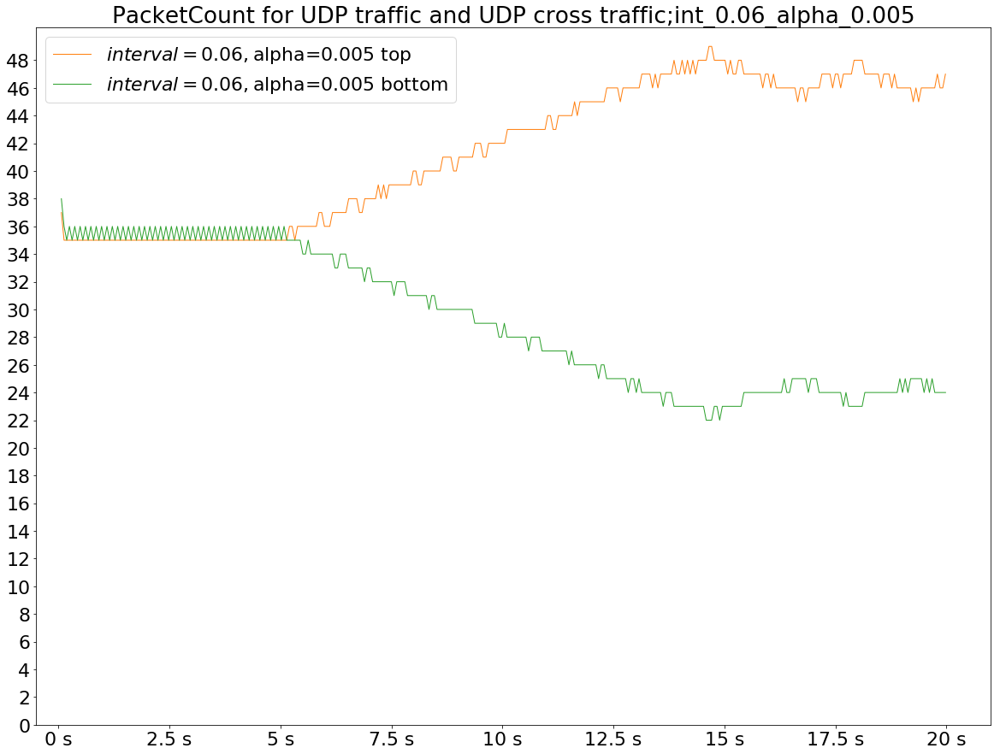

[50.]


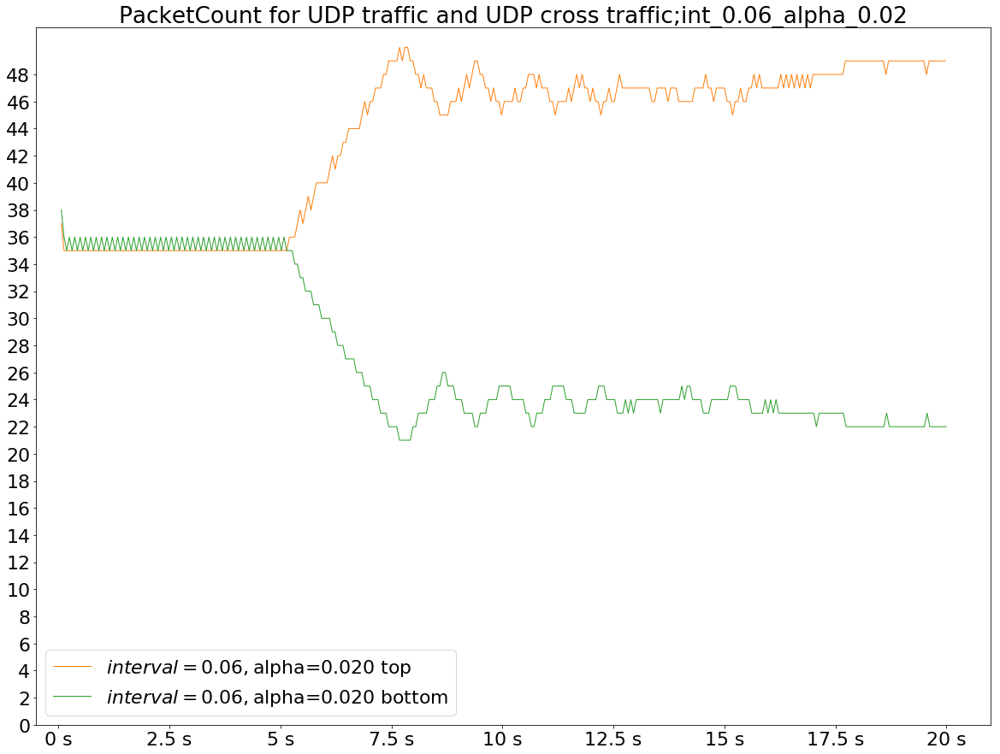

[40.]


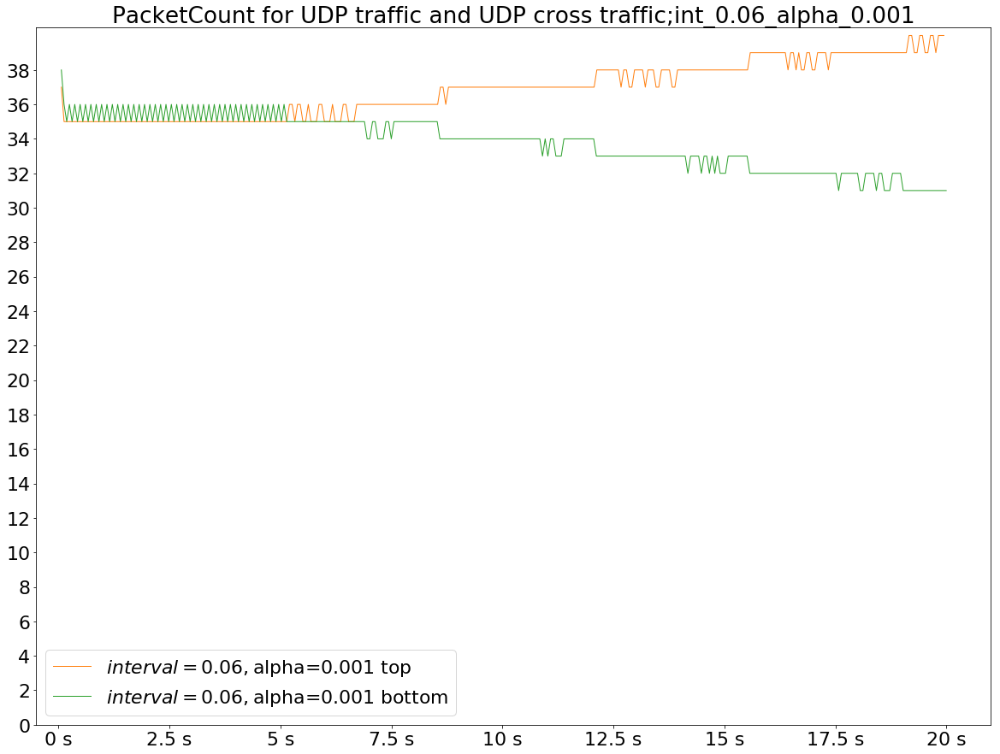

[38.]


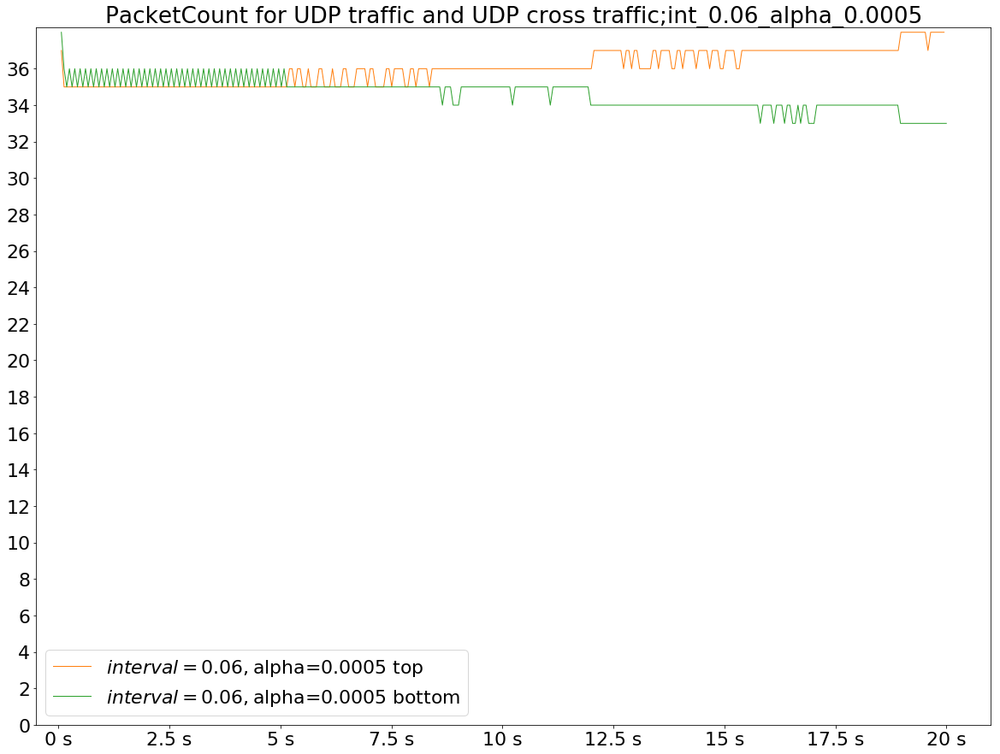

[63.]


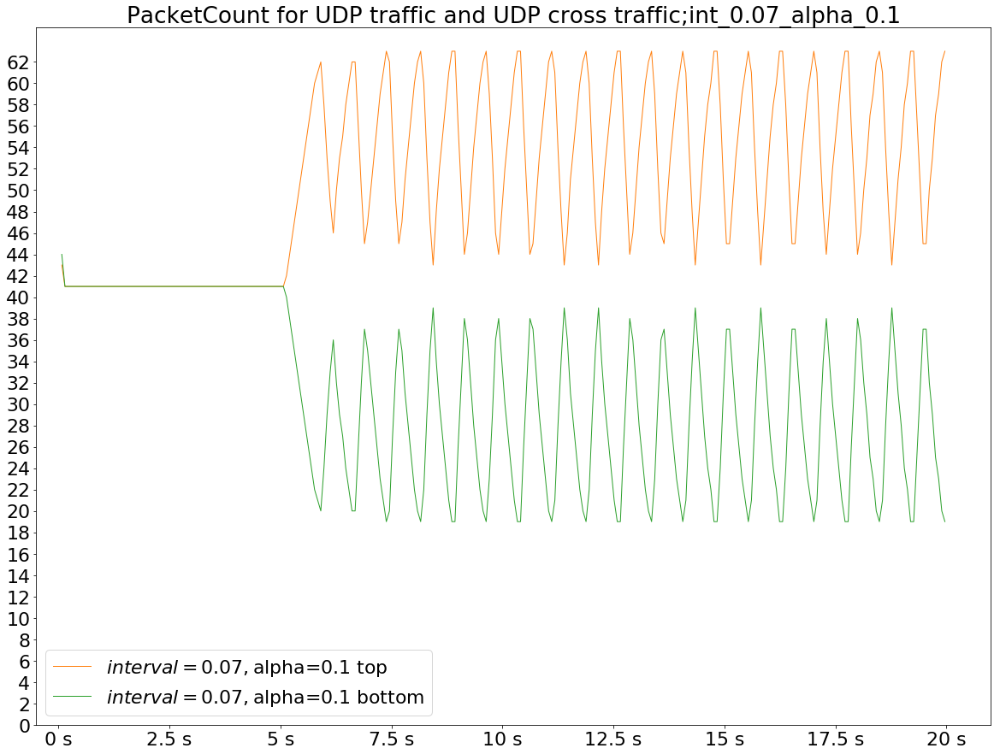

[63.]


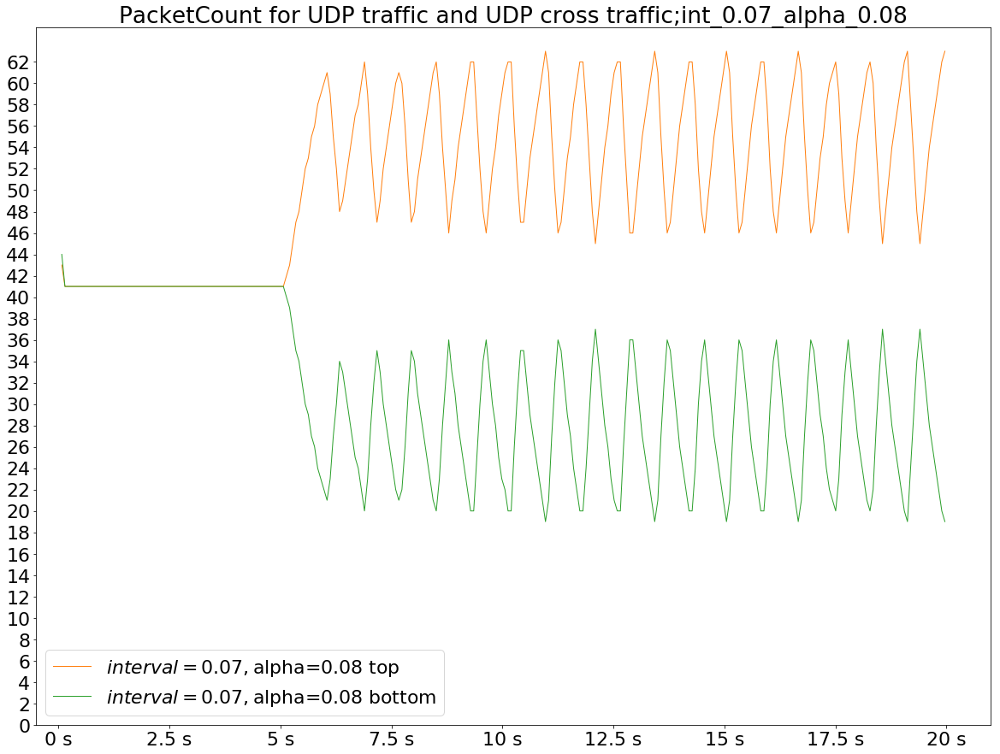

[60.]


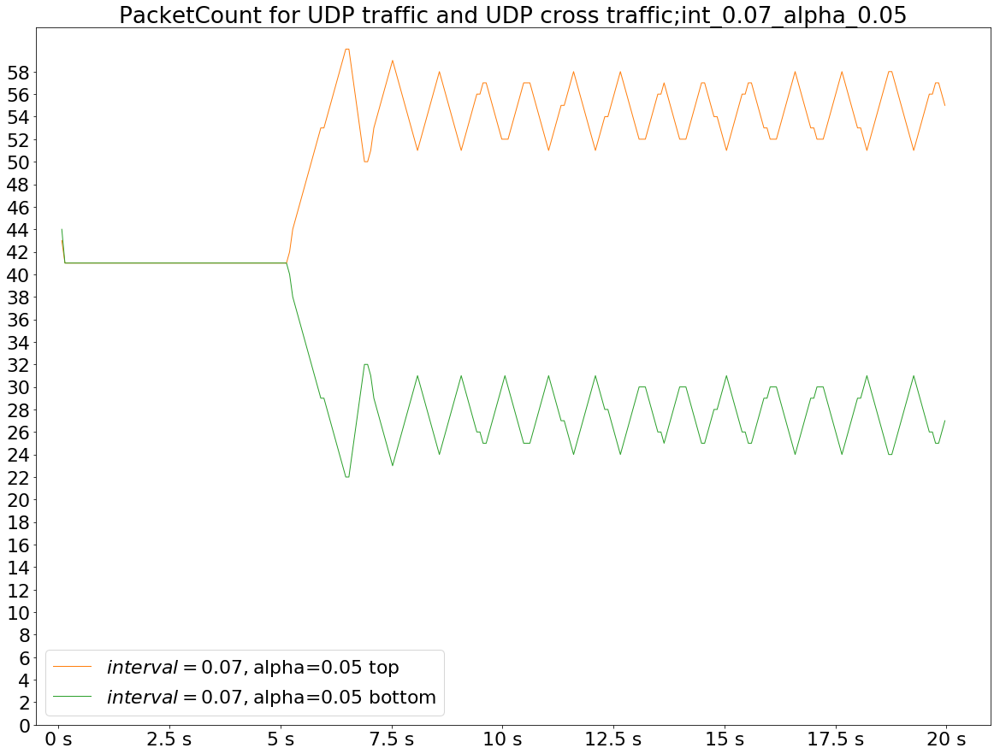

[59.]


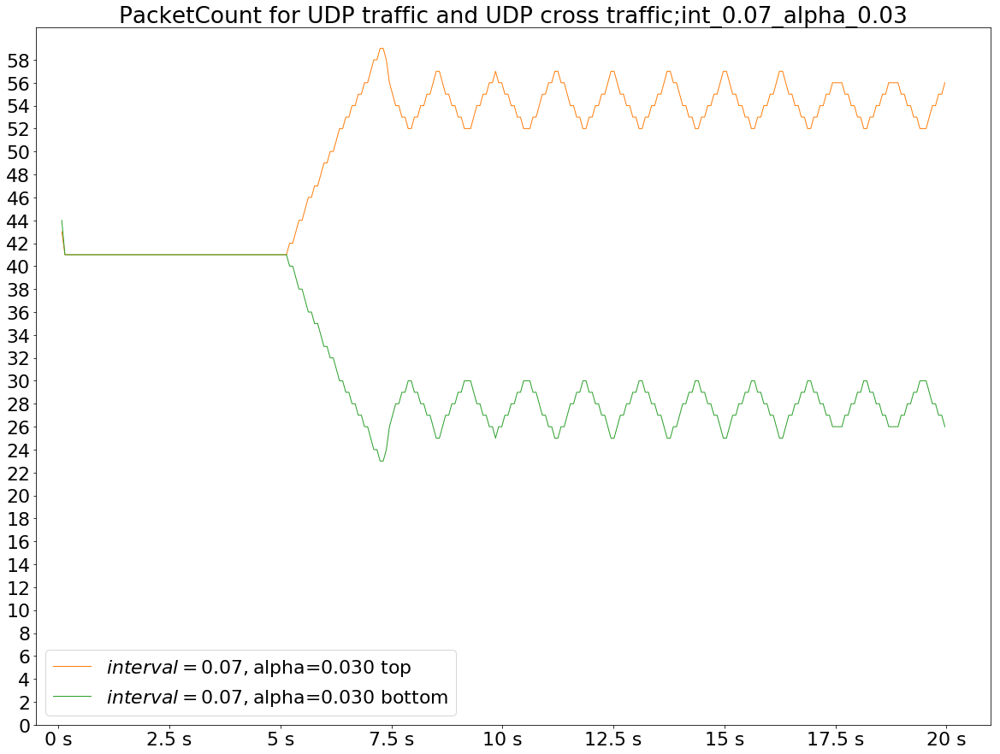

[57.]


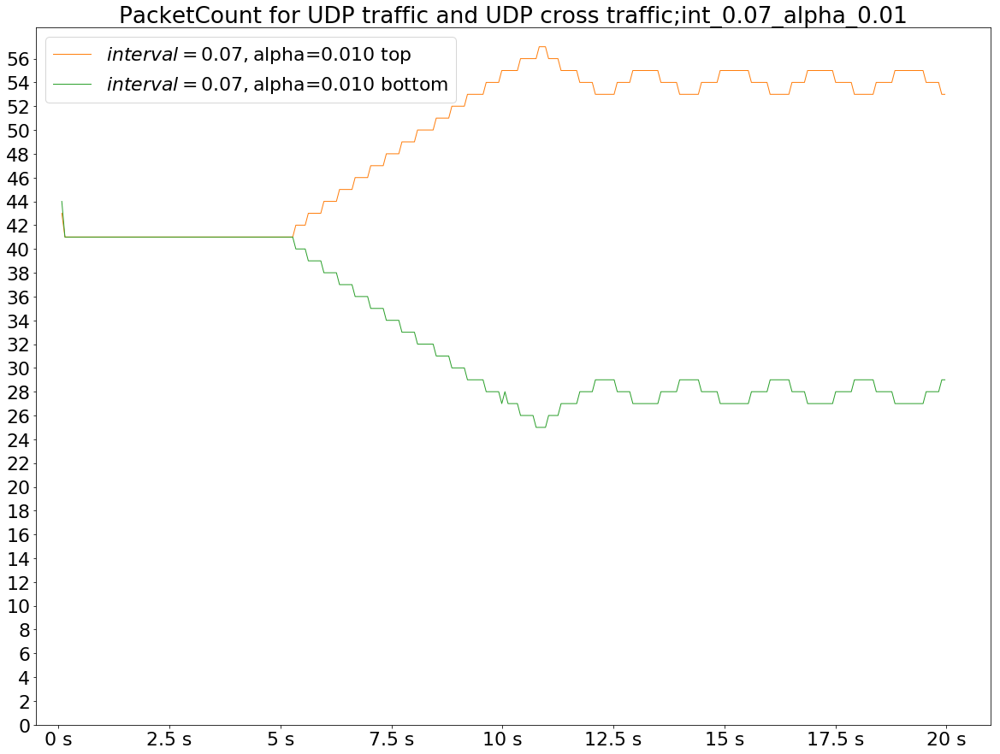

[43.]


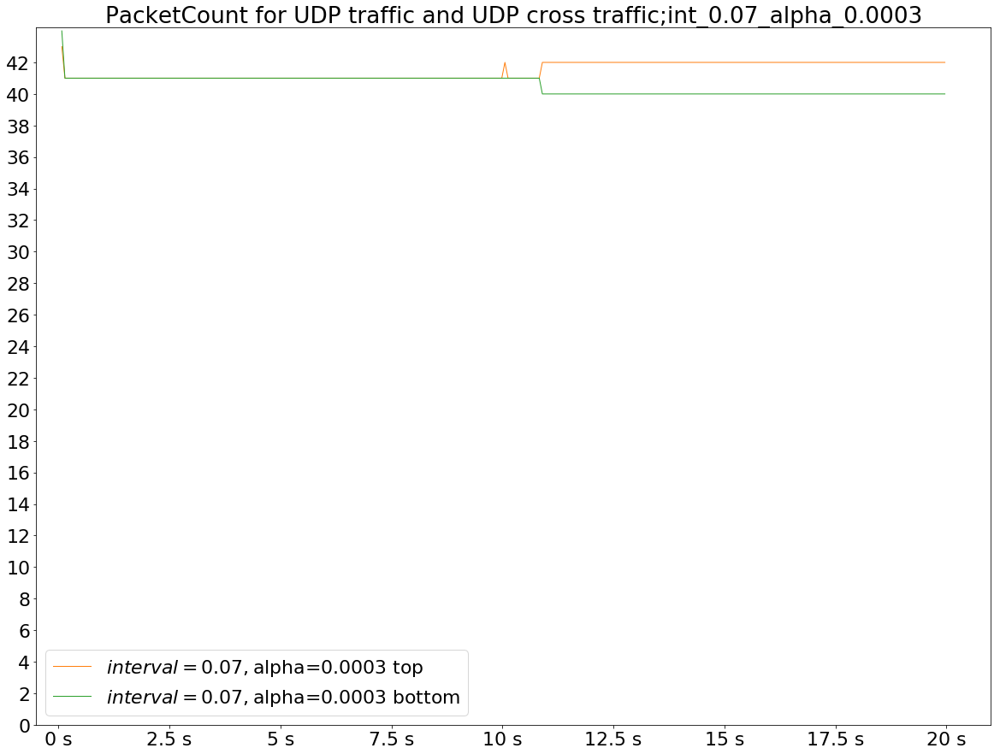

[56.]


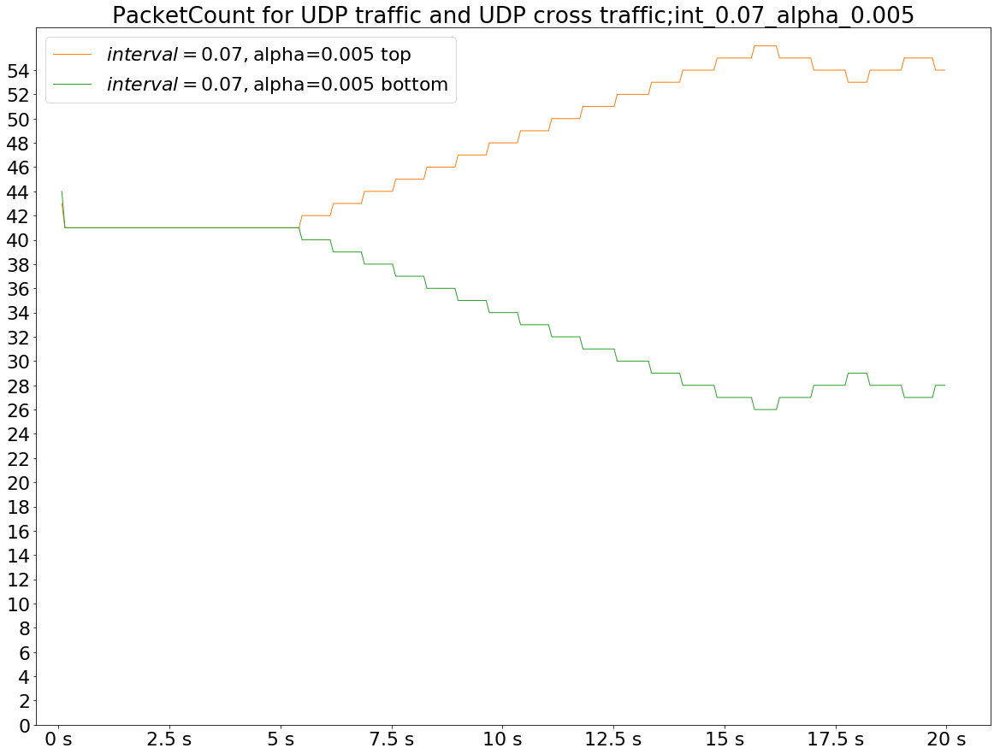

[58.]


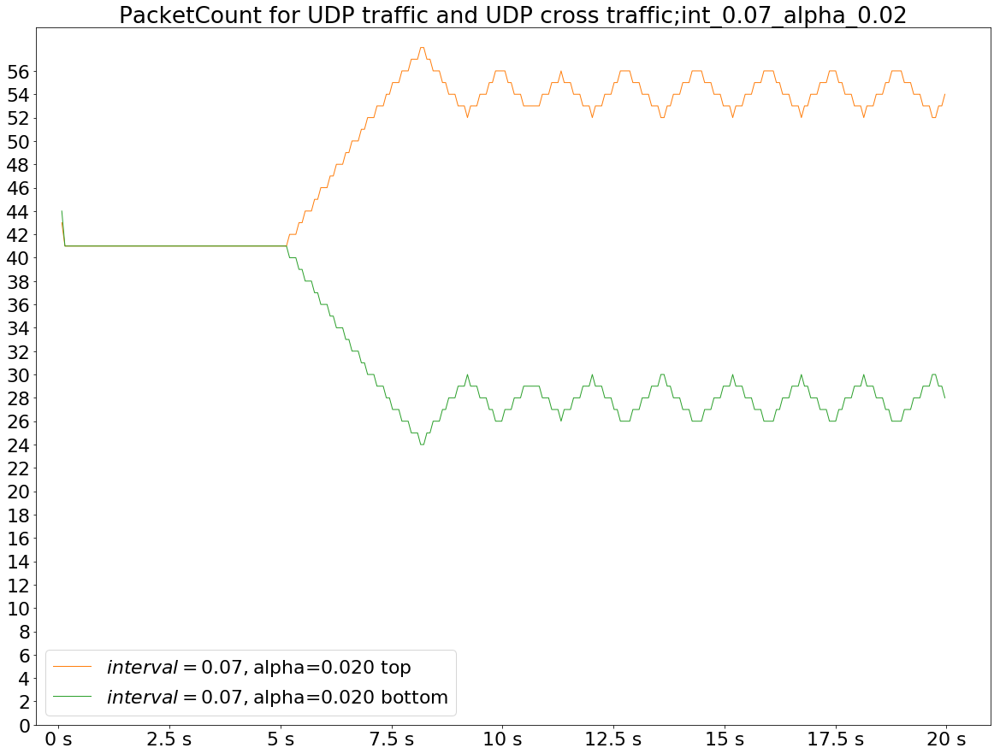

[45.]


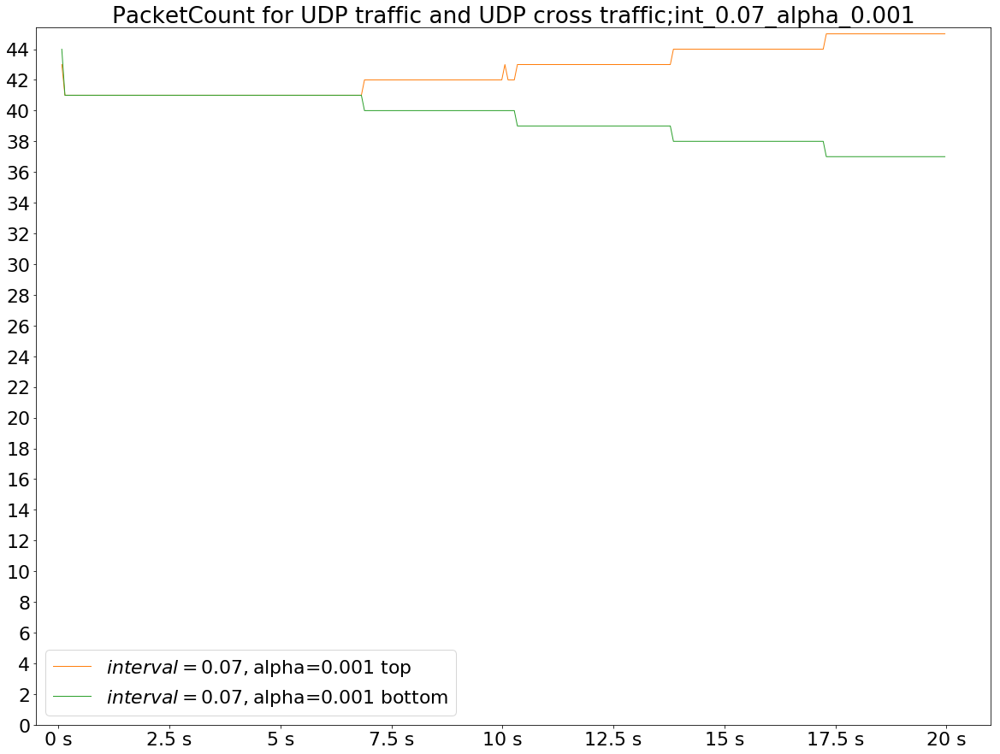

[87.]


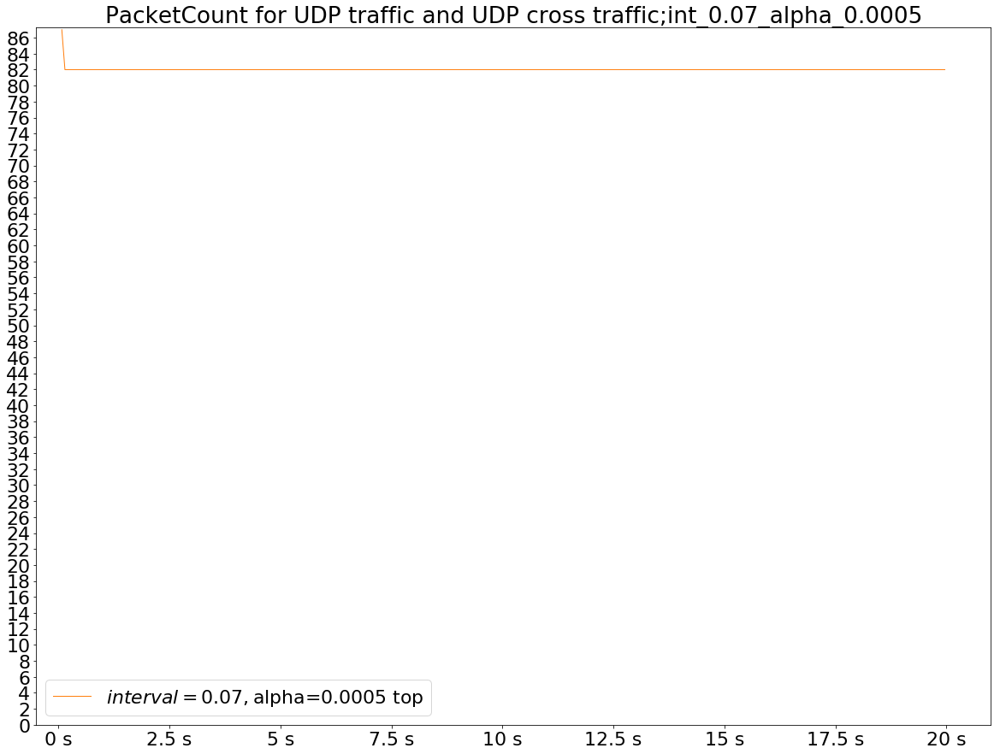

[72.]


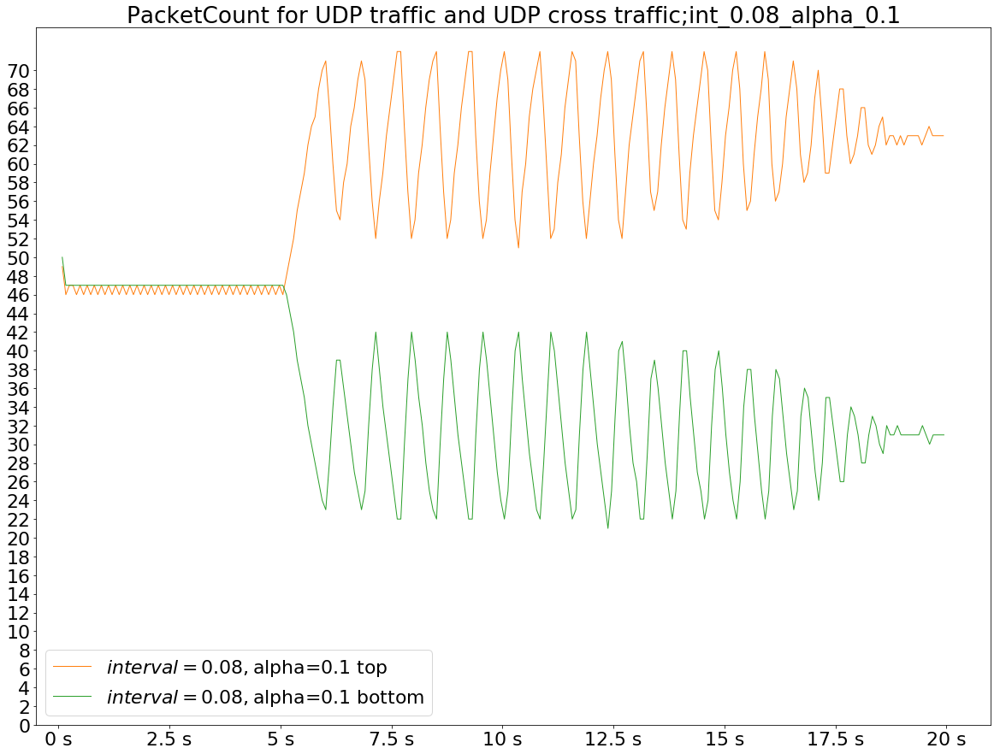

[70.]


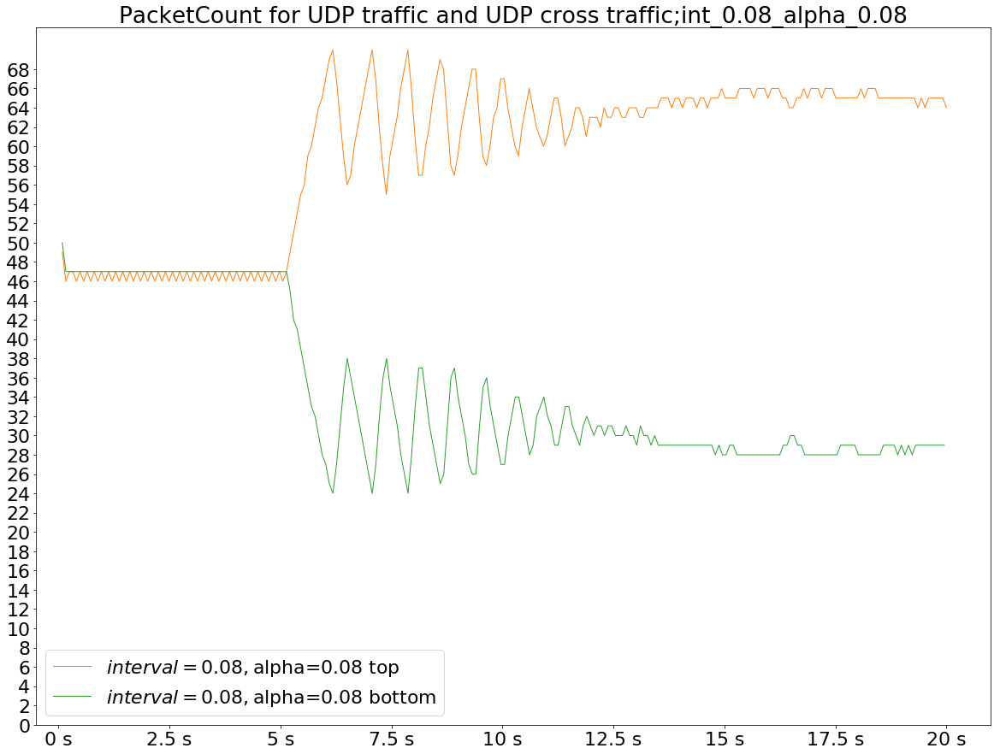

[68.]


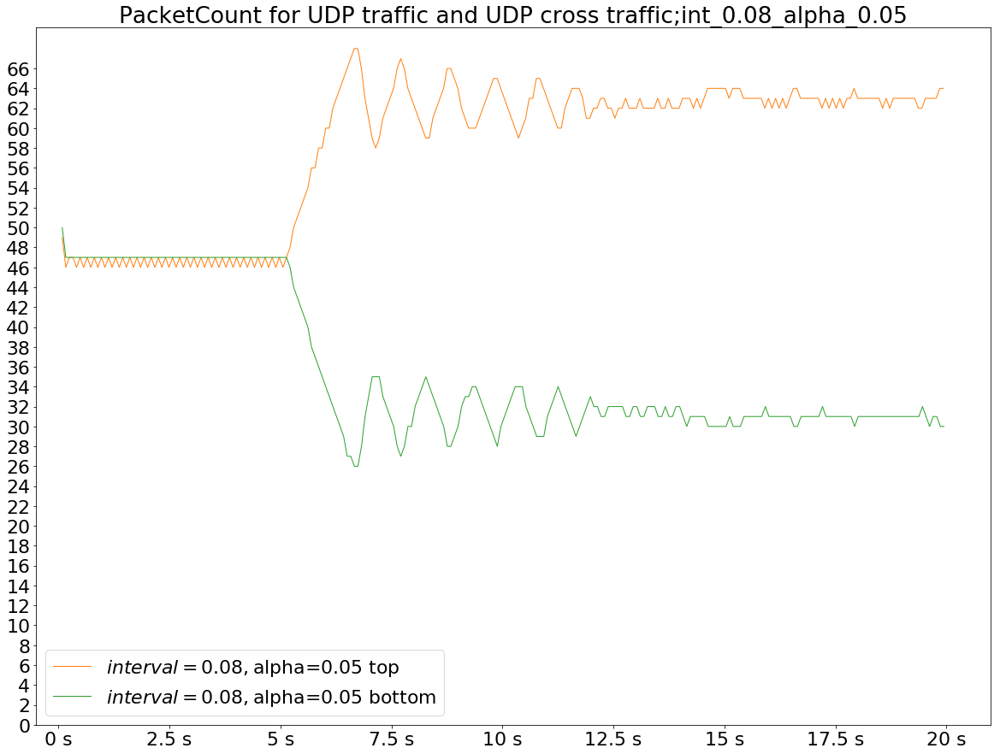

[67.]


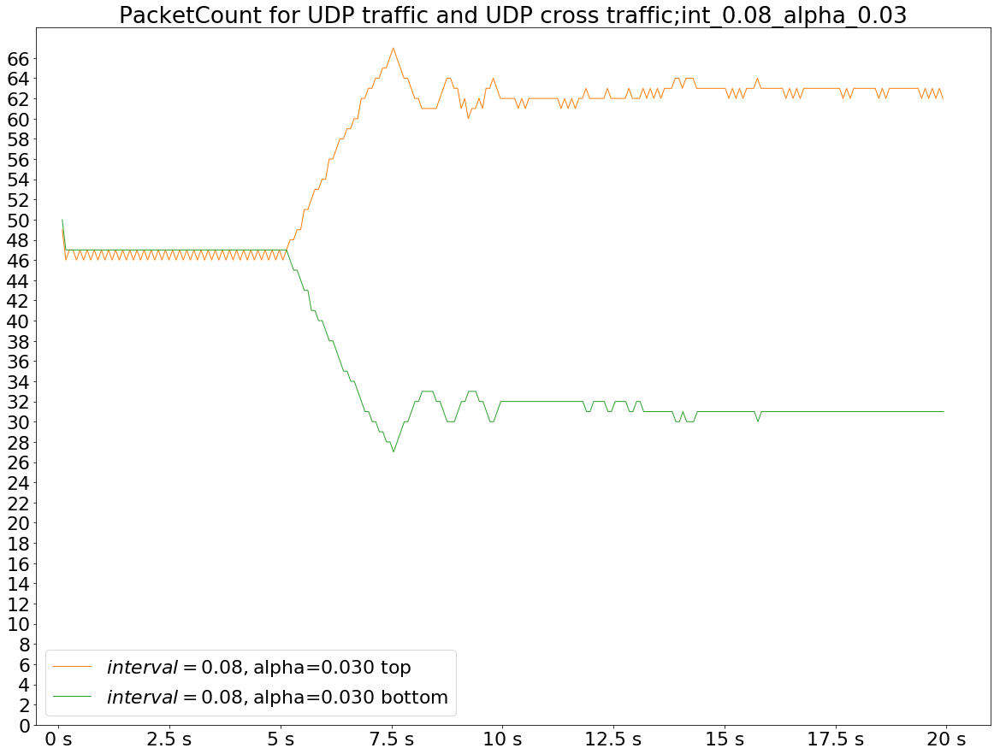

[65.]


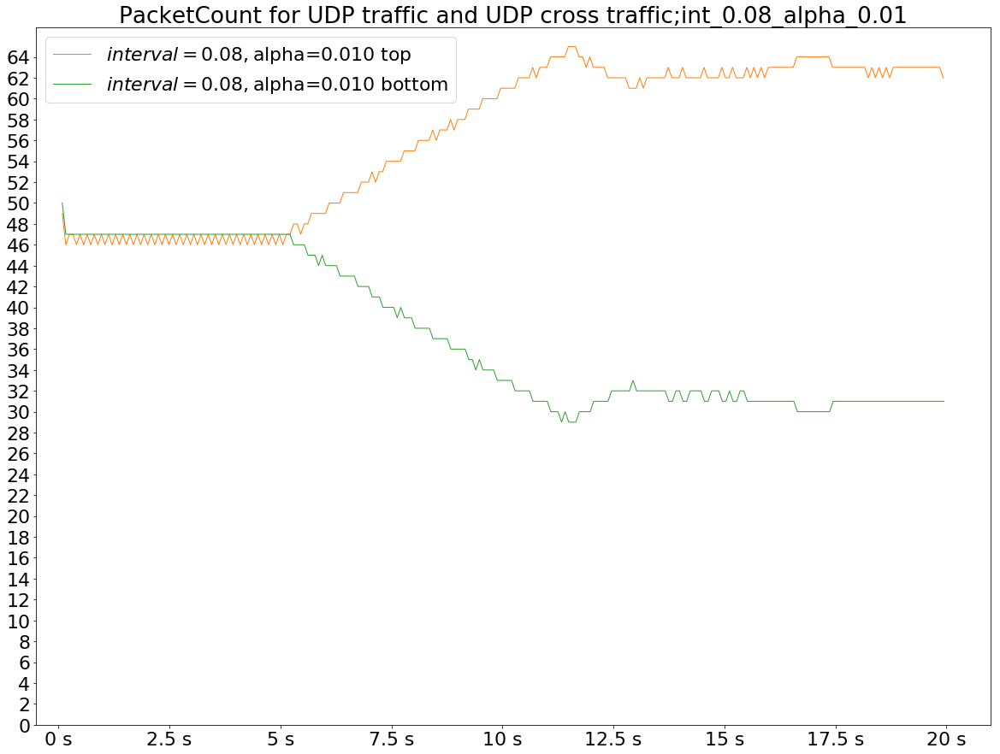

[49.]


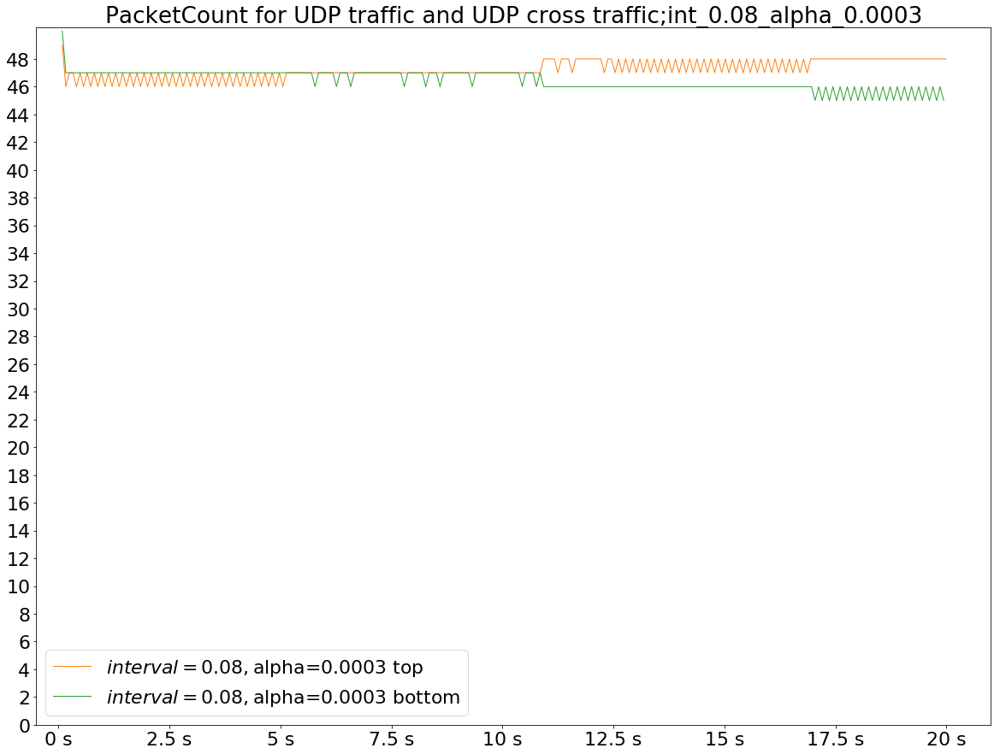

[64.]


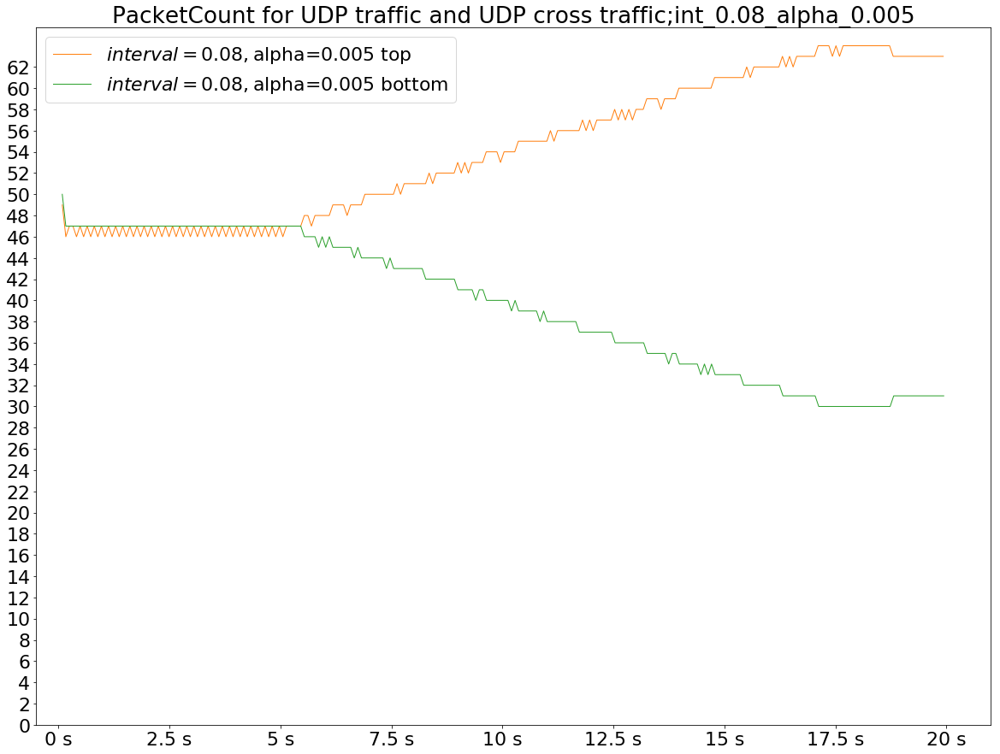

[66.]


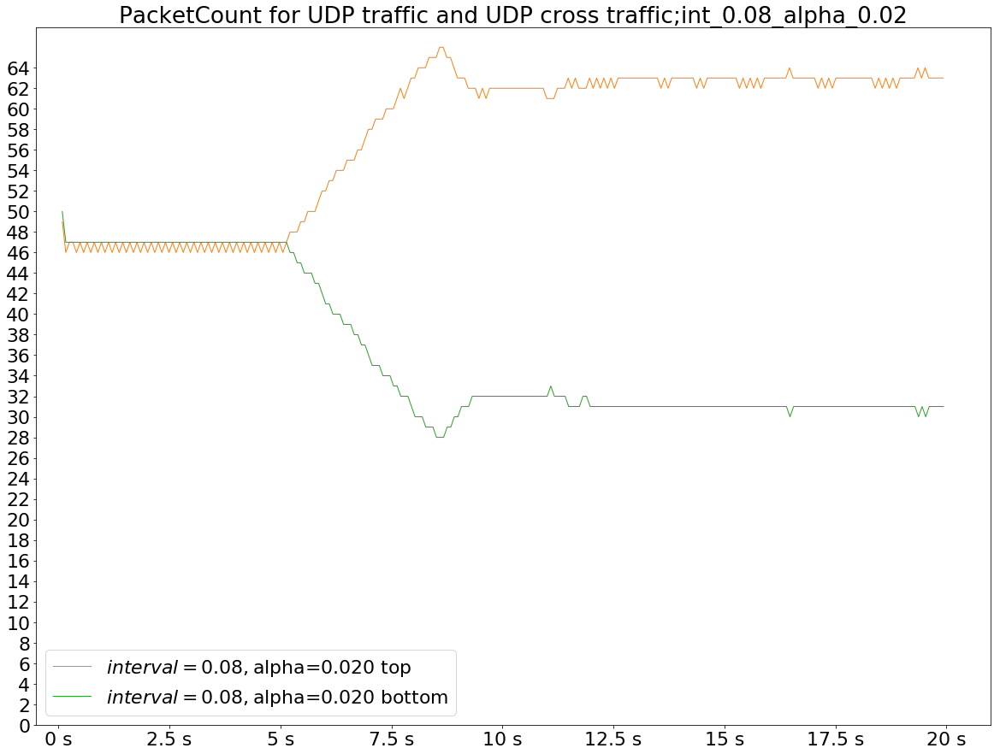

[51.]


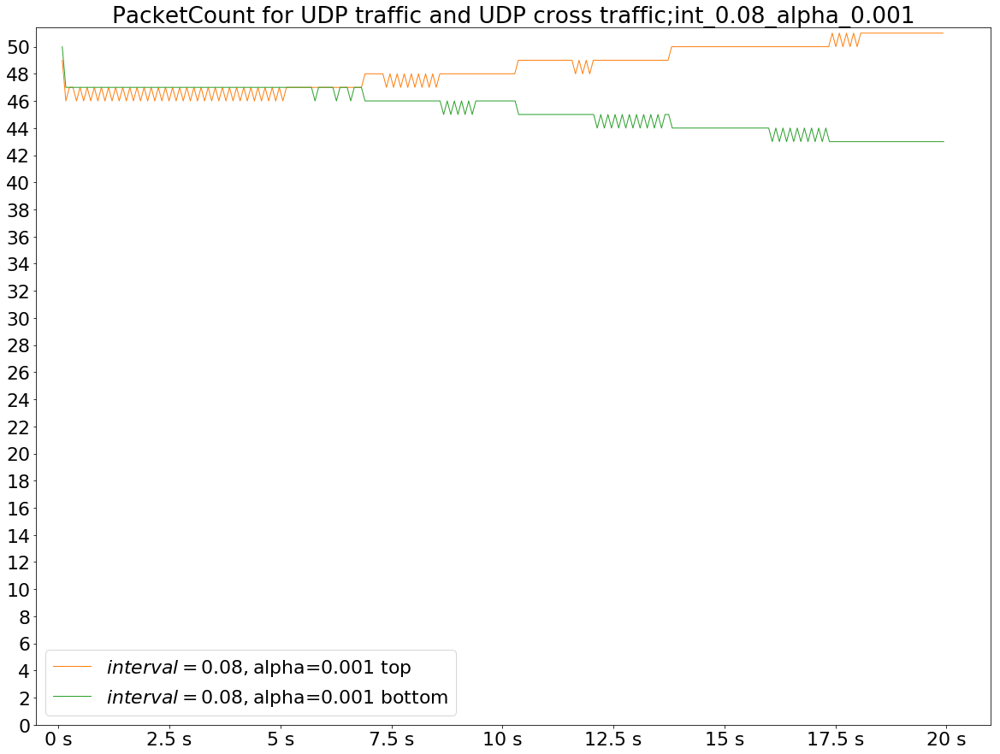

[49.]


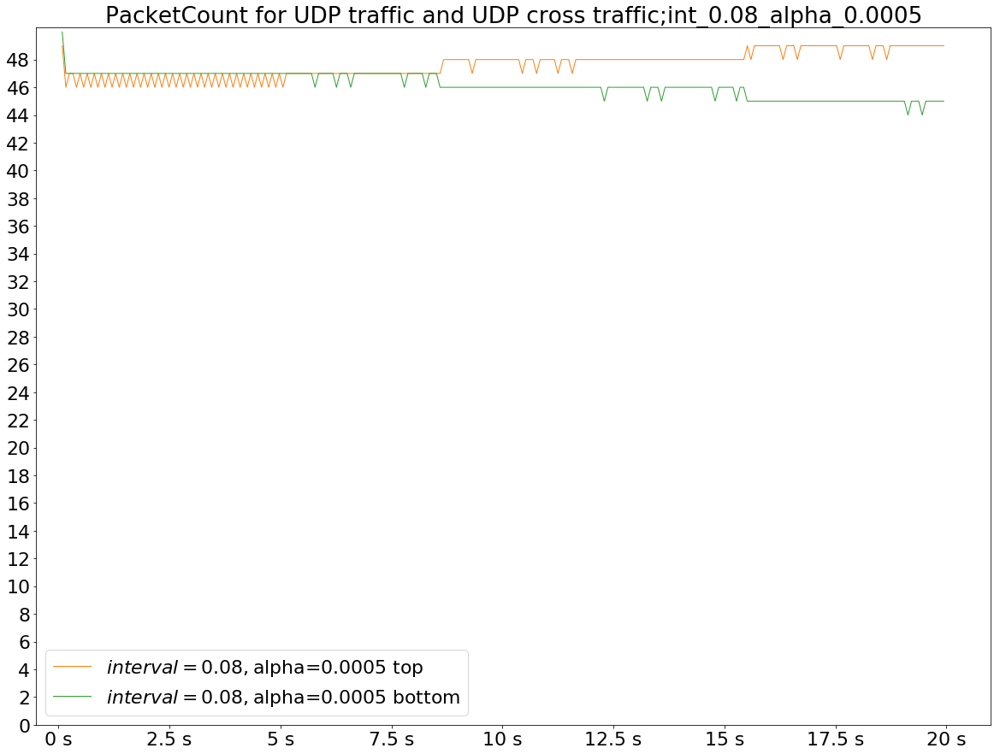

[81.]


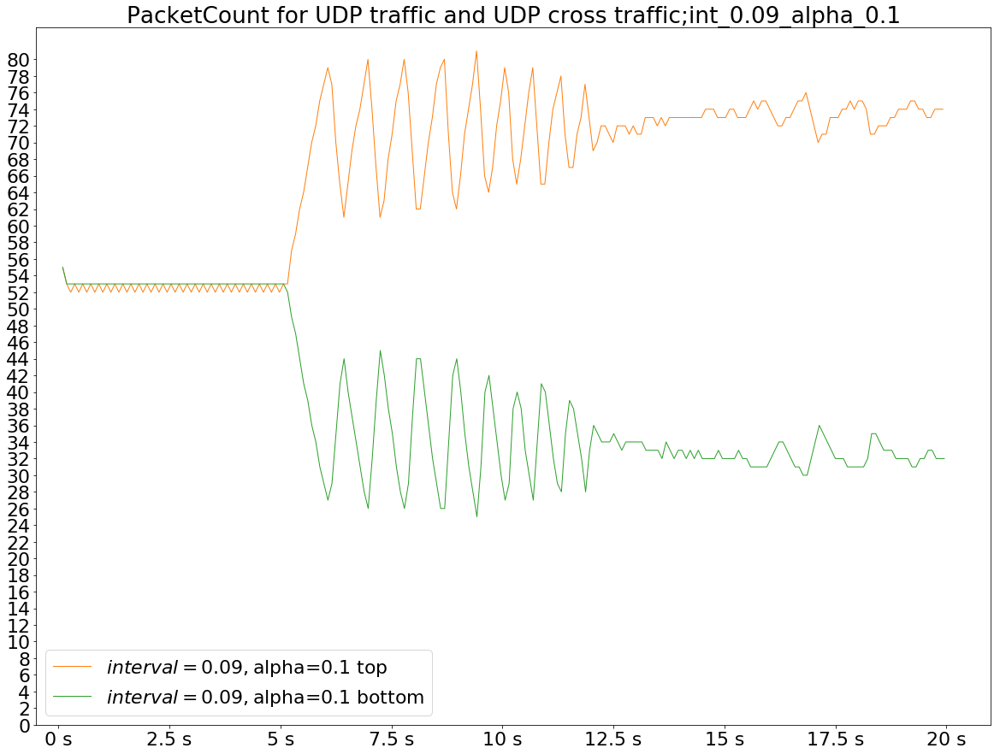

[77.]


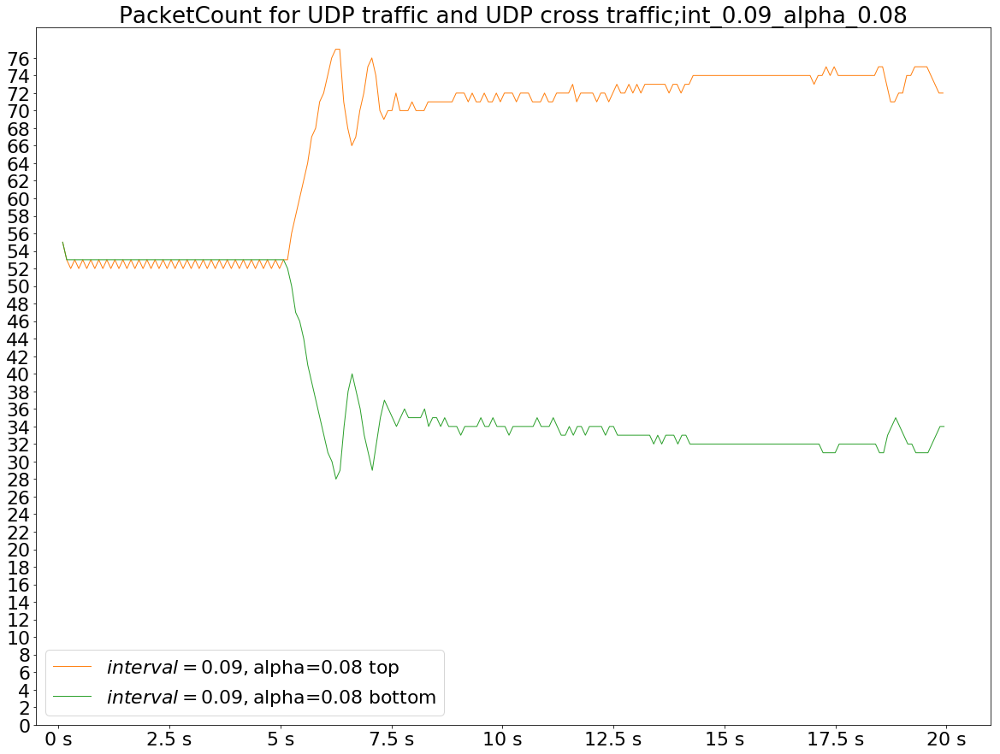

[76.]


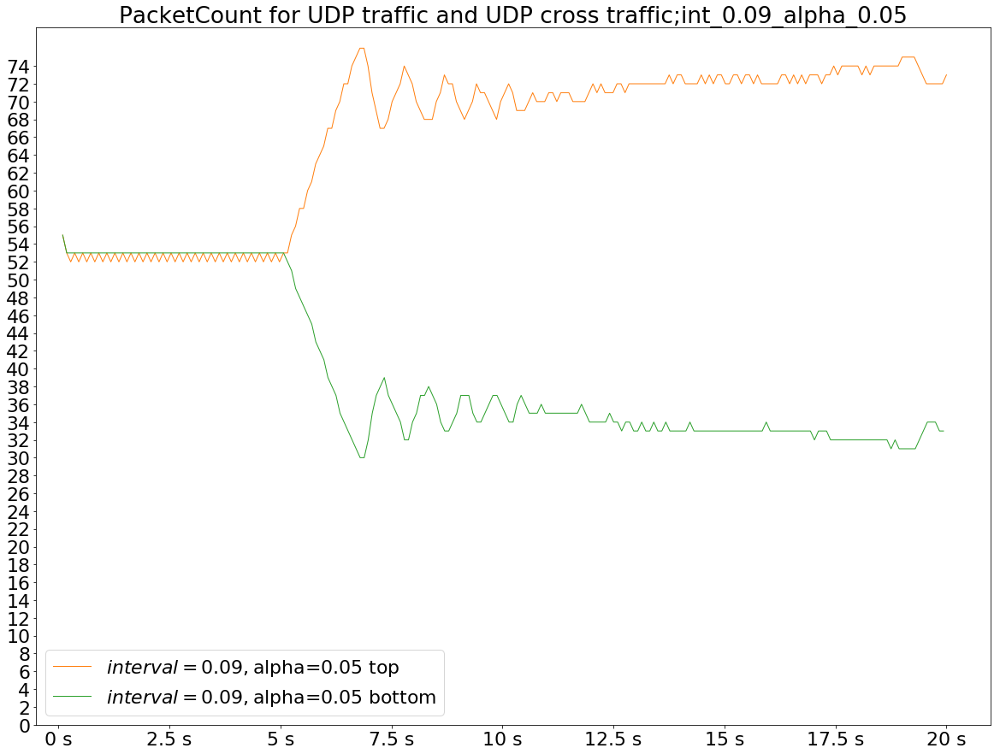

[75.]


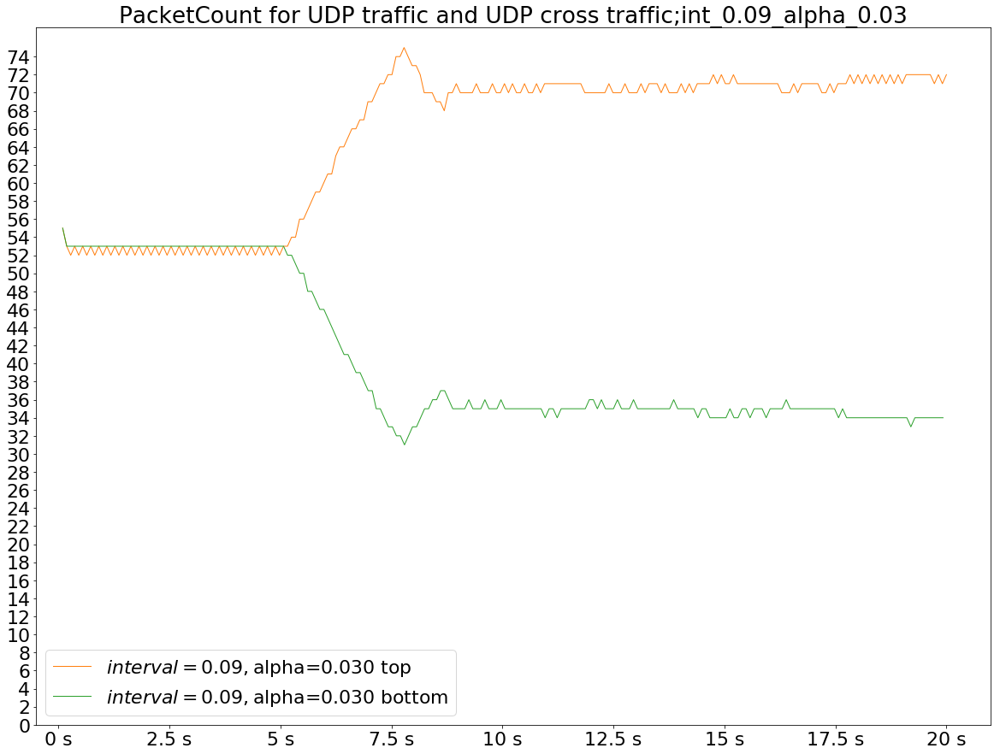

[73.]


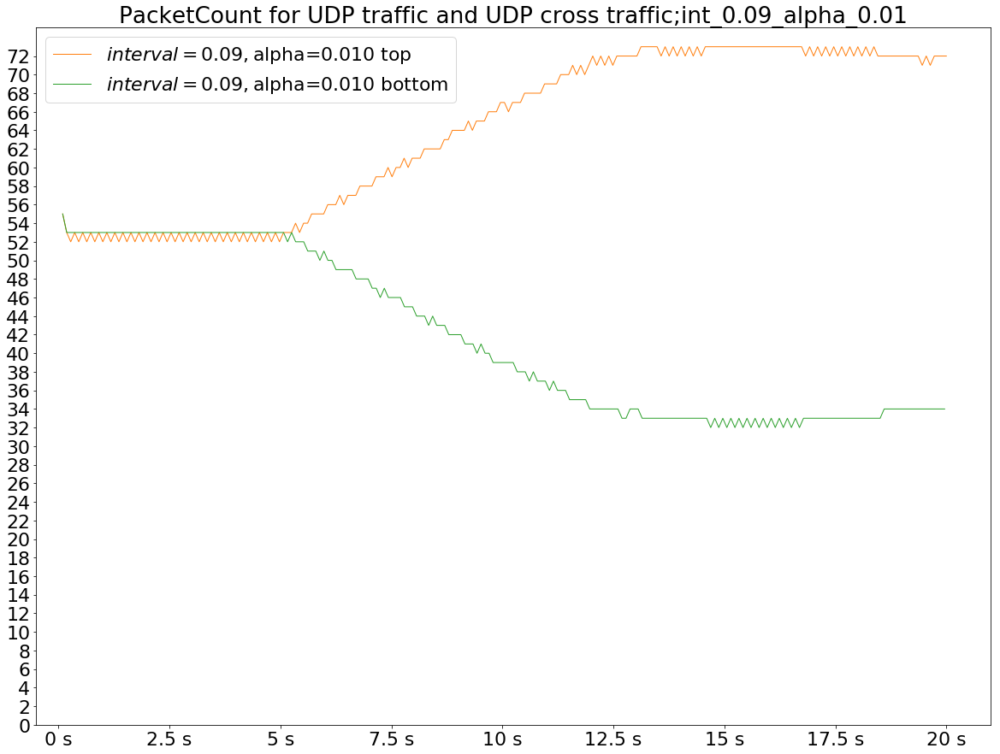

[55.]


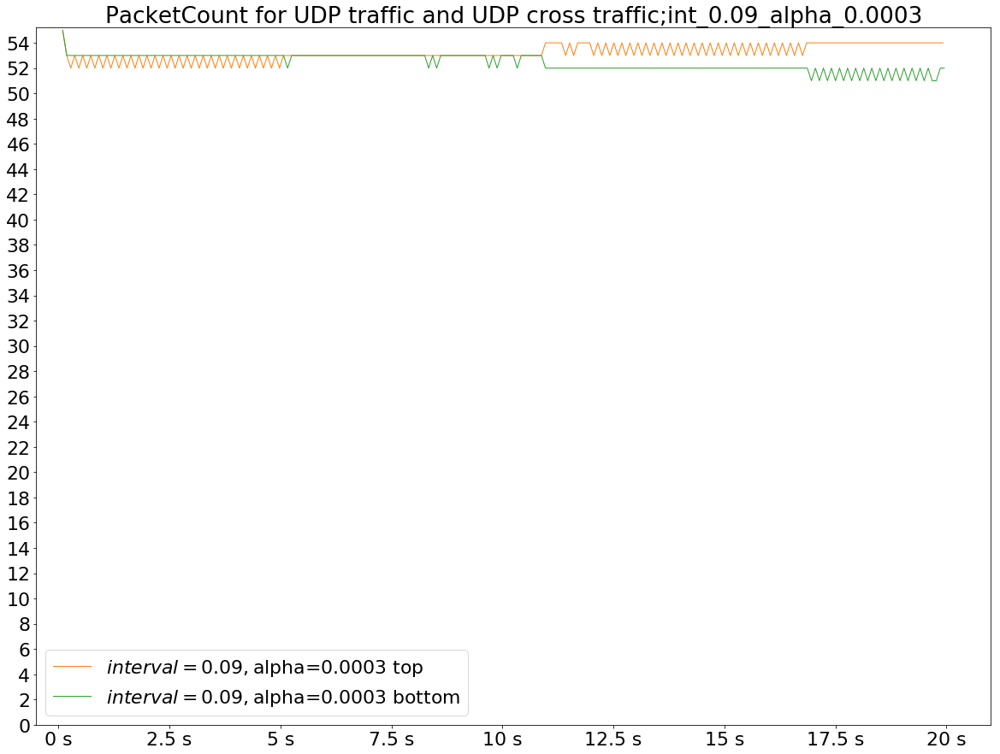

[71.]


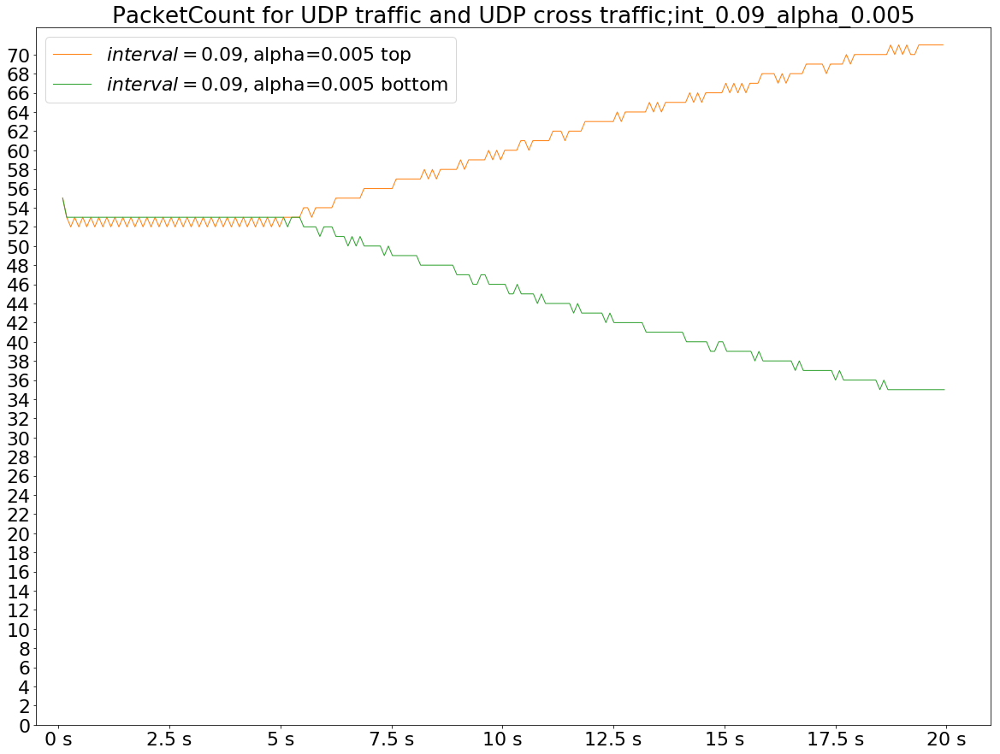

[75.]


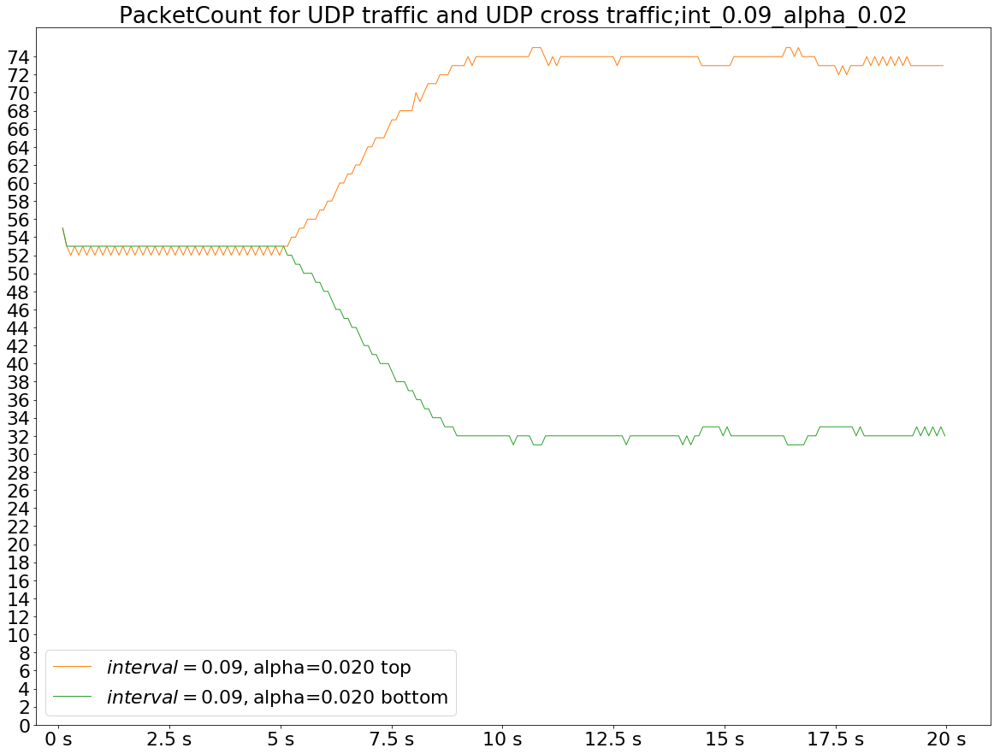

[57.]


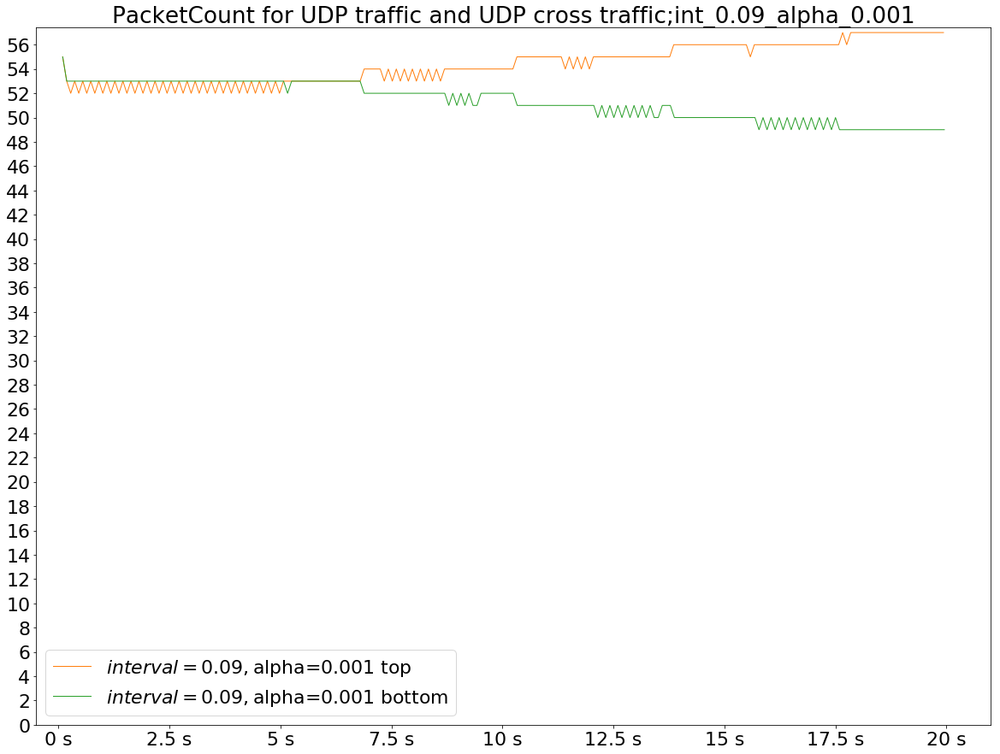

[55.]


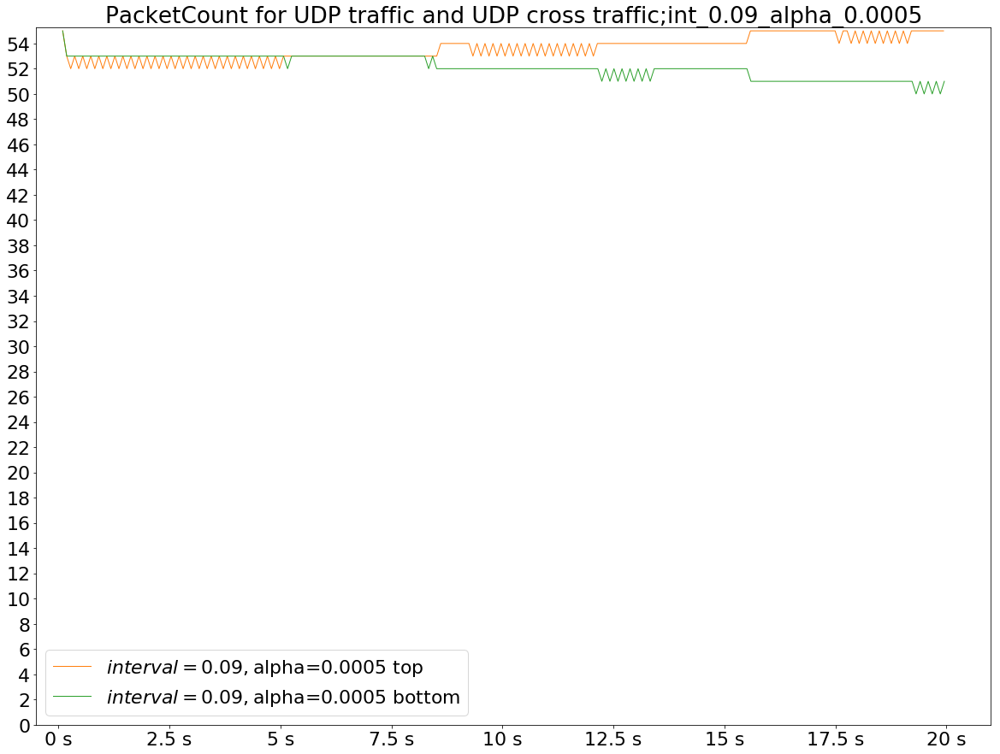

[89.]


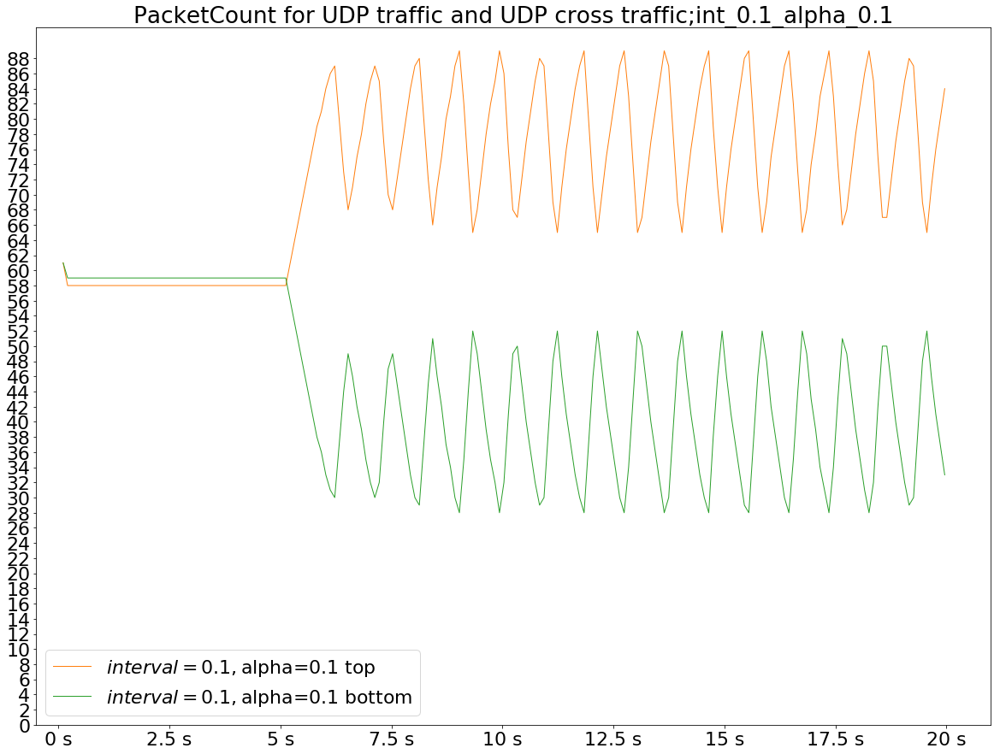

[88.]


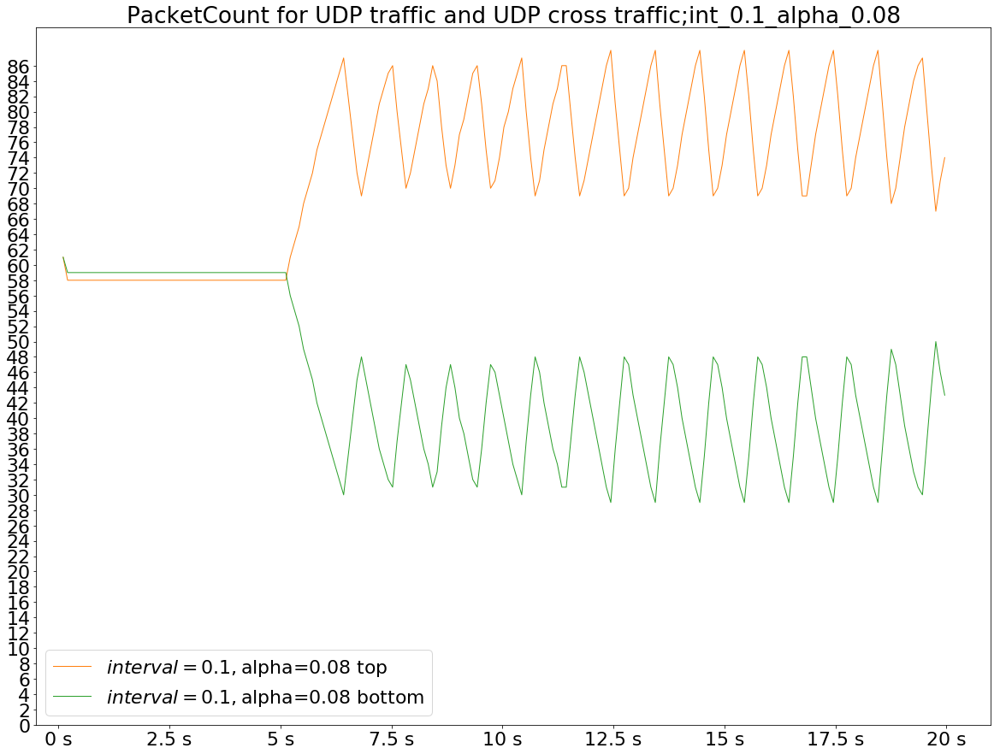

[85.]


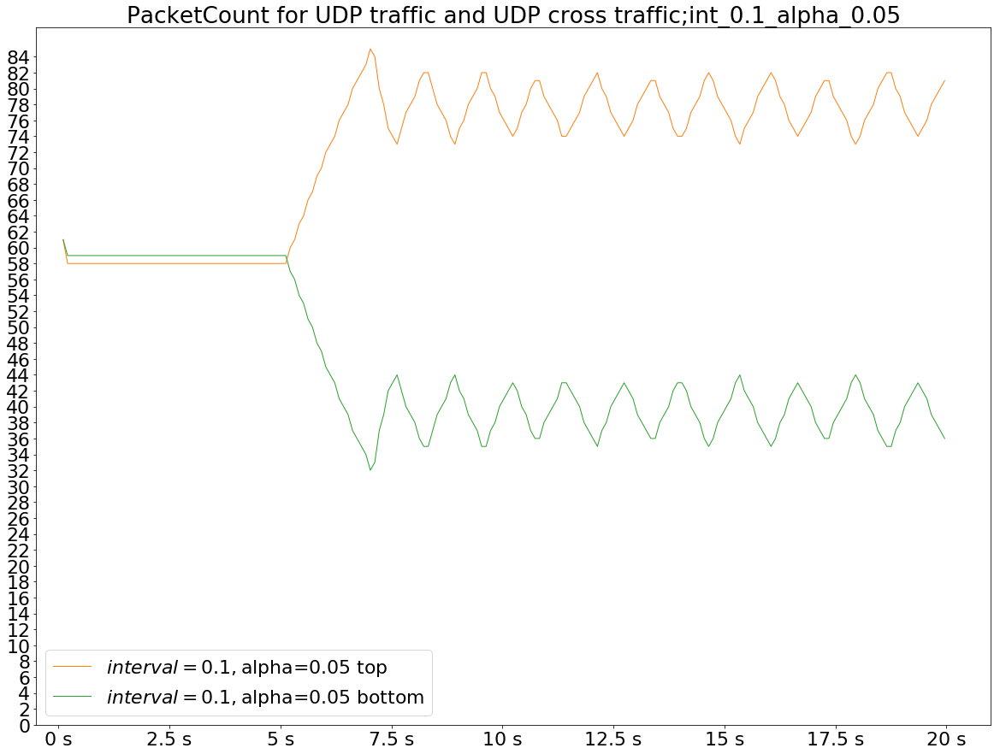

[83.]


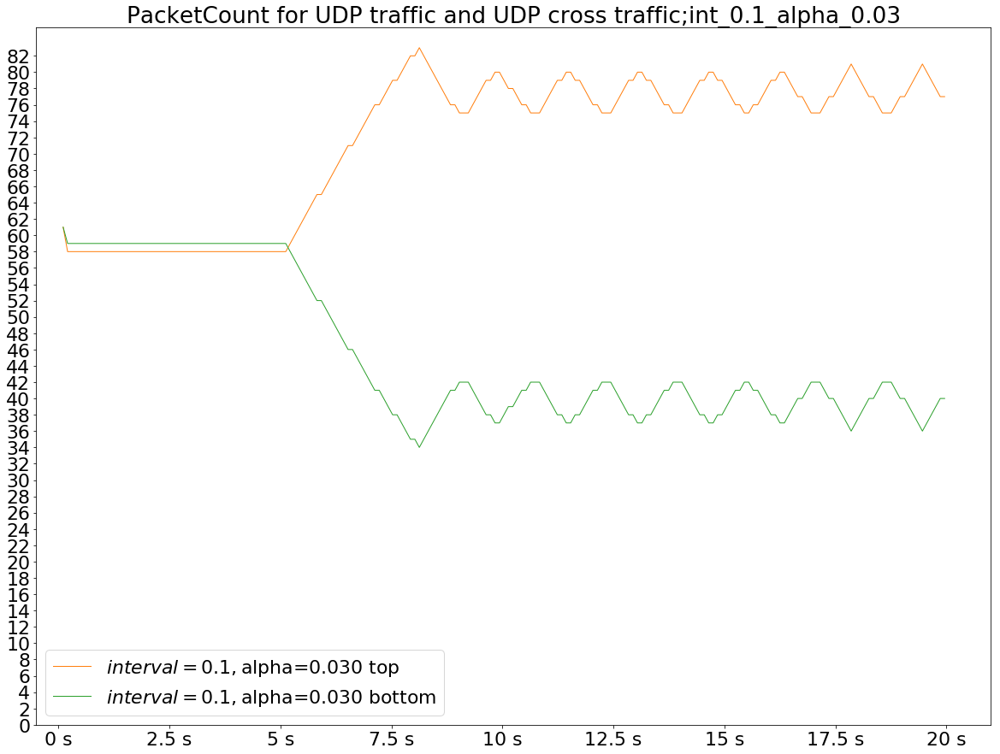

[80.]


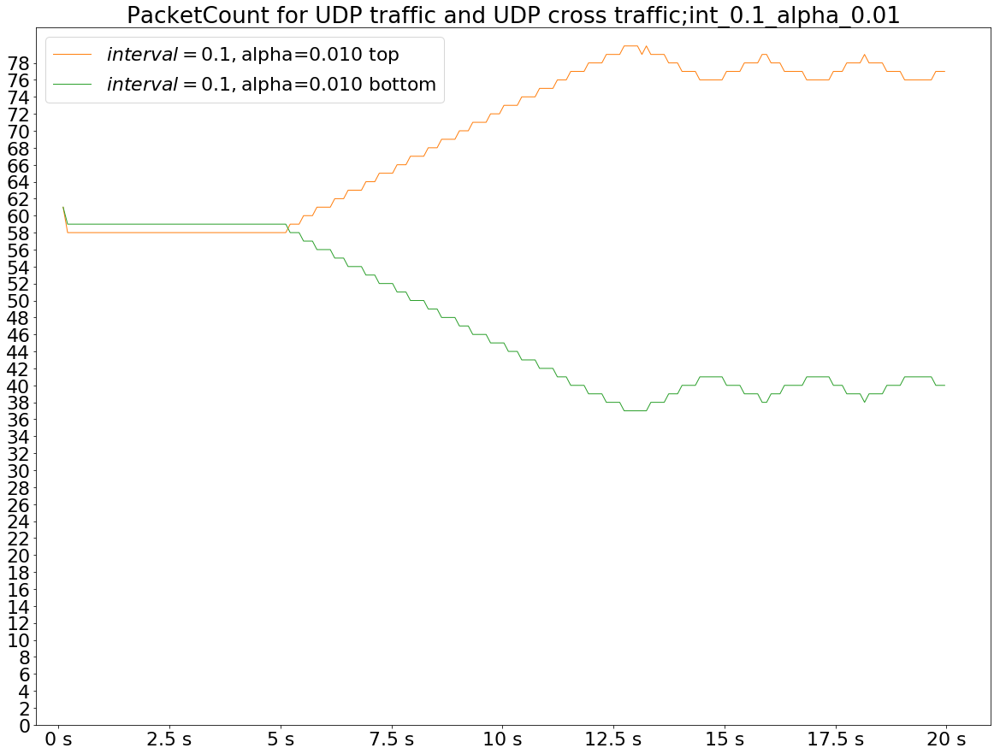

[61.]


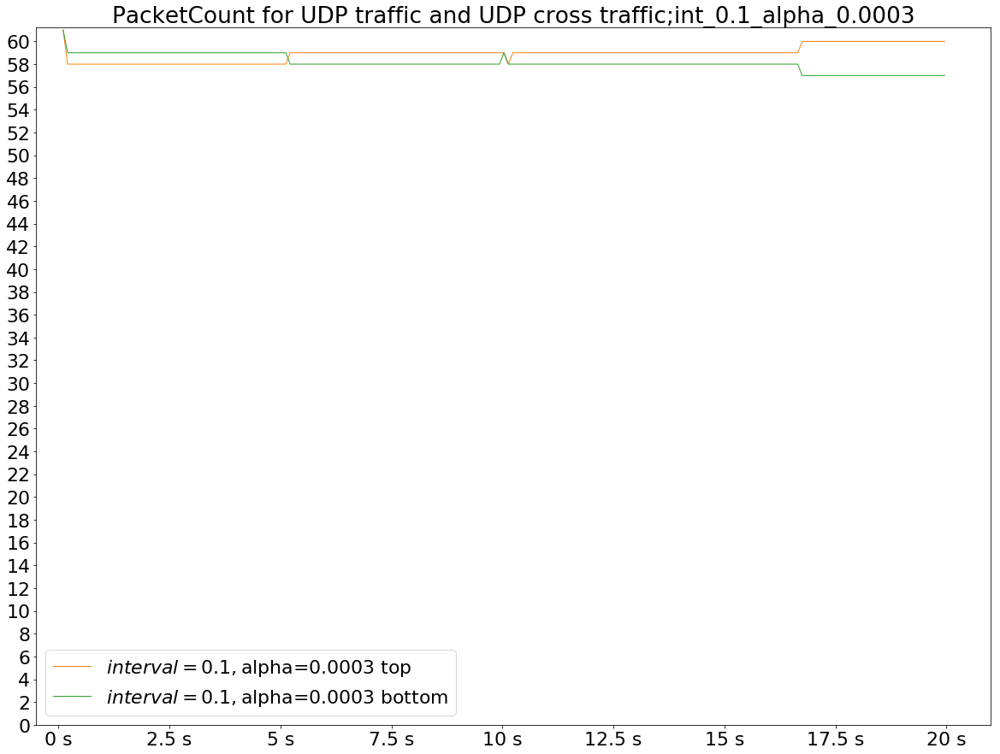

[79.]


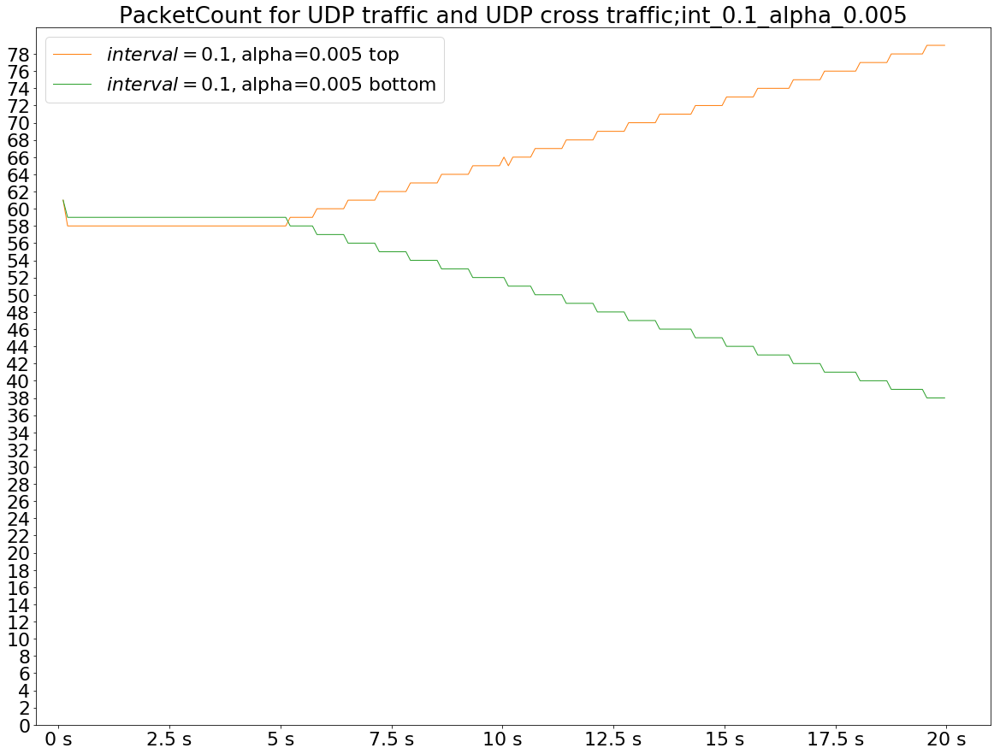

[82.]


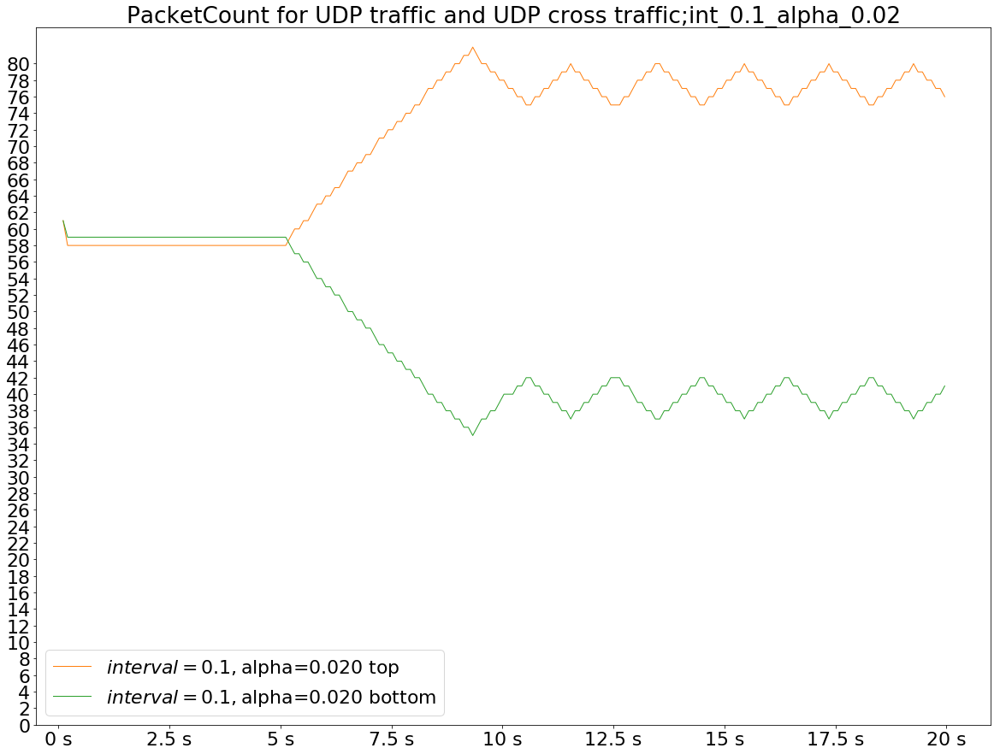

[63.]


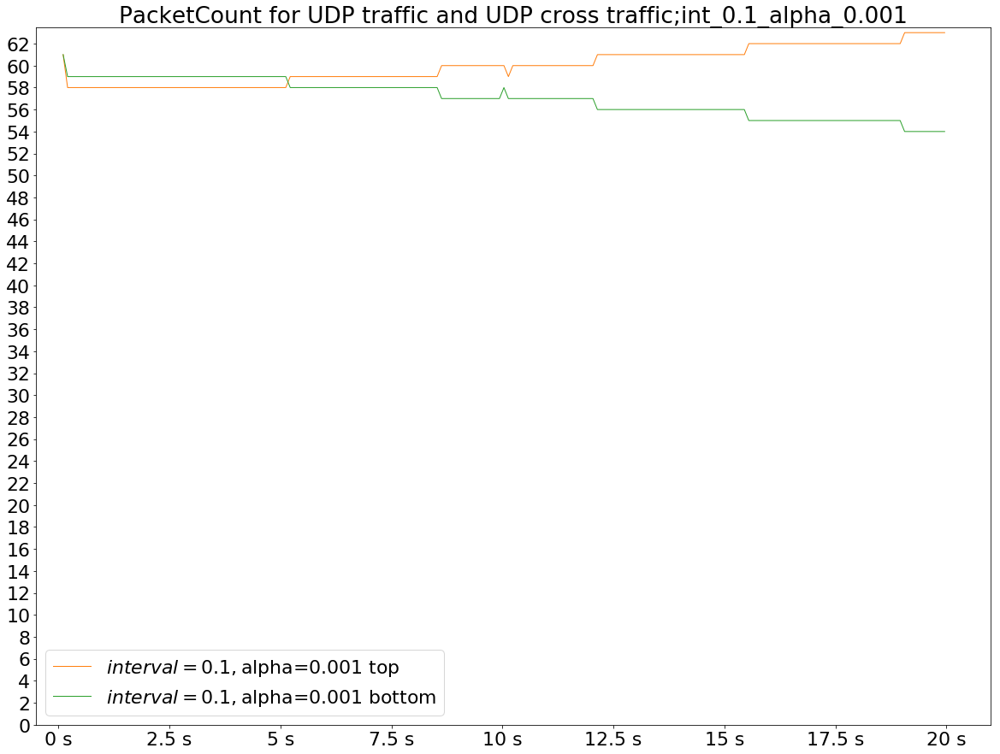

[61.]


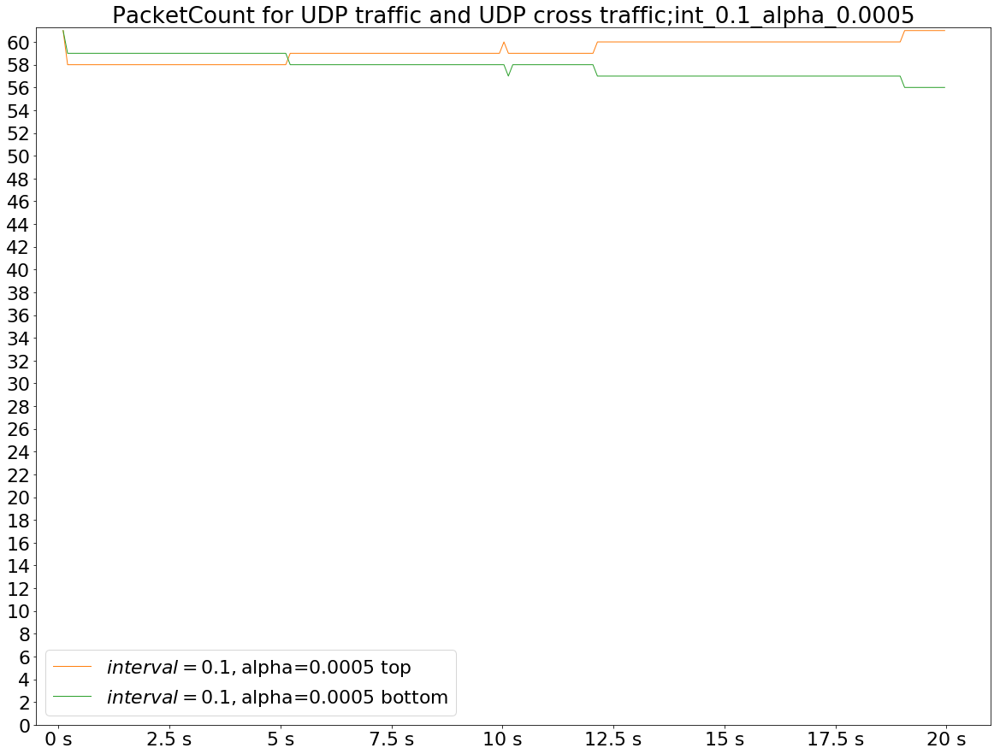

[10.]


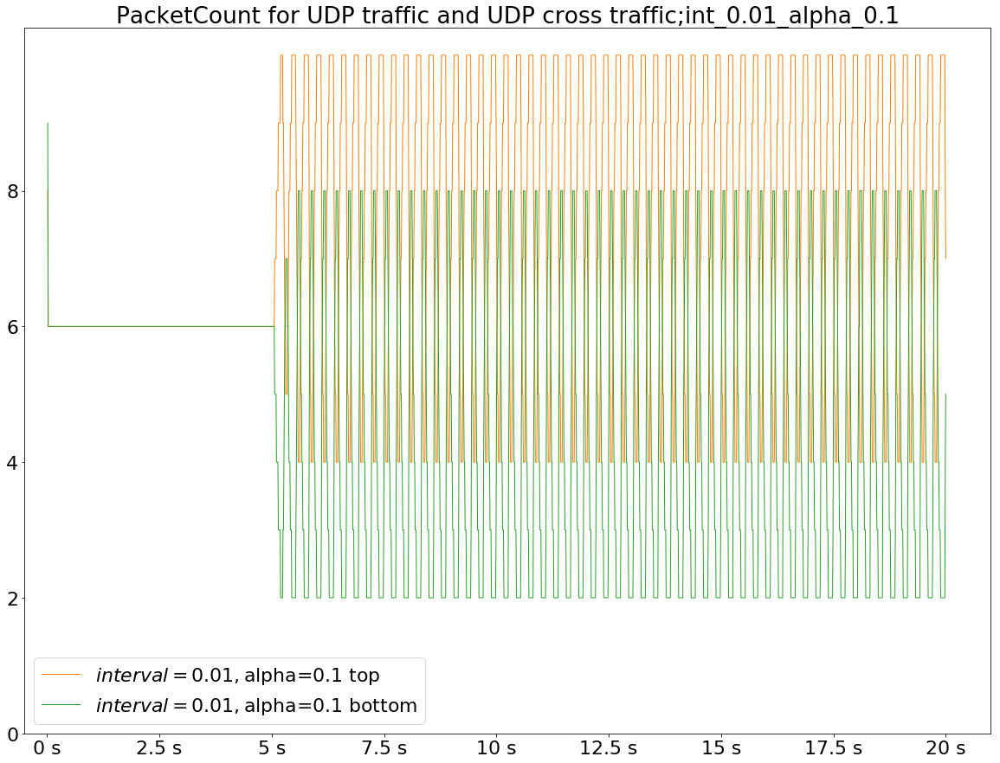

[10.]


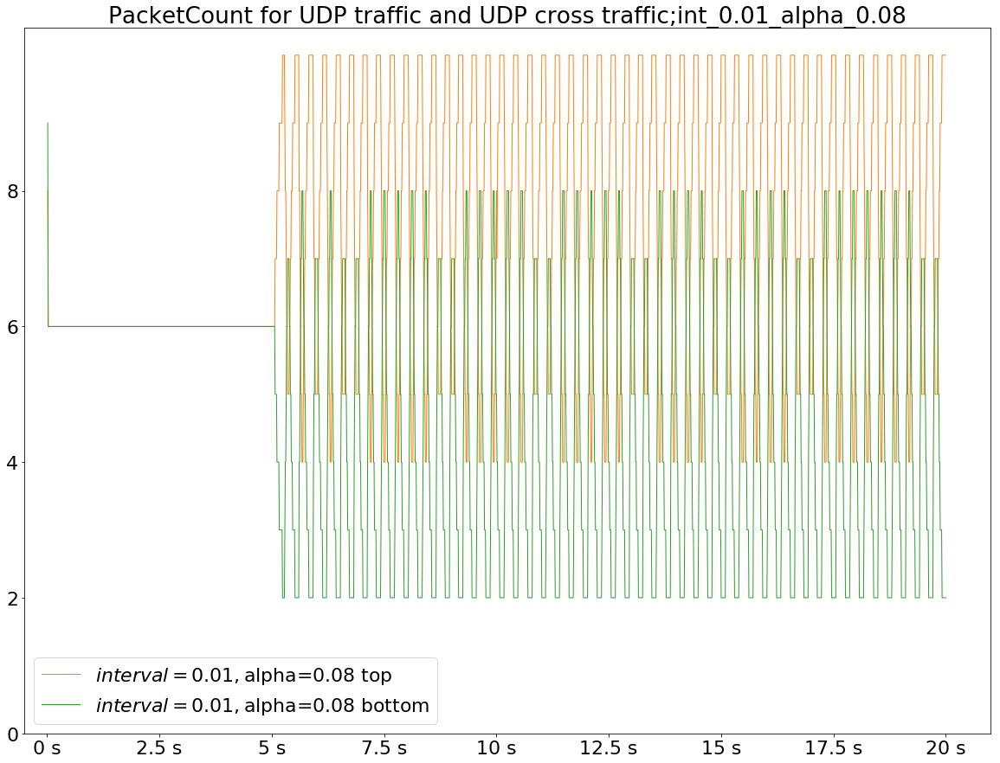

[10.]


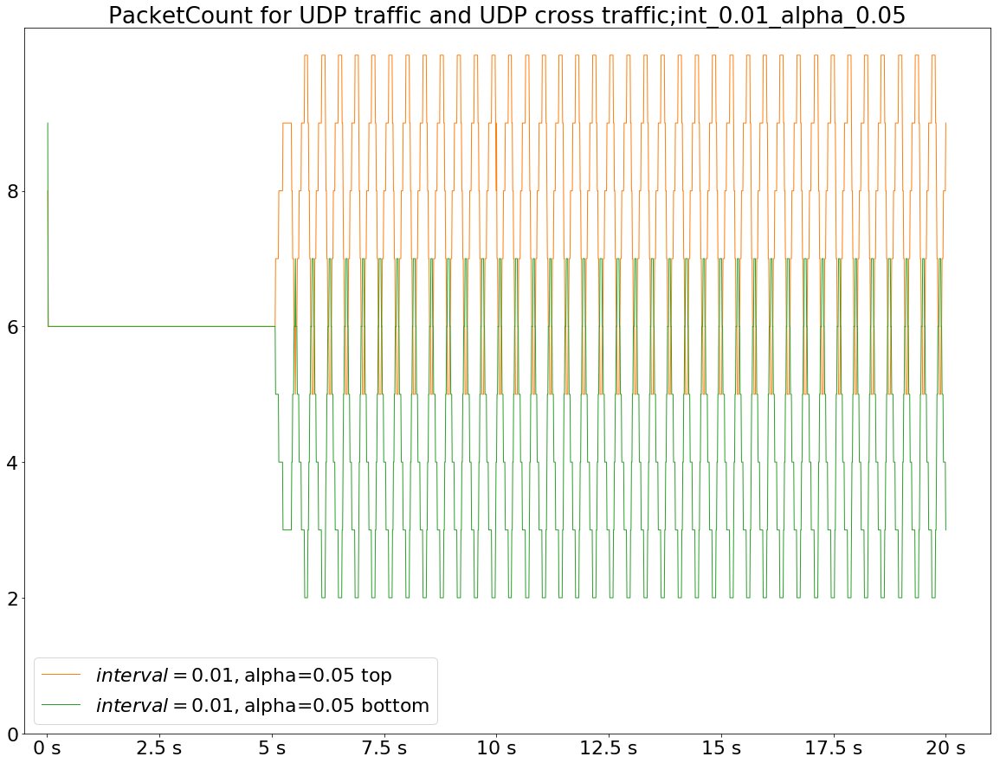

[9.]


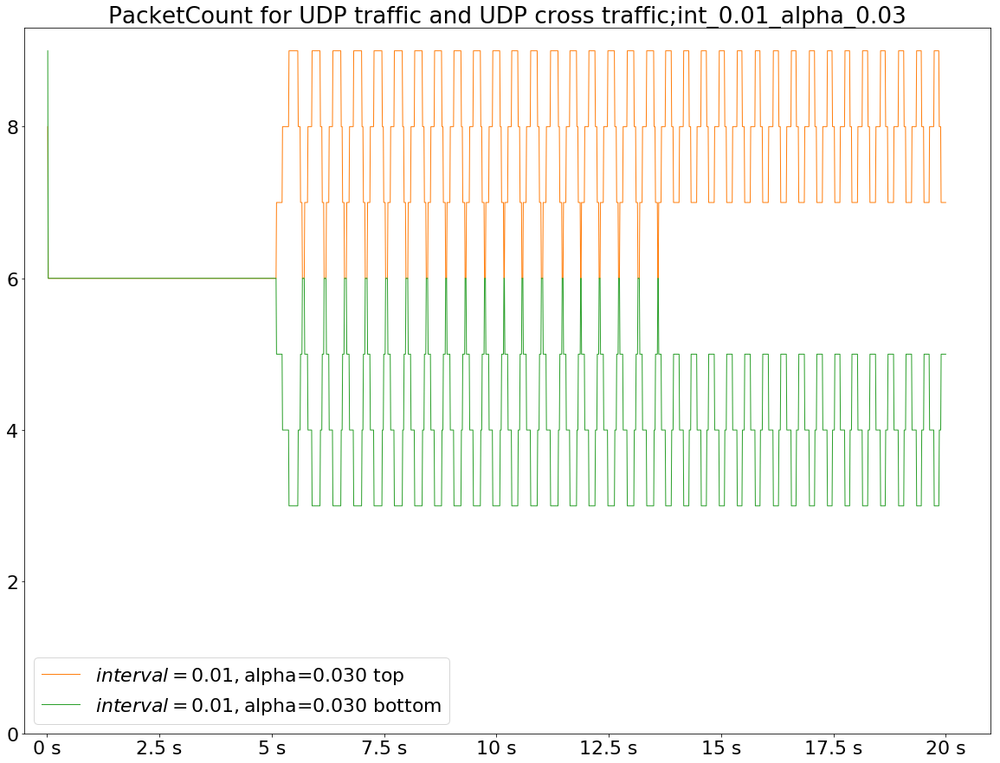

[9.]


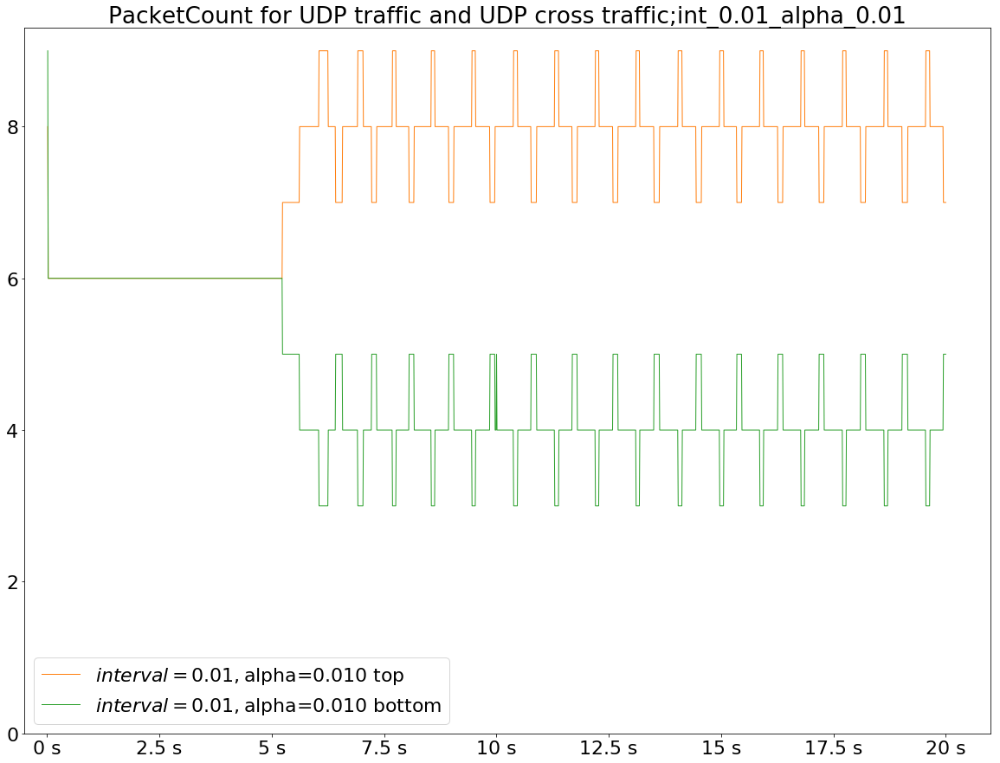

[8.]


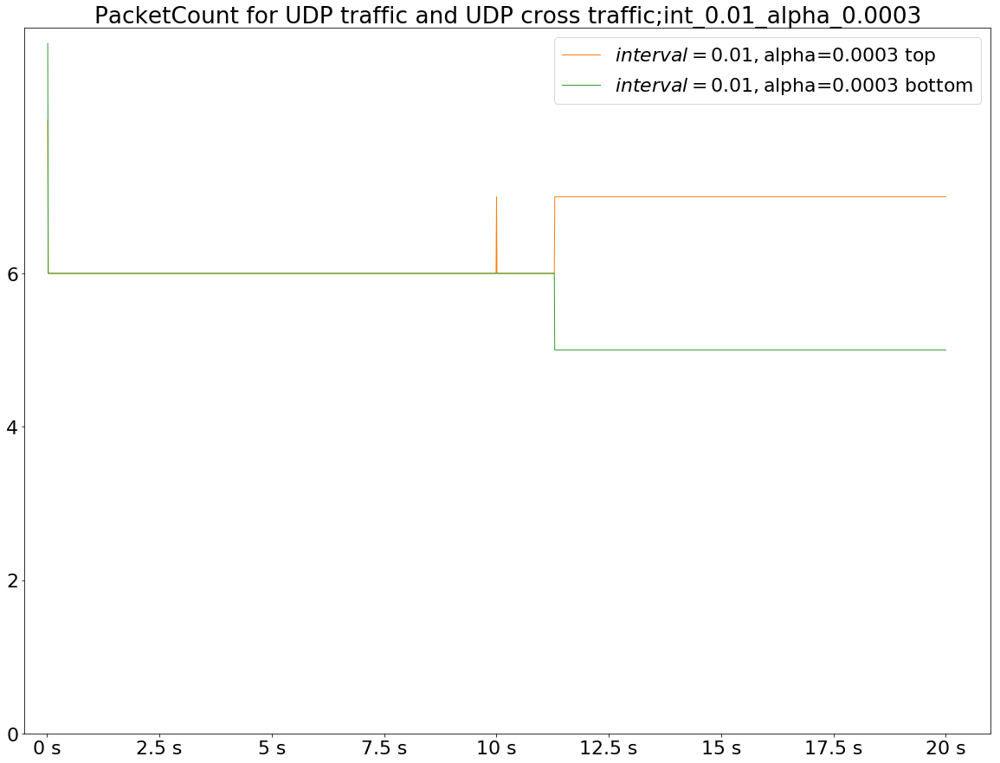

[9.]


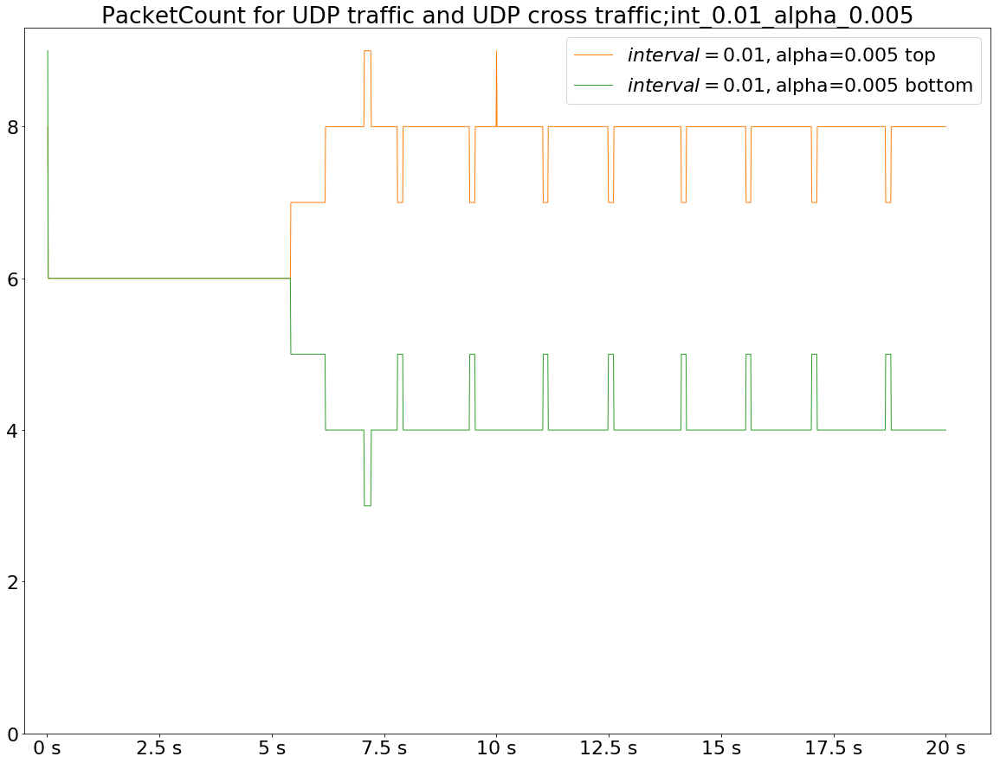

[9.]


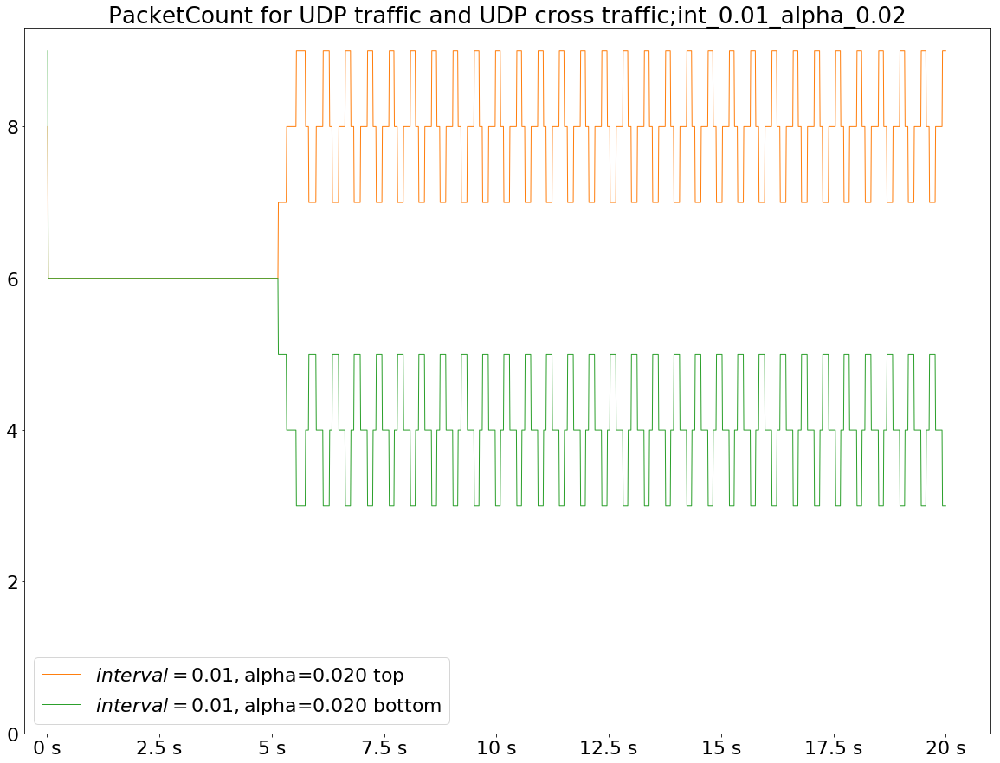

[8.]


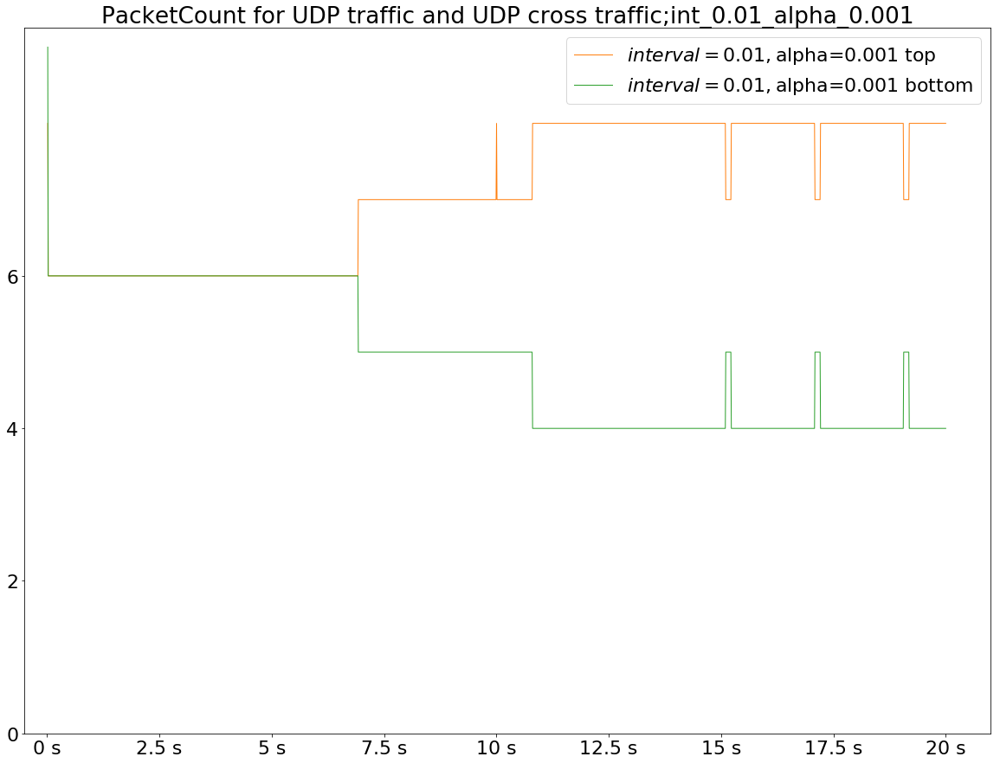

[8.]


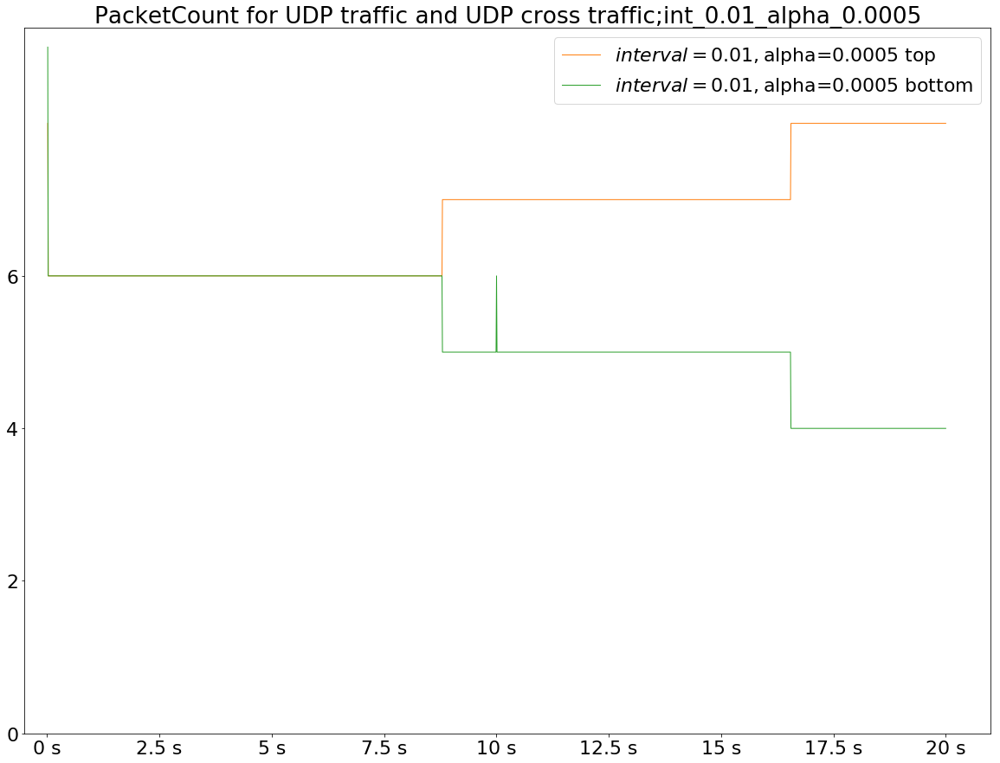

[37.]


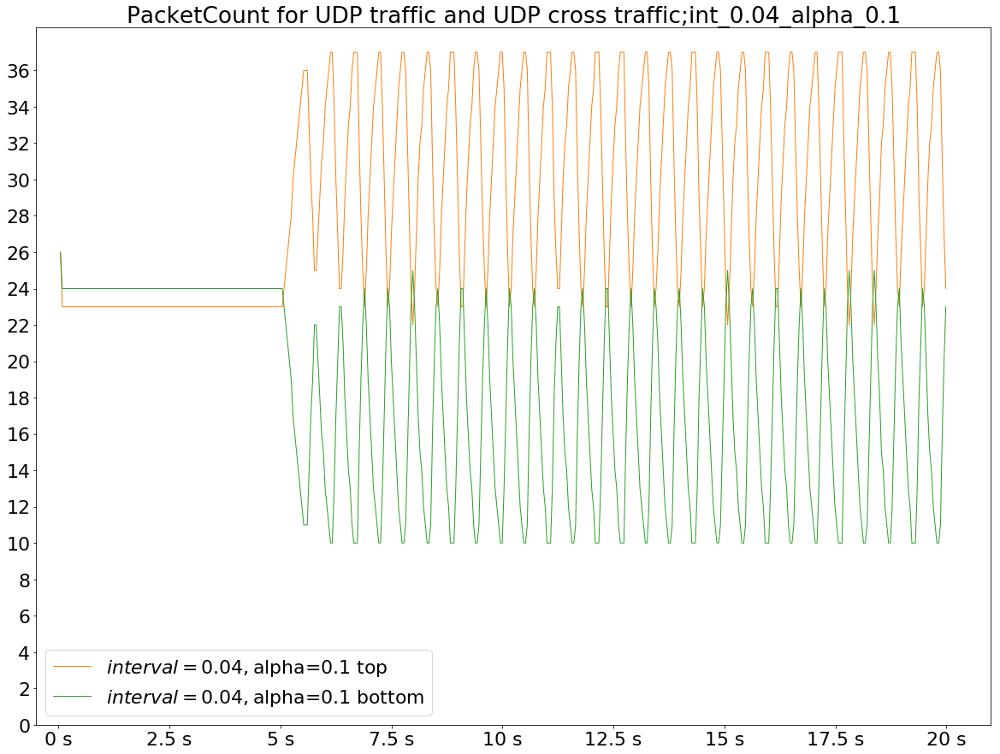

[37.]


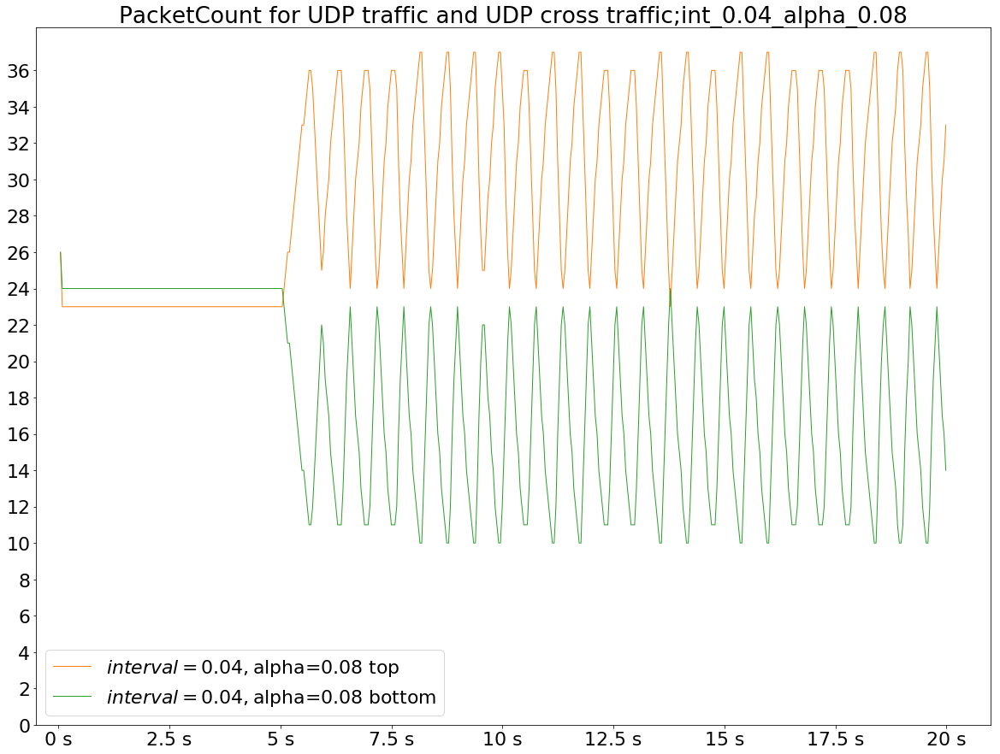

[35.]


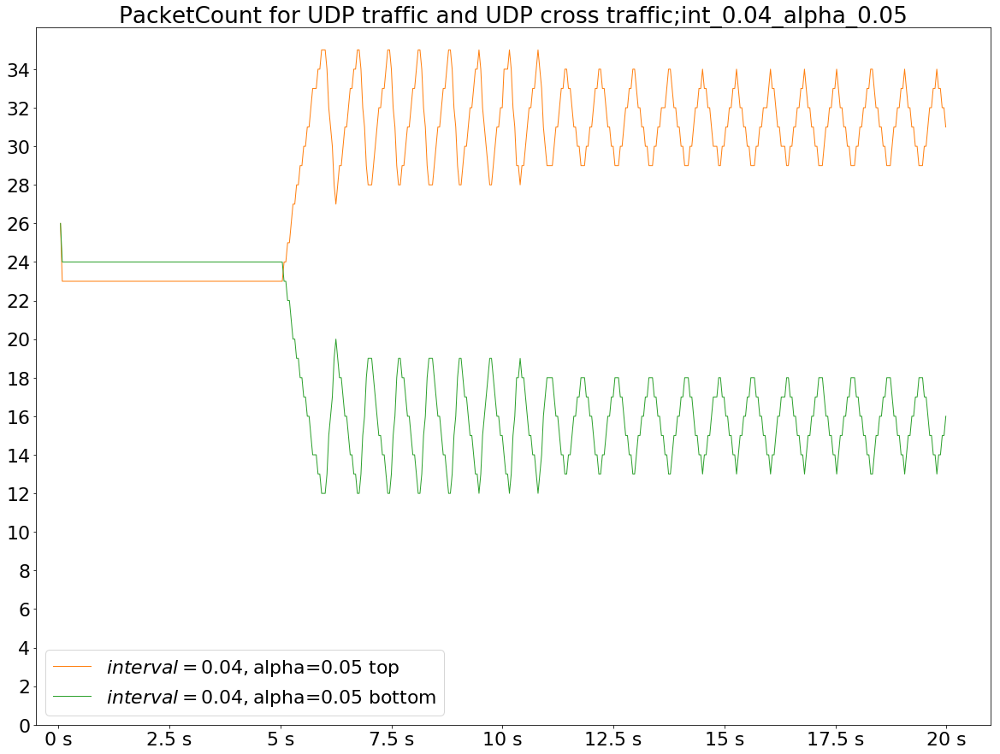

[34.]


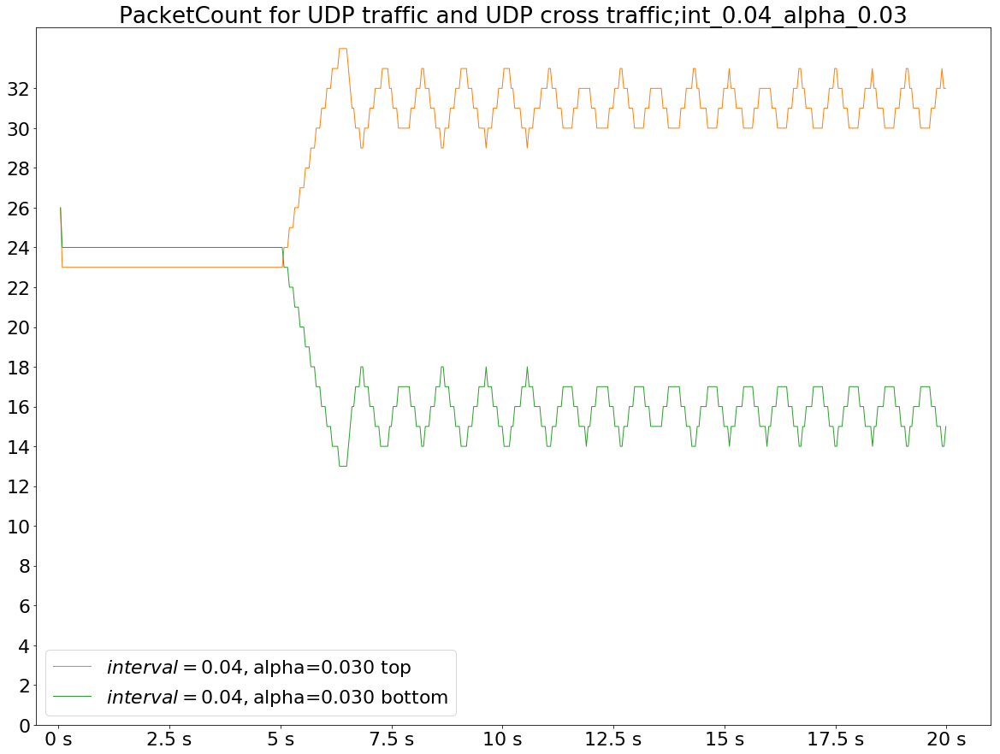

[33.]


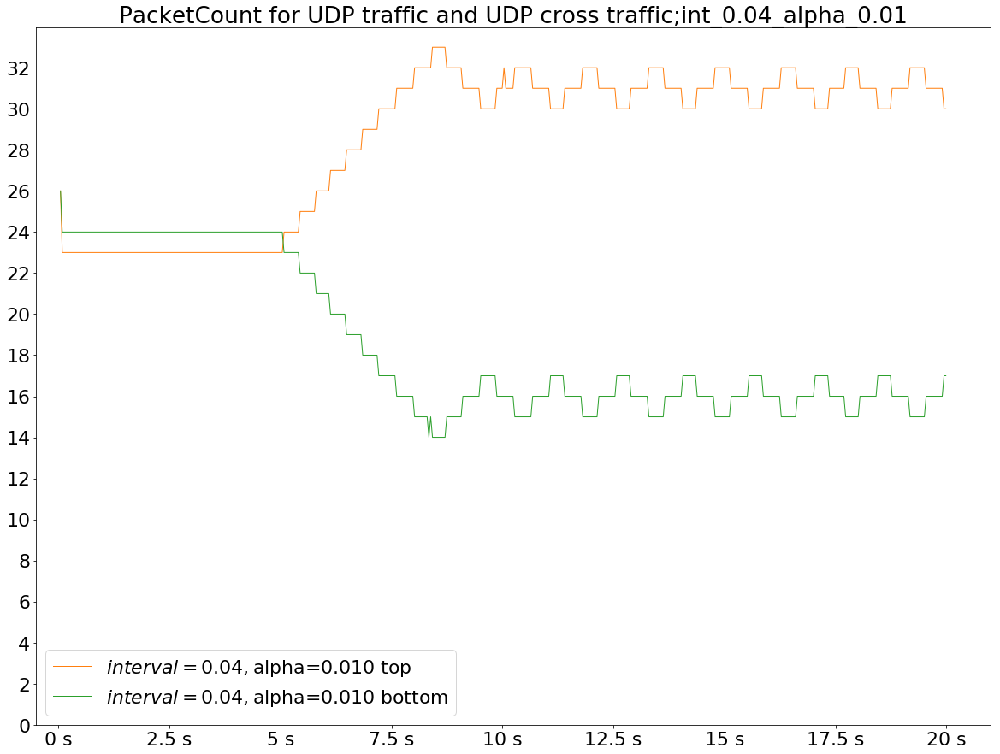

[26.]


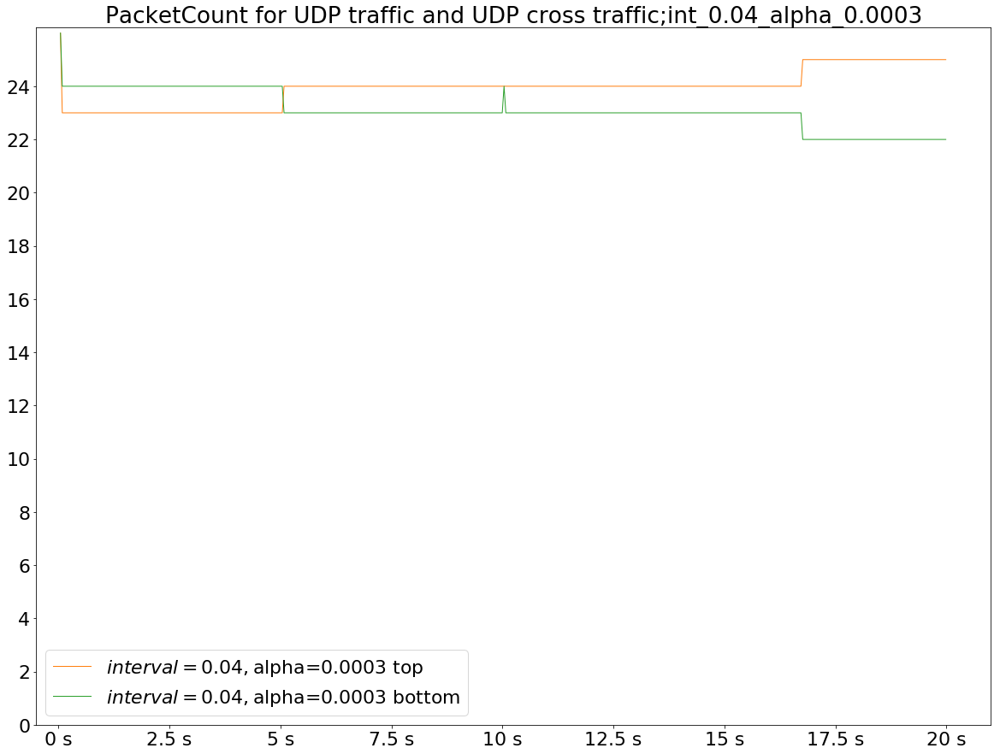

[32.]


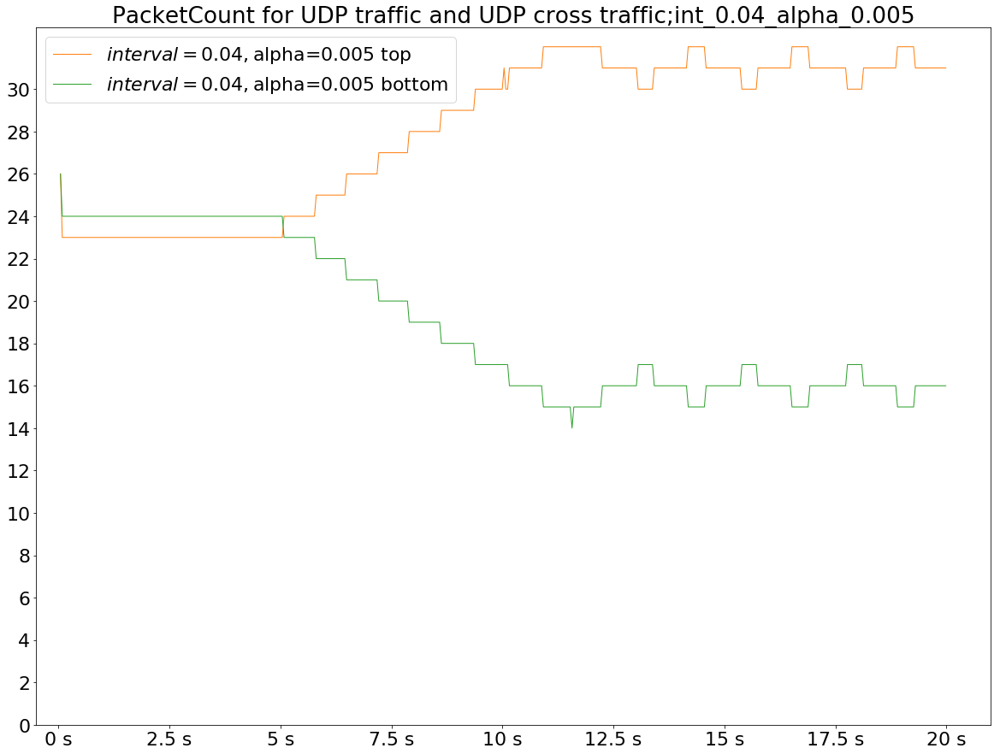

[52.]


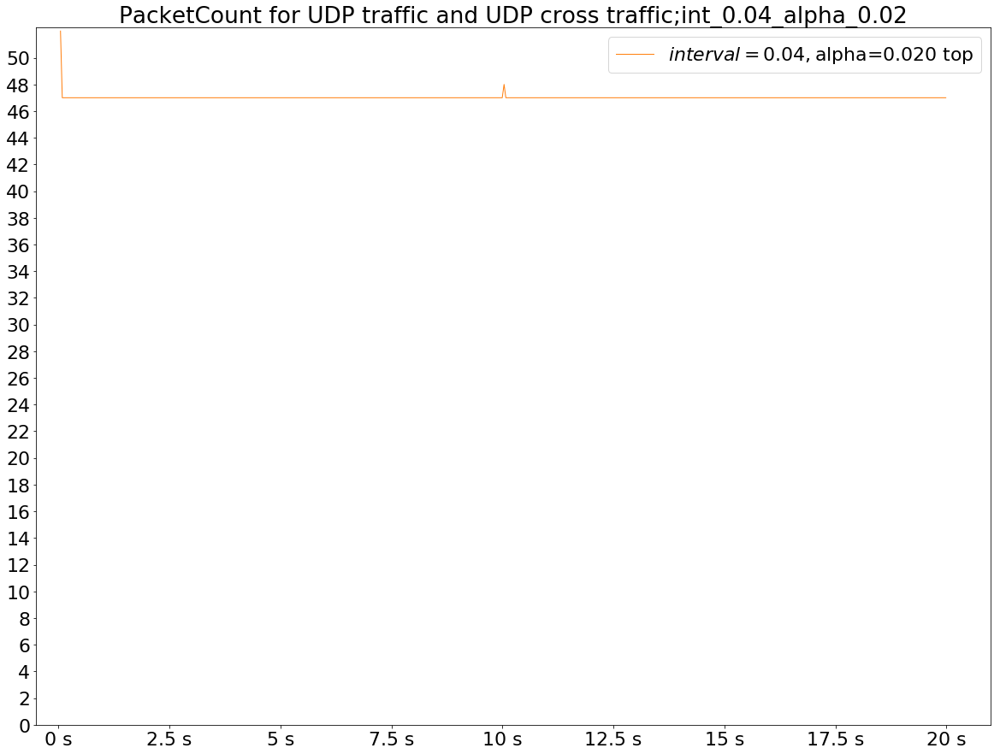

[28.]


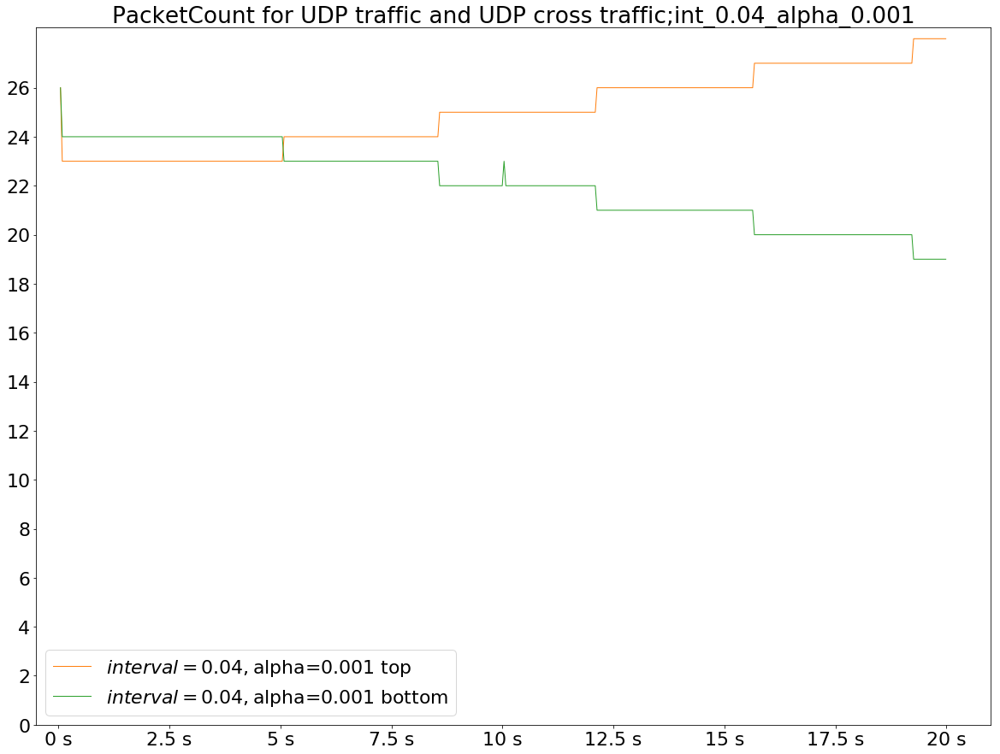

[52.]


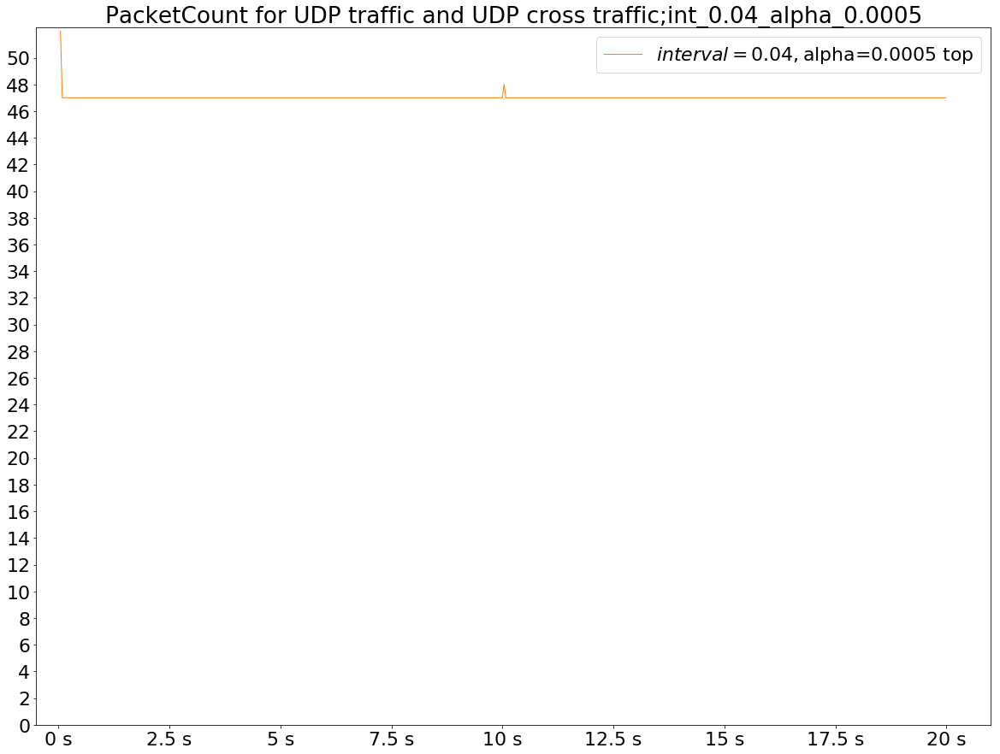

[5.]


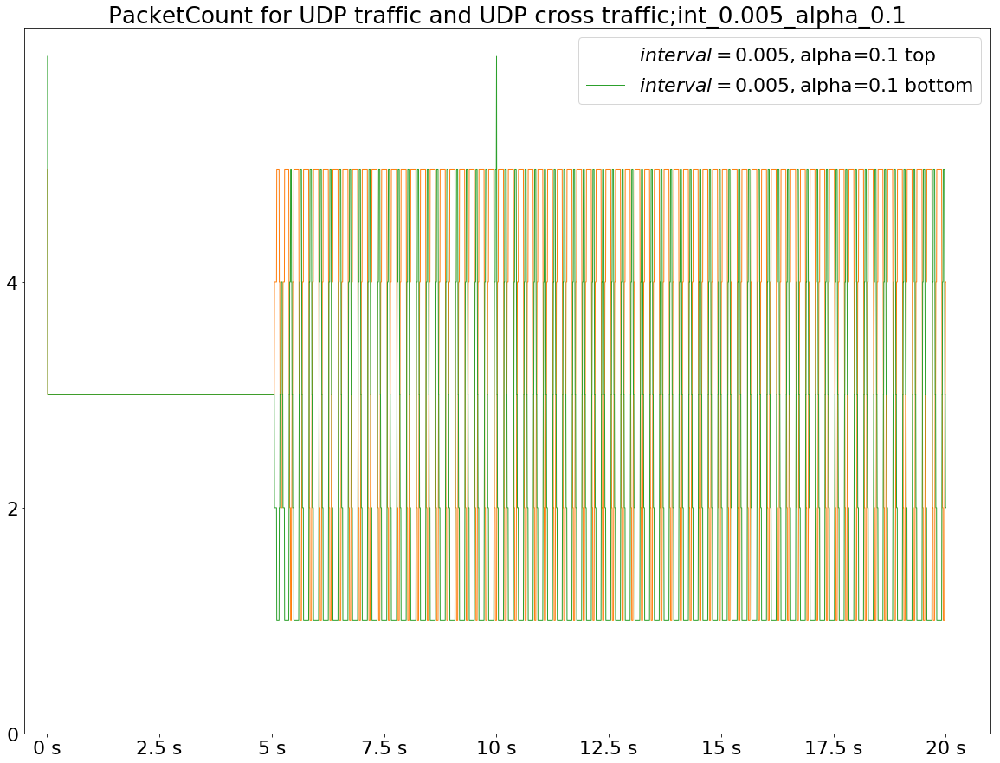

[5.]


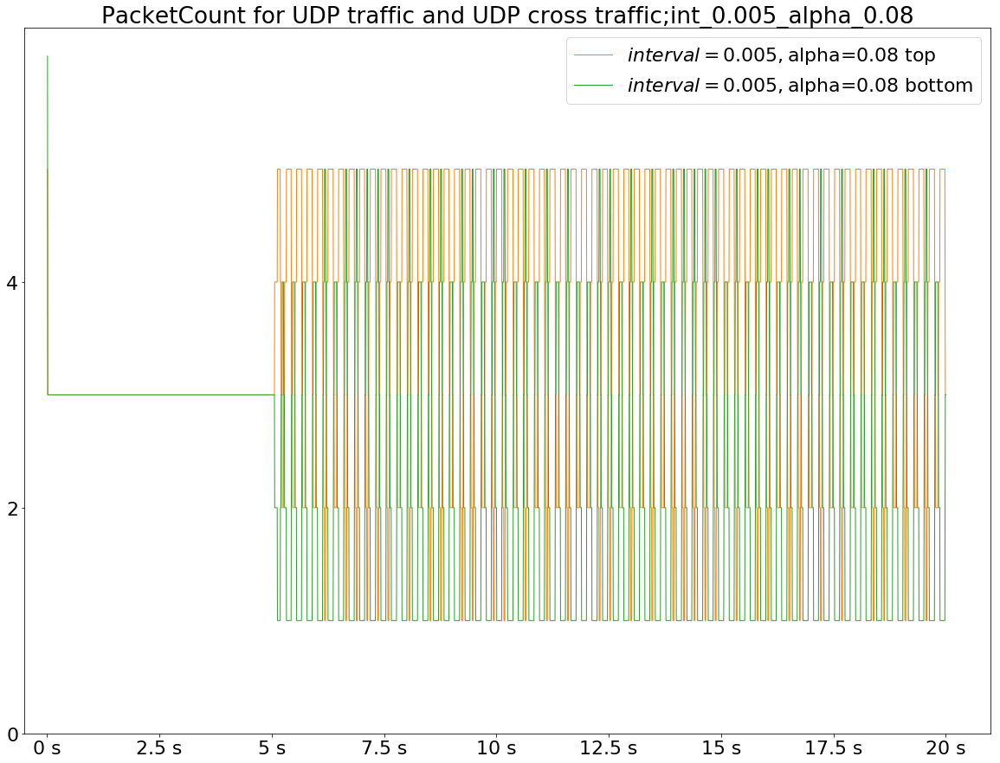

[6.]


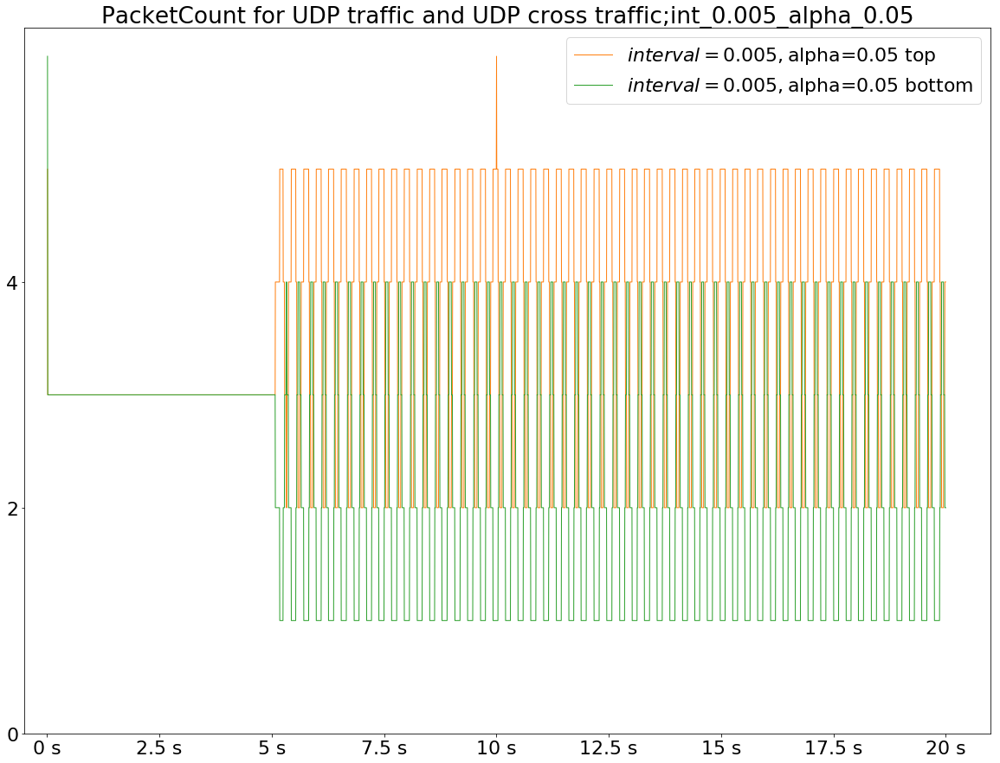

[5.]


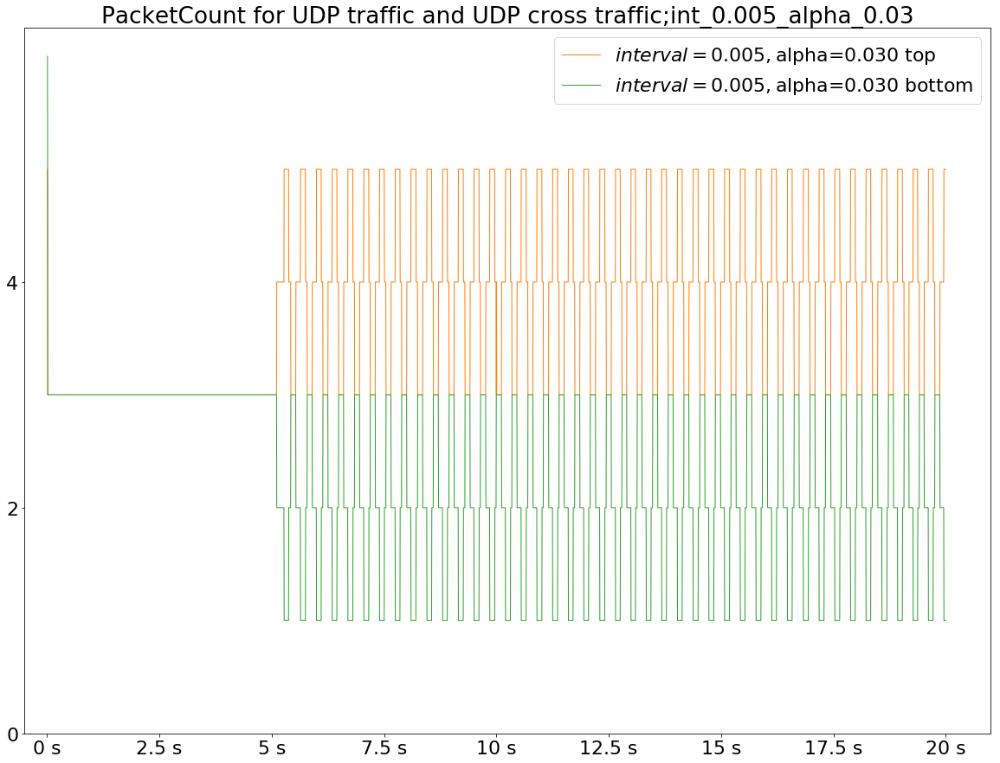

[5.]


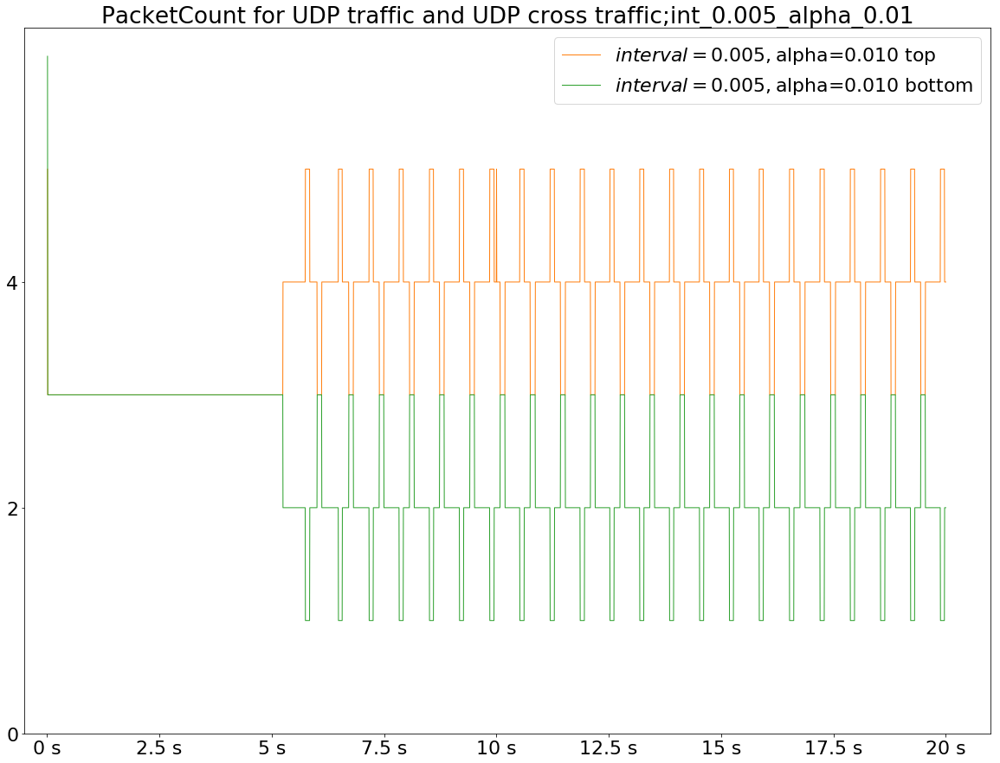

[5.]


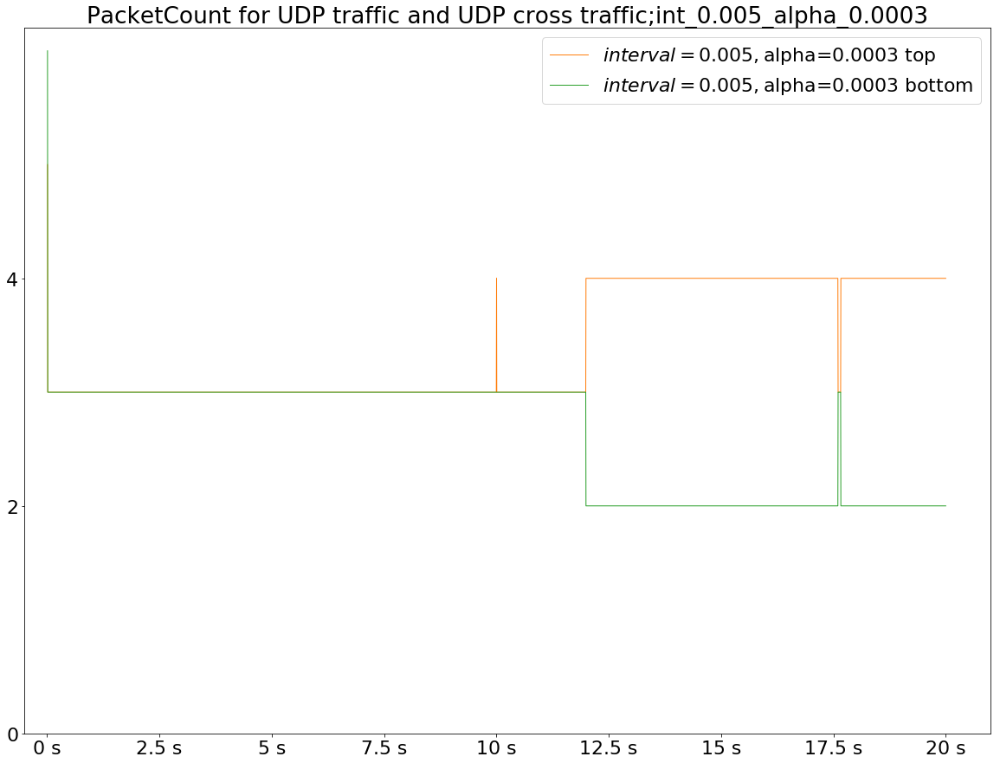

[5.]


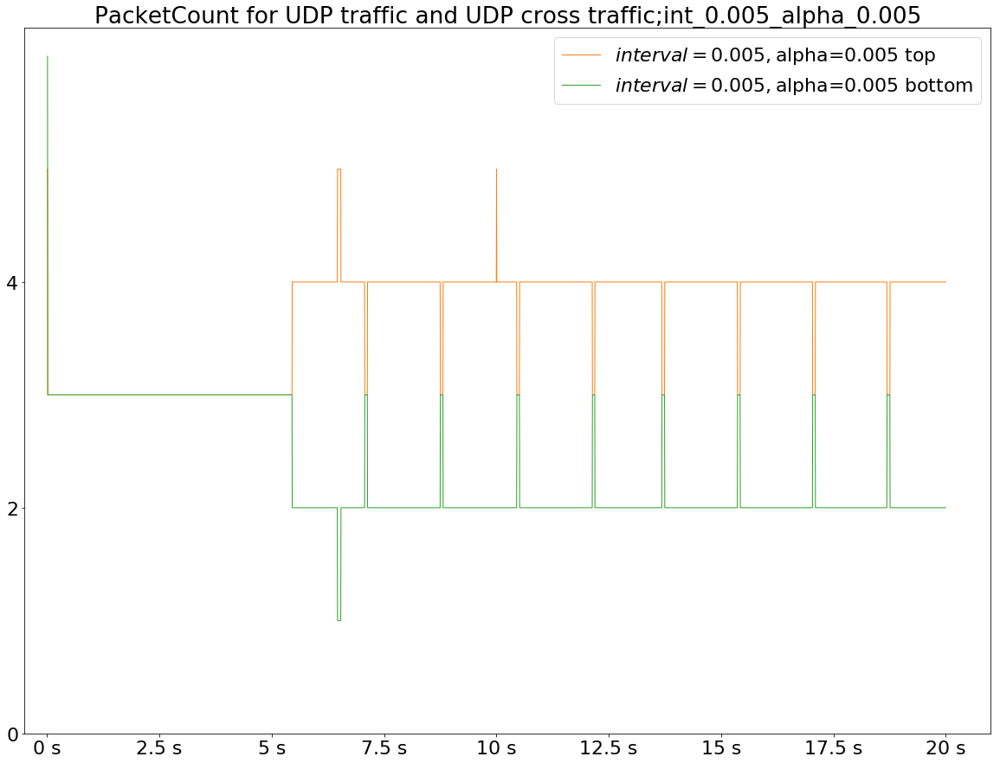

[5.]


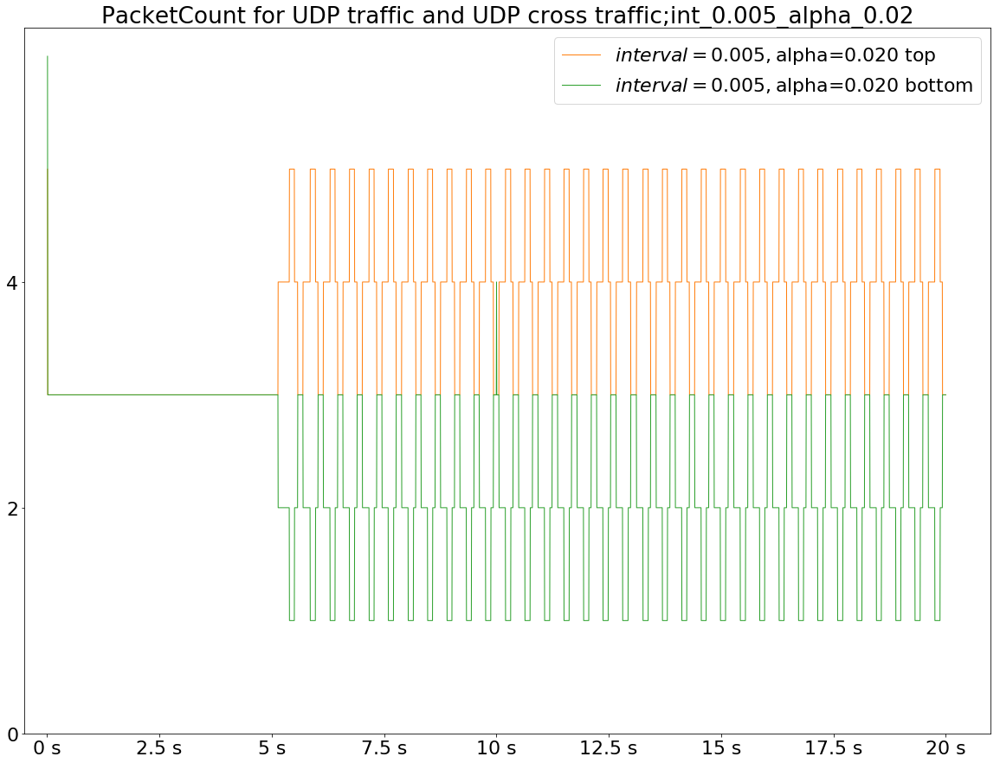

[5.]


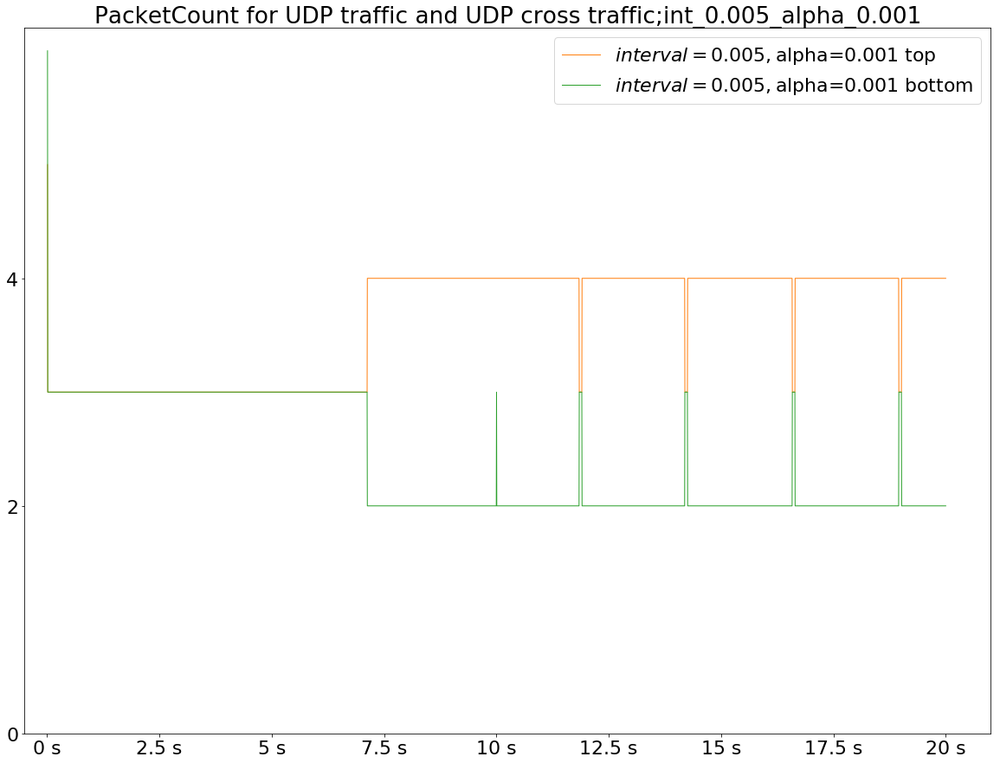

[5.]


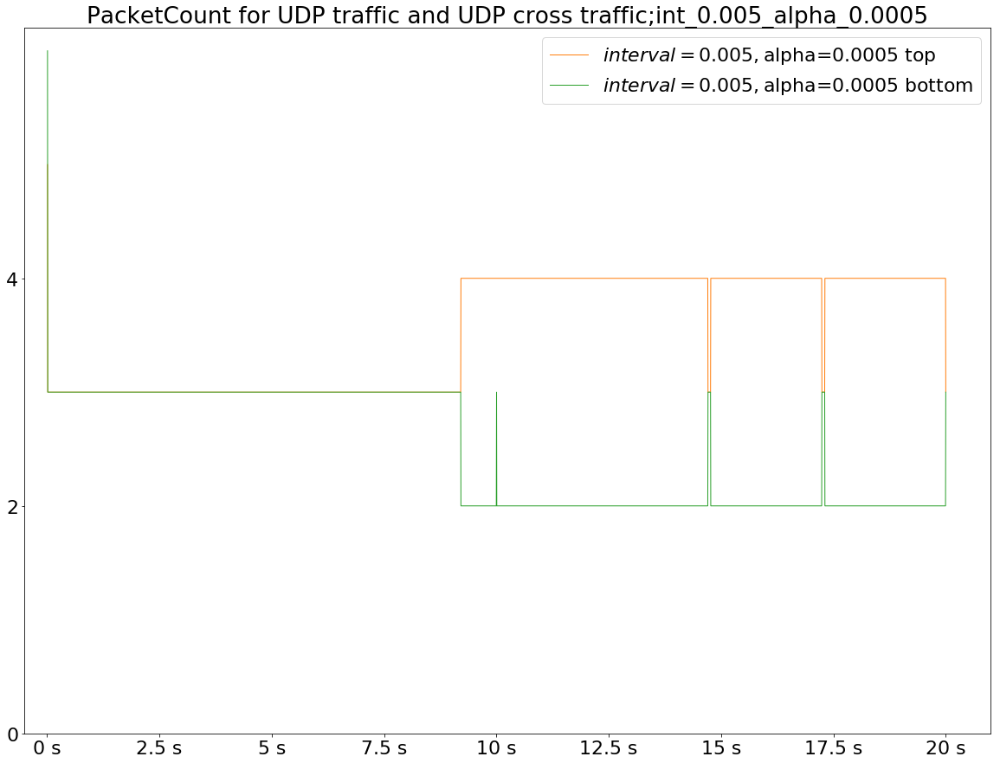

[20.]


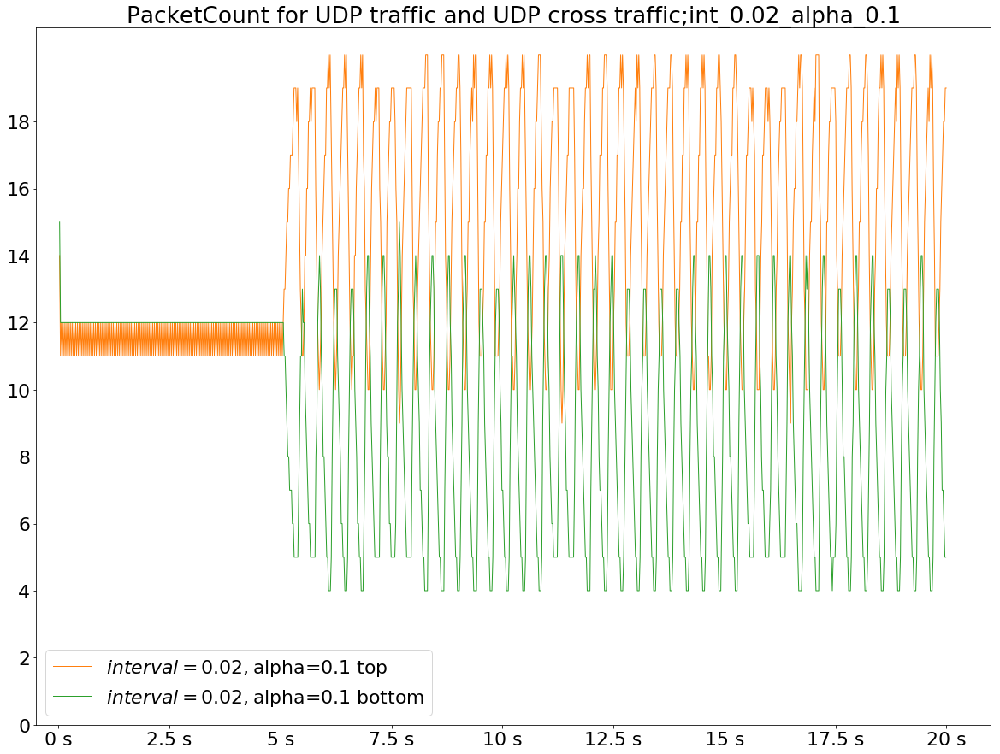

[20.]


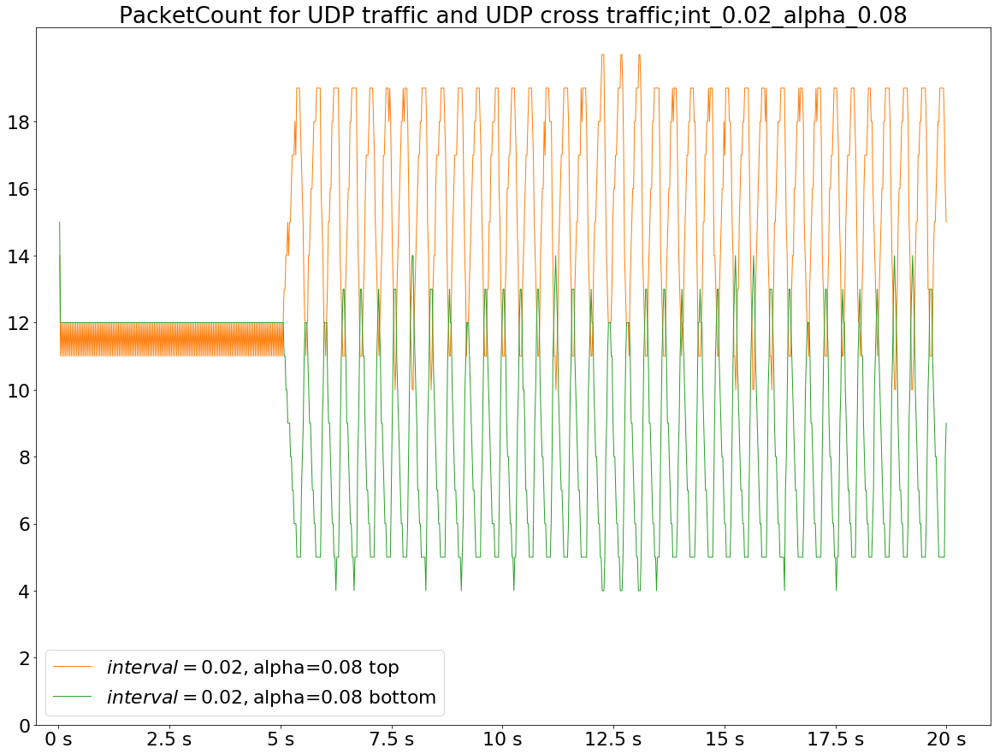

[19.]


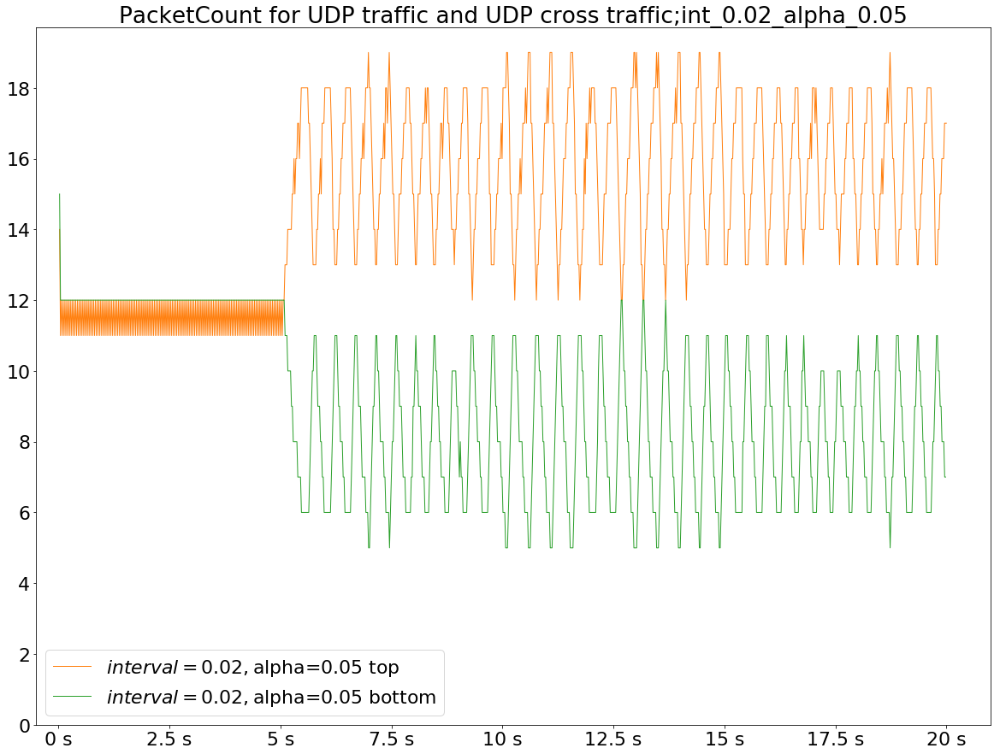

[18.]


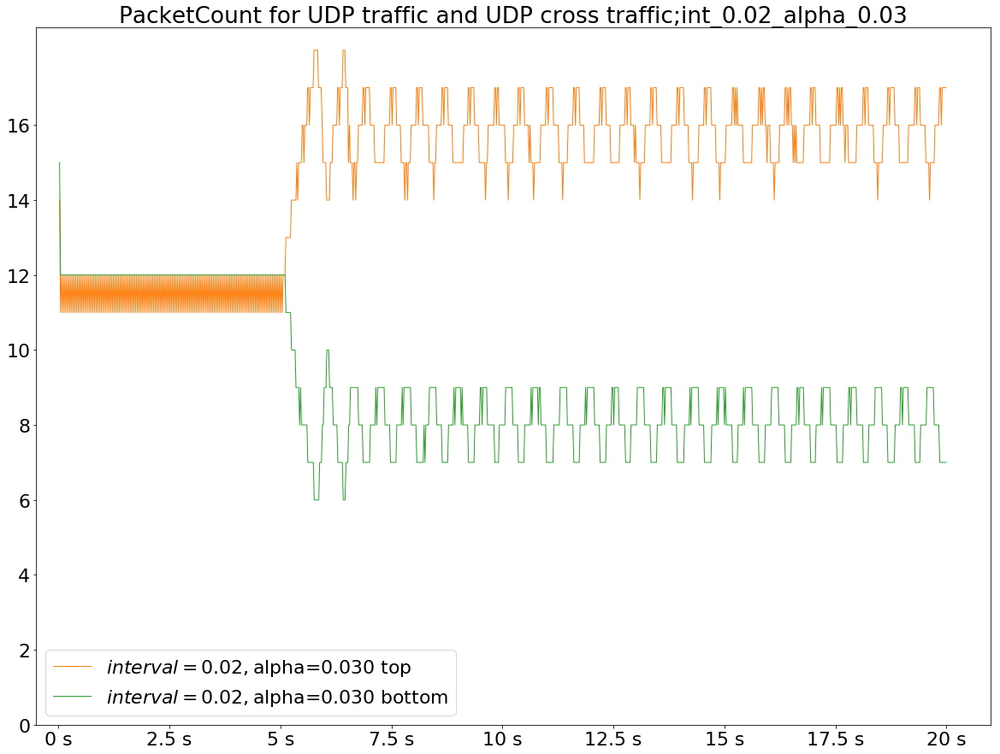

[17.]


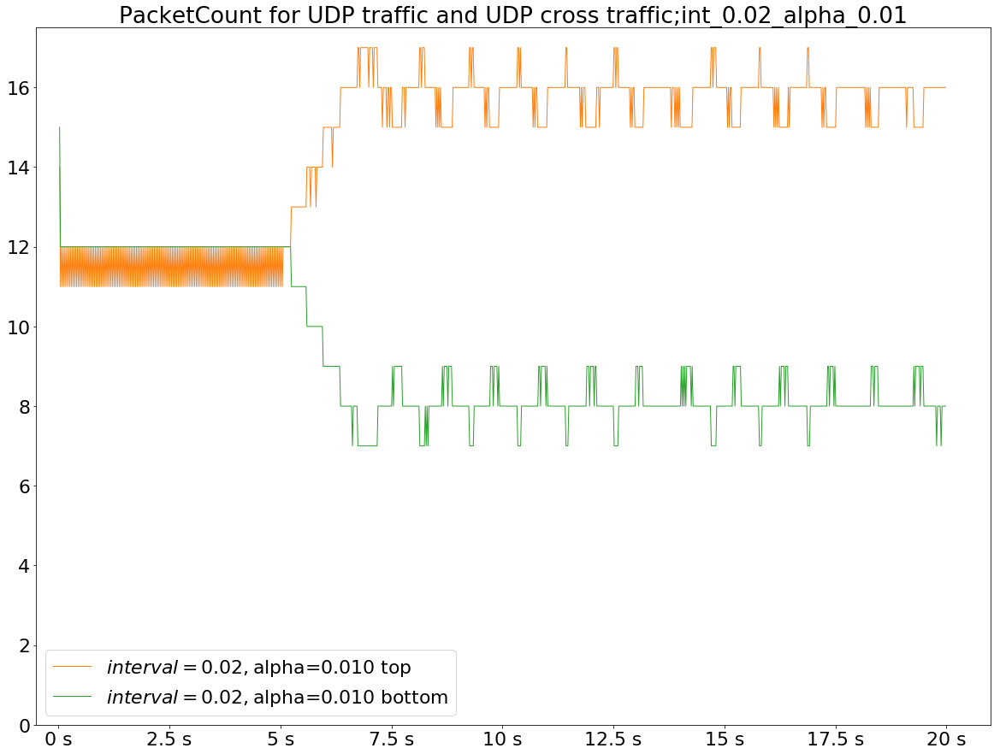

[14.]


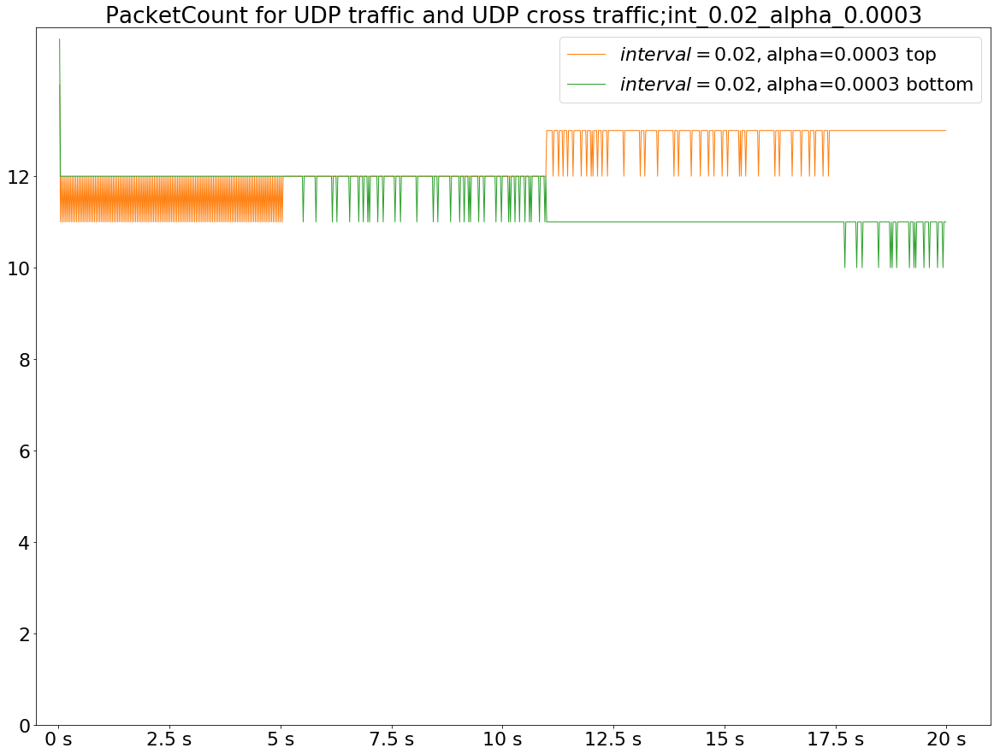

[17.]


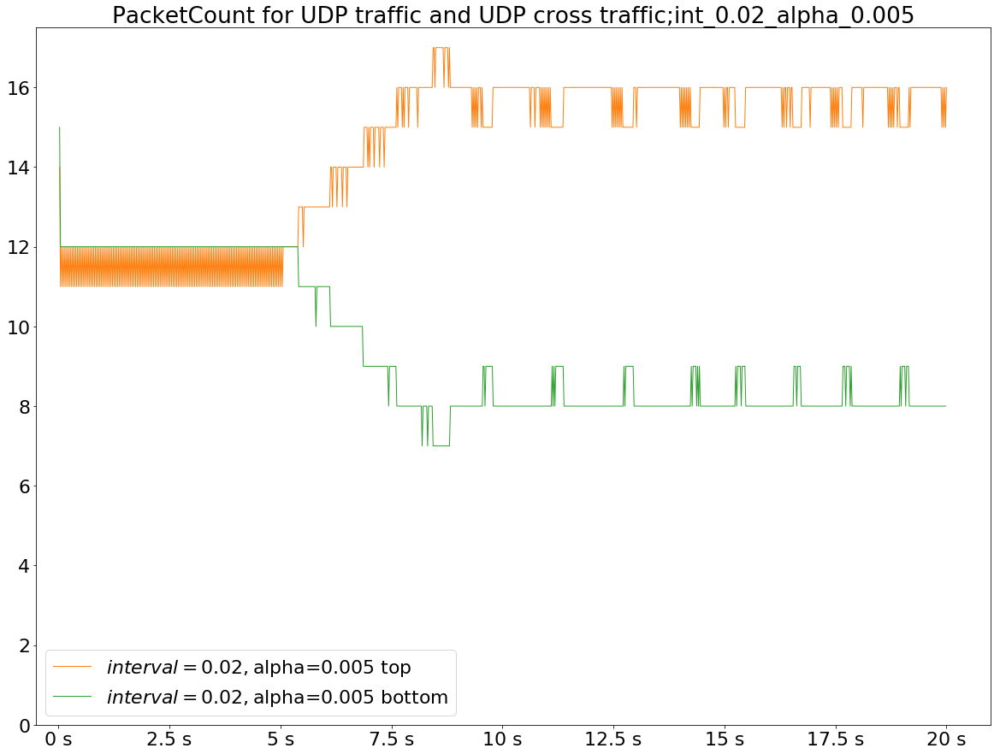

[18.]


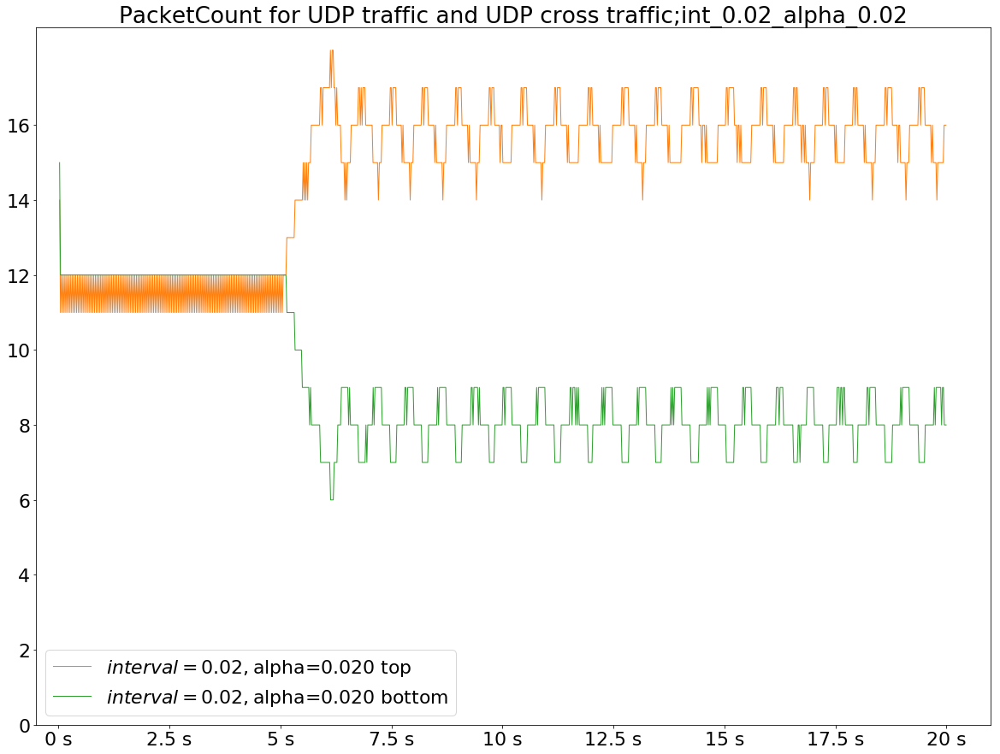

[16.]


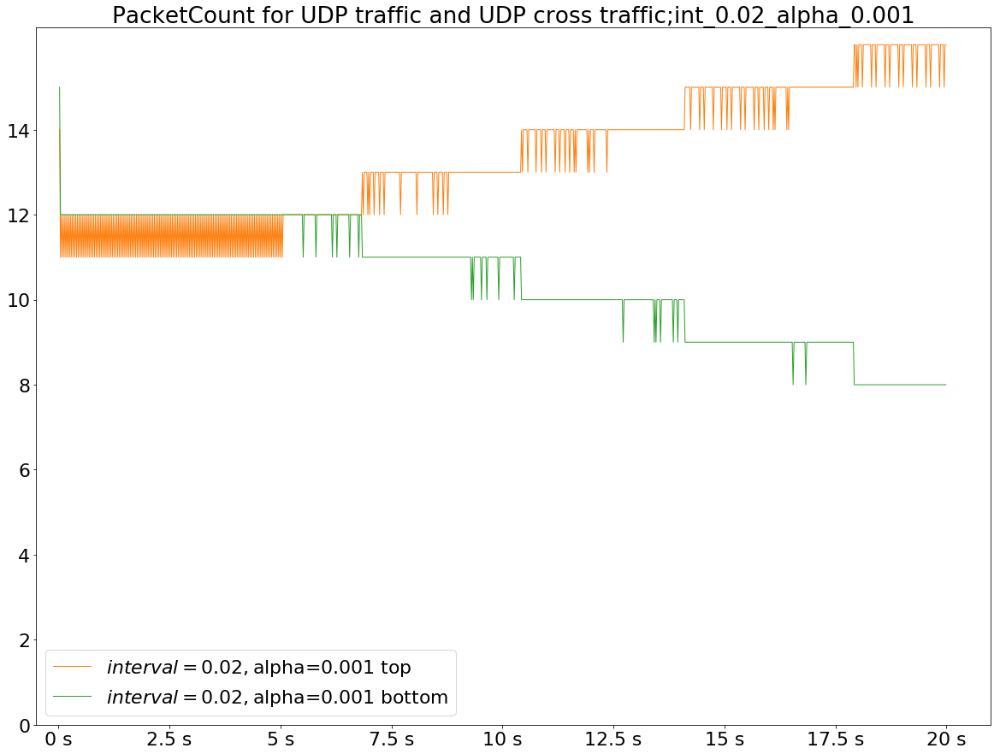

[14.]


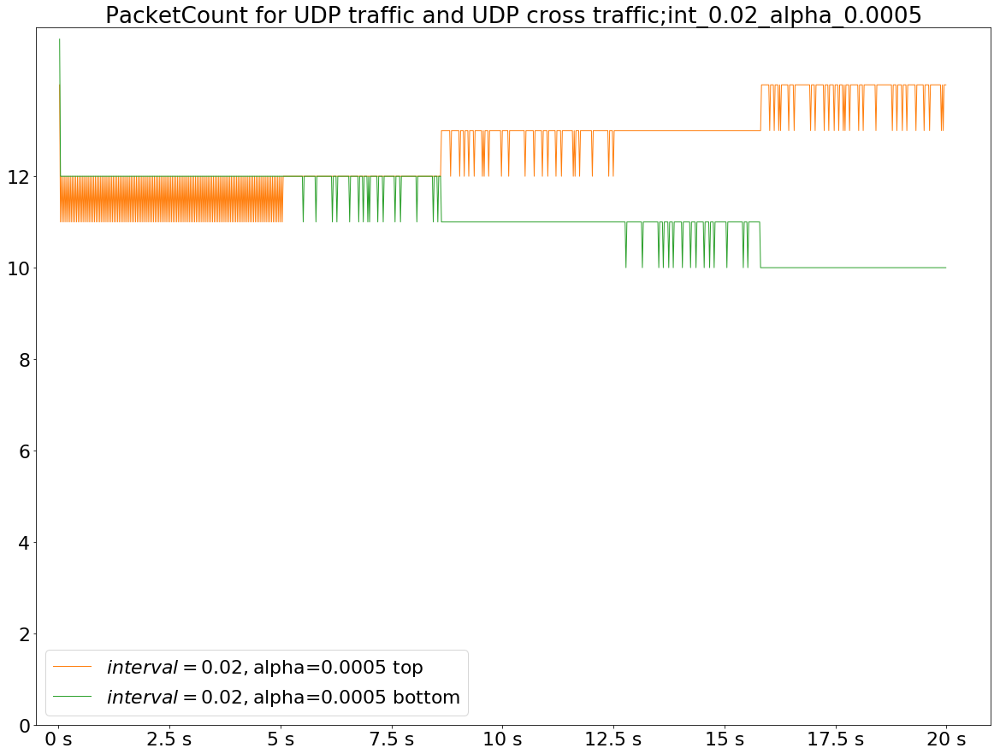

[3.]


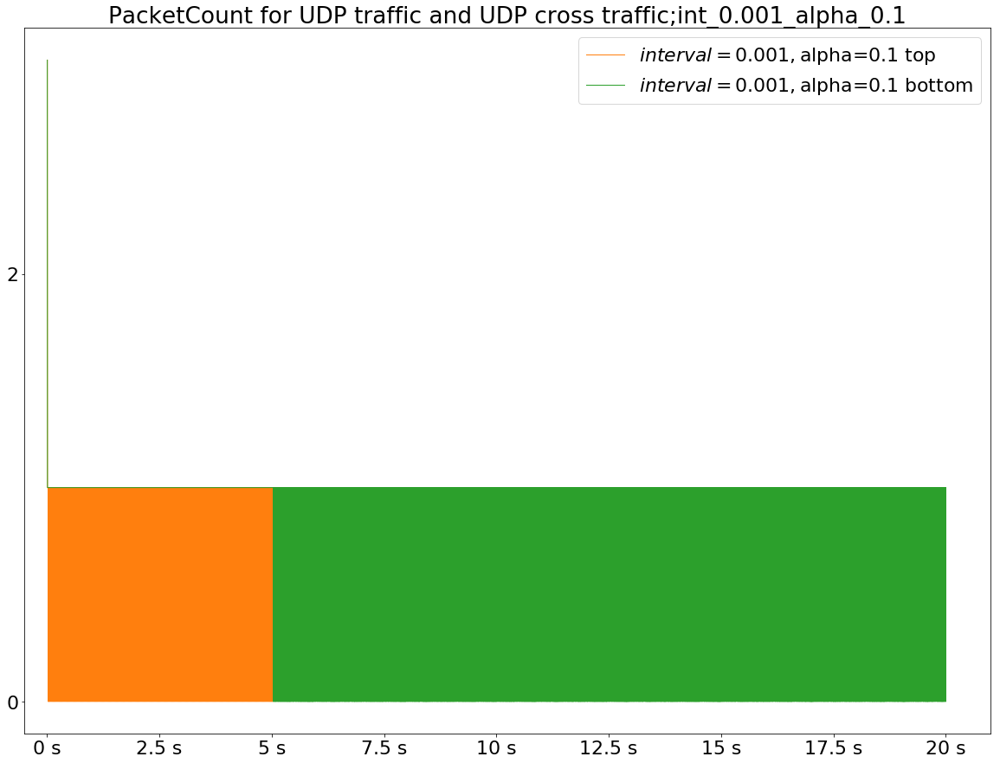

[3.]


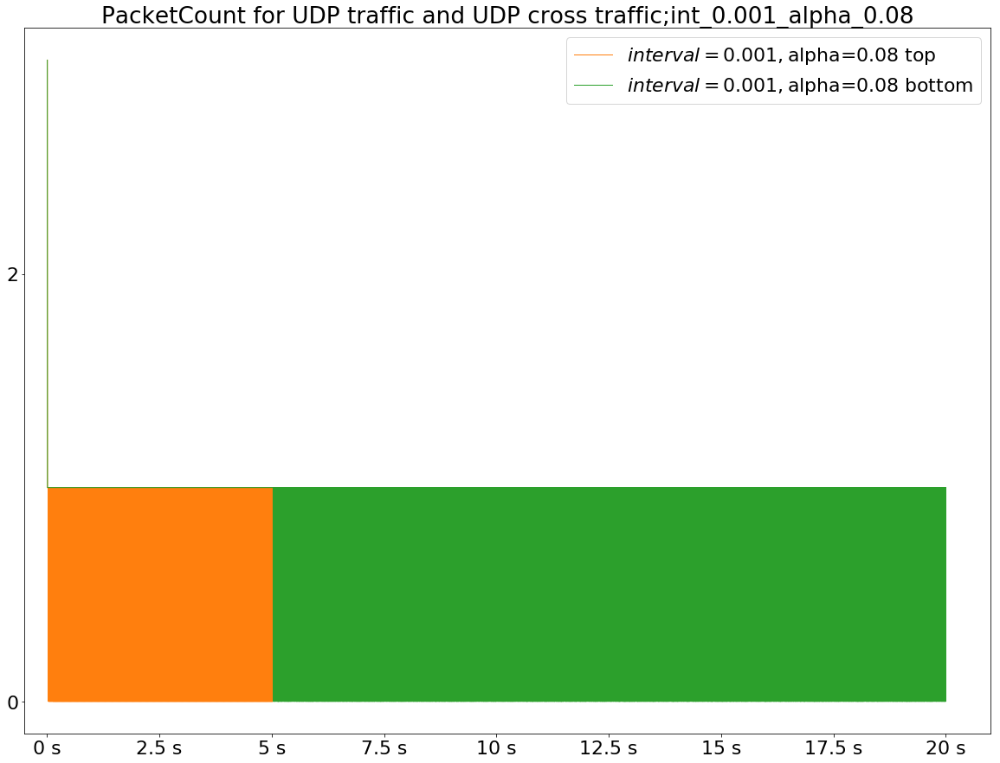

[3.]


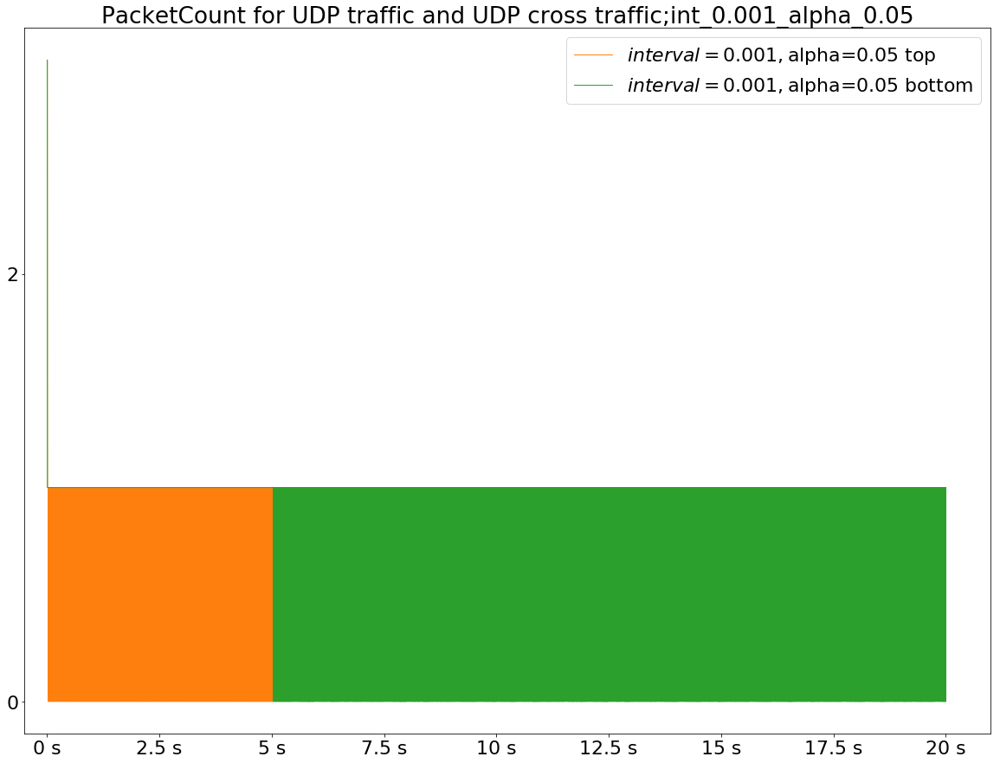

[3.]


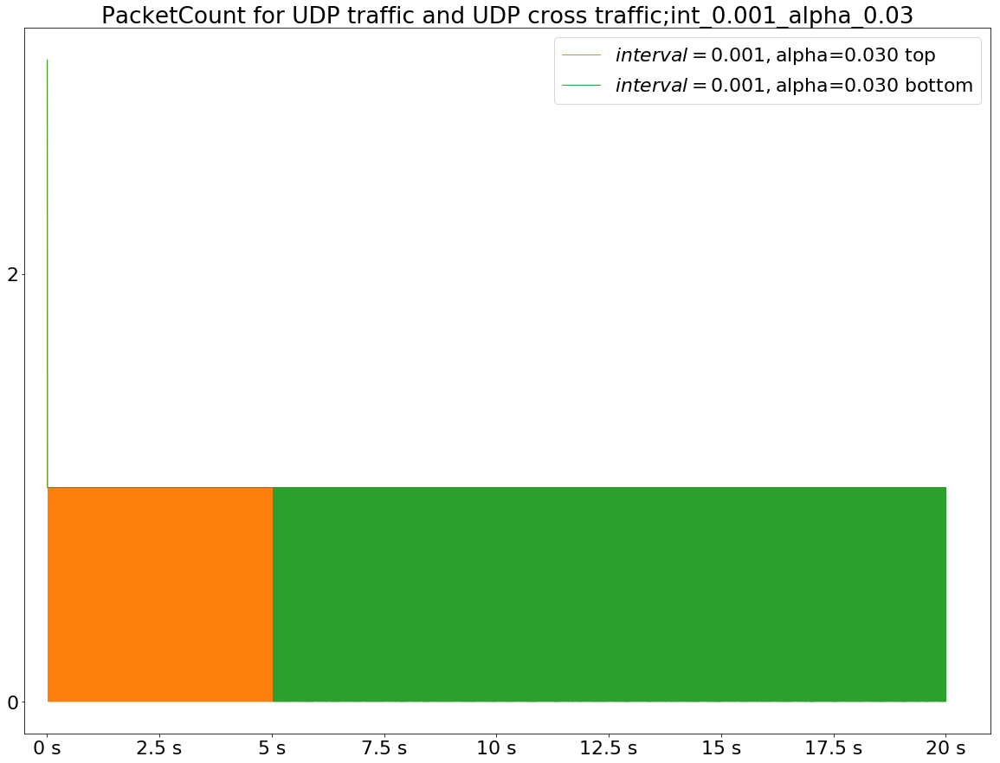

[3.]


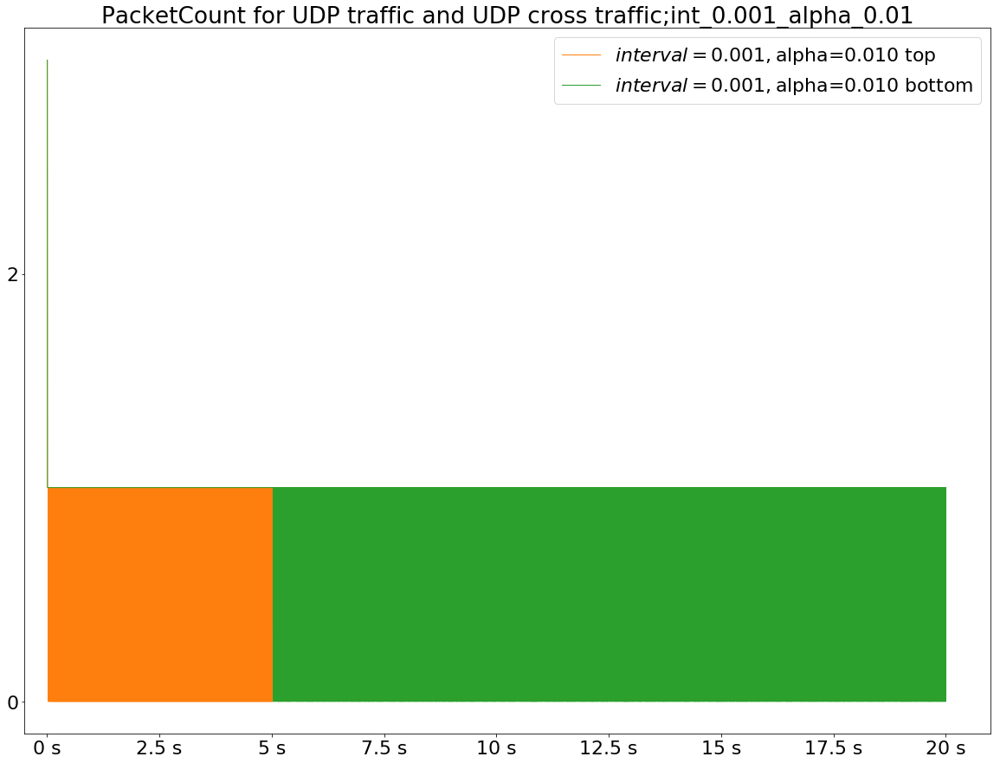

[3.]


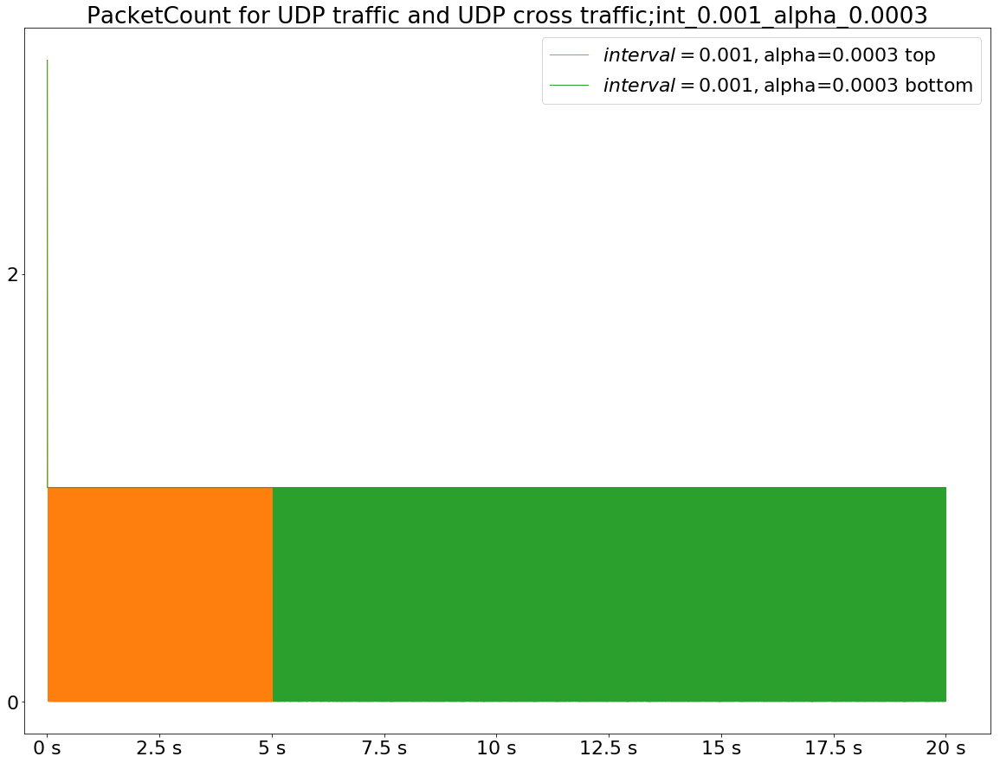

[3.]


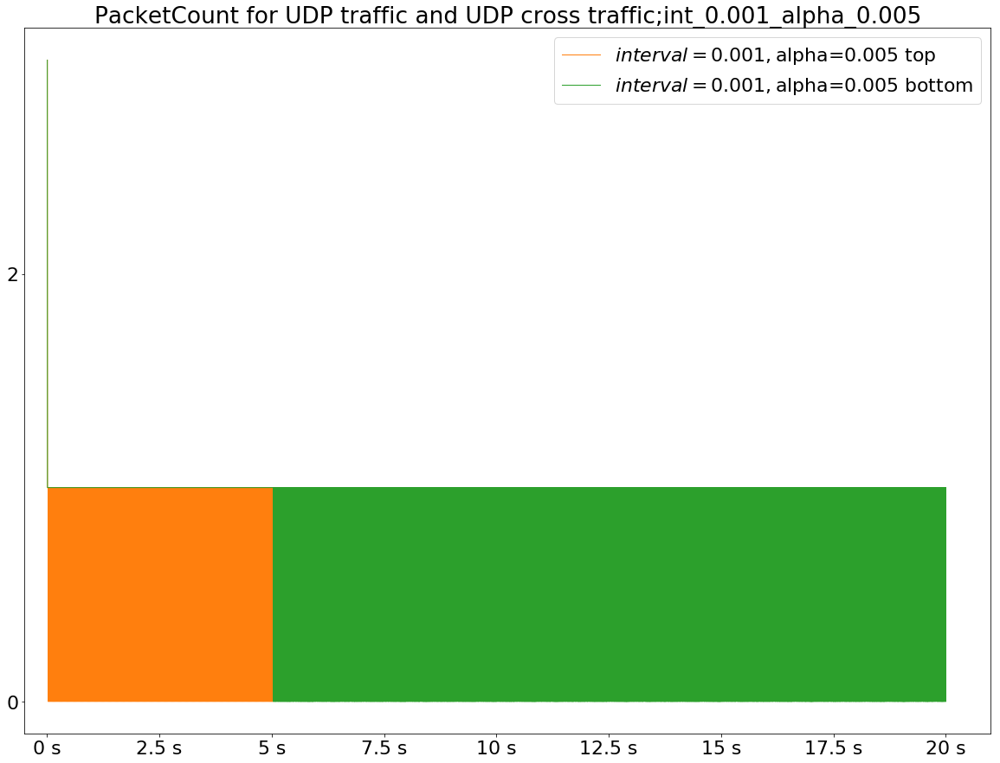

[3.]


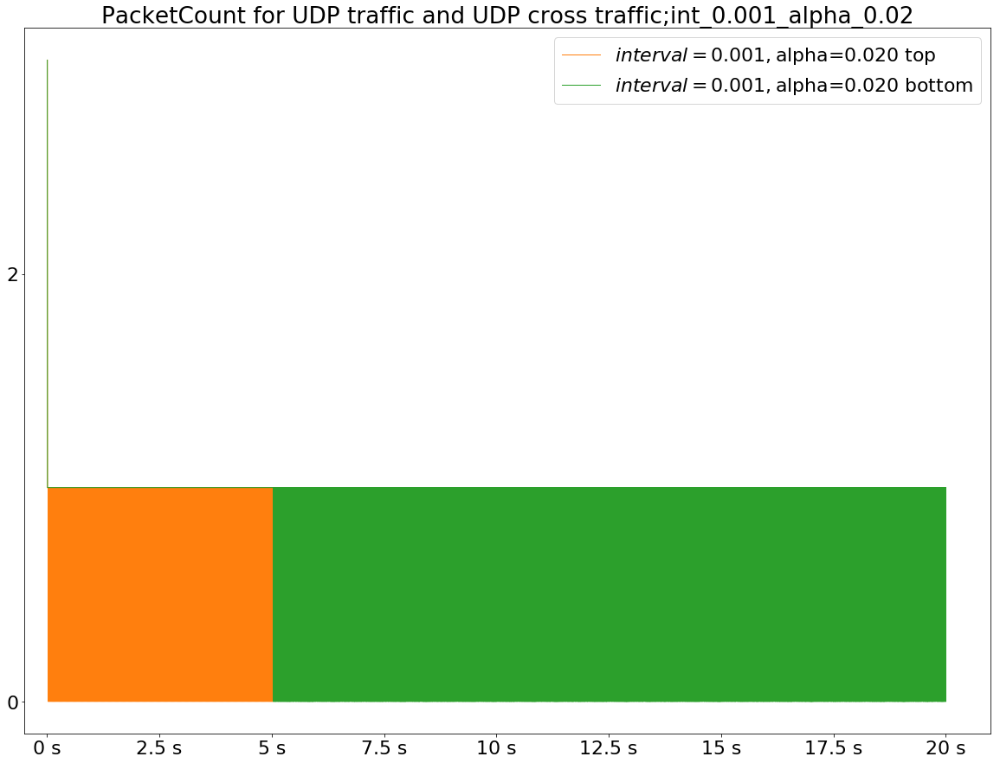

[3.]


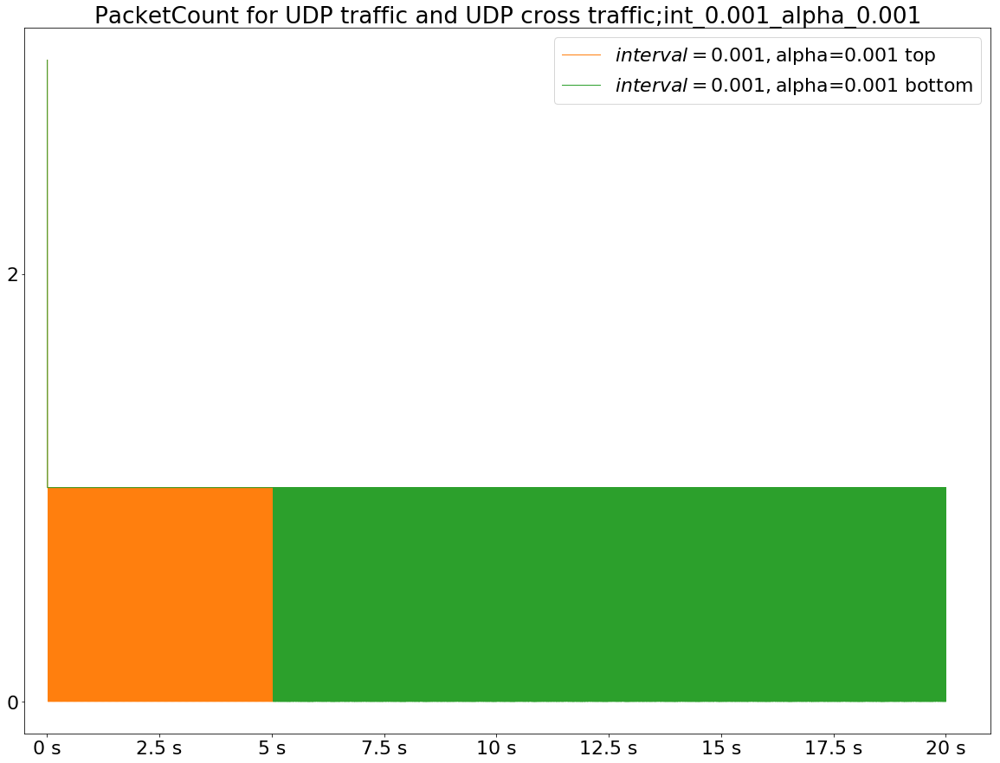

[3.]


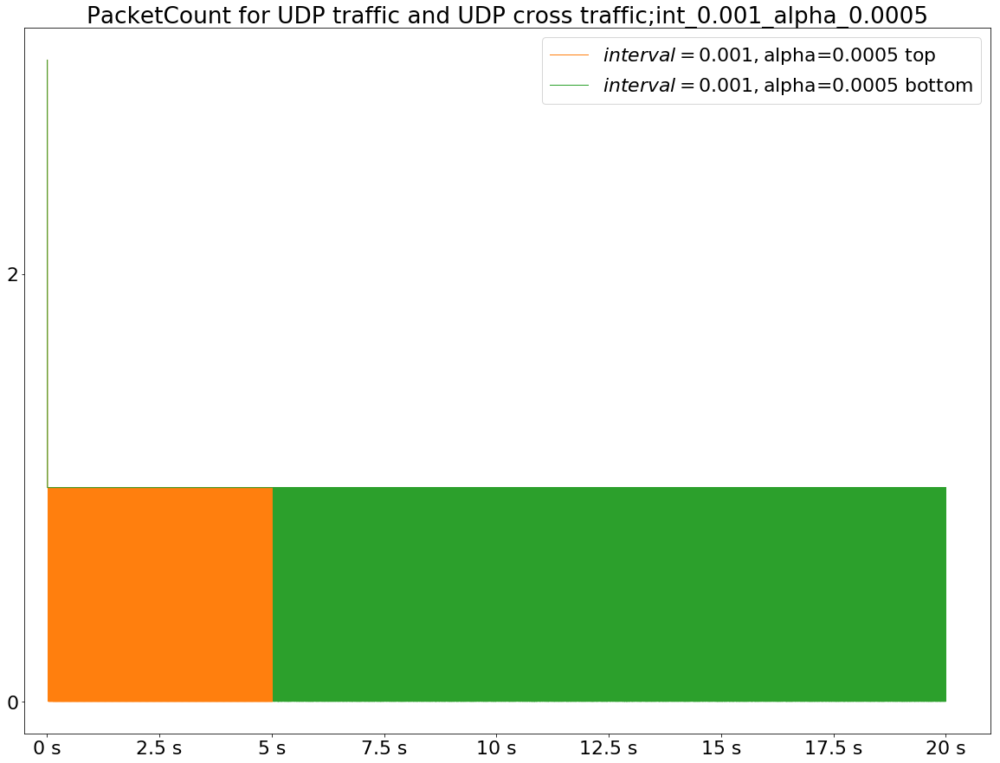

In [138]:
# Packet Count

final_version = False
save_figure = False
alphas= {0.1, 0.08, 0.05, 0.030, 0.020, 0.010, 0.005, 0.001, 0.0005, 0.0003}
intervals = {0.001, 0.005, 0.010, 0.020, 0.030, 0.040, 0.050, 0.060, 0.070, 0.080, 0.090, 0.1}
for interval in intervals:
    for alpha in alphas:
        figureName="fig/single_conn/Hex_UdpEcnFwdFPacketCount_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"
        backupFigureName="fig/single_conn/Backup_UdpEcnFwdFPacketCount_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"

        plt.rcParams["figure.figsize"] =(20,15)
        plt.rcParams.update({'font.size': 22})
        formatter_x = EngFormatter(unit='s')
        # formatter_y = EngFormatter(unit='bps')

        # max_min = vectors_arranged.drop_min_vectime.max()
        max_min = 0
        max_count = 0
        fig, ax = plt.subplots()
        ax.xaxis.set_major_formatter(formatter_x)
        # ax.set_yscale('log')
        # ax.yaxis.set_major_formatter(formatter_y)
        if(not final_version):
            ax.set_title("PacketCount for UDP traffic and UDP cross traffic;int_"+ str(interval) + "_alpha_"+ str(alpha))
        legend = list()
        # print(vectors_arranged[(vectors_arranged.queueCap > 1) &  (vectors_arranged.cross == "\"On\"")].columns)
        for row in vectors_toPlot[(vectors_toPlot.alpha == alpha)  & (vectors_toPlot.interval == interval)].itertuples():
        #     print(row)

        #     appThrough = row._5 # Hexagon.client499.app[0].rcvdPk:vector(packetBytes)
        #     appThrough = row.Hexagon_client499_app_0__rcvdPk_vector_packetBytes_
        #     bottom = row._14   
            bottom = row.Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_1__vector

        #     top = row._15
            top = row.Hexagon_routerCore1_dmpr_fwdPacketCount_192_168_4_0_eth_2__vector


            itervar = row.iterationvars

        #     hasDmpr = row.hasDmpr
            hasDmpr = True

        #     max_min = max(max_min, drop_min_vectime)
            if(final_version):
                if(hasDmpr):
                    legend.append("With mechanism")
                else:
                    legend.append("Without mechanism")
            else: 
        #         legend.append(itervar)
                legend.append(itervar + str(" top"))
                legend.append(itervar + str(" bottom"))

            color = next(ax._get_lines.prop_cycler)['color']


            if(not isnan(top)):
                plt.plot(top.index.total_seconds() - 20, top.values,  linewidth=1, )
                max_count = max(top.values)
                print(max_count)


            if(not isnan( bottom)):
                plt.plot(bottom.index.total_seconds() - 20, bottom.values,  linewidth=1,)



        plt.xlim(left= -0.5,right= 21)
#         plt.ylim(bottom=-0.01, top=1.01)
        plt.yticks(np.arange(0, max_count, step=2))
        ax.legend(legend)
        plt.show()
        if(save_figure):
            if(final_version):
                fig.savefig(figureName, bbox_inches='tight') 
            else:
                ax.legend(legend)
                fig.savefig(backupFigureName, bbox_inches='tight')

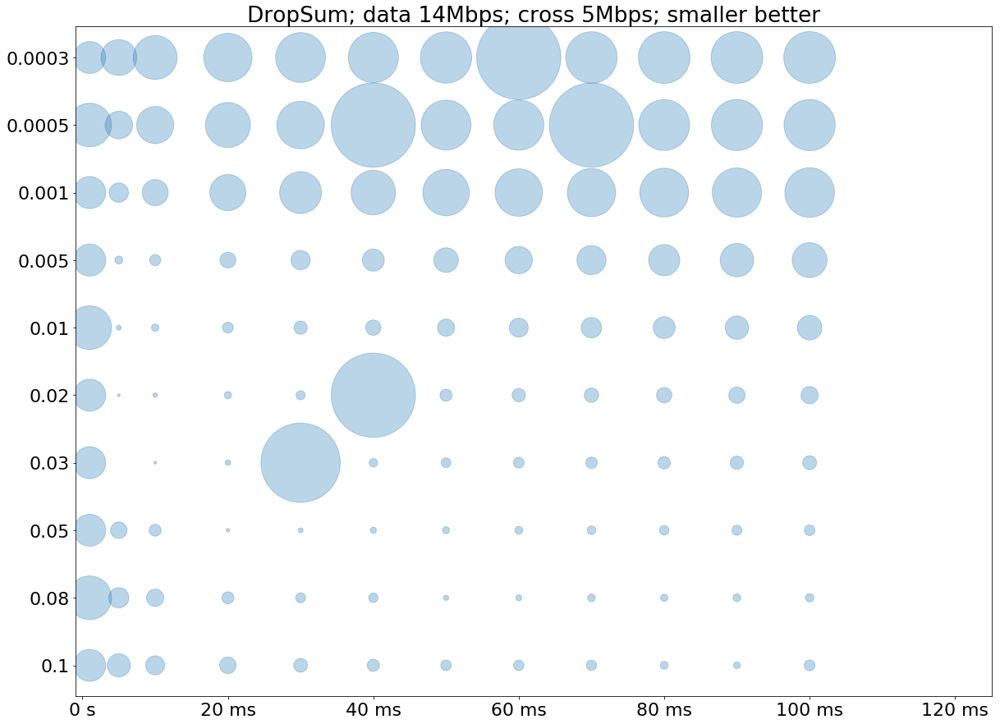

In [146]:
# Trying to plot throughput until first drop, plot the first drop time (at least as a tick on X-axis)

final_version = False
save_figure = True
alphas= (0.1, 0.08, 0.05, 0.03, 0.02, 0.01, 0.005, 0.001, 0.0005, 0.0003)
# print(alphas)
intervals = (0.001, 0.005, 0.010, 0.020, 0.030, 0.040, 0.050, 0.060, 0.070, 0.080, 0.090, 0.1)
# print(intervals)

figureName="fig/single_conn/Hex_UdpEcnFwdFDropSum_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"
backupFigureName="fig/single_conn/Backup_UdpEcnFwdFDropSum_int_"+ str(interval) + "_alpha_"+ str(alpha) +".pdf"

plt.rcParams["figure.figsize"] =(20,15)
plt.rcParams.update({'font.size': 22})
formatter_x = EngFormatter(unit='s')
# formatter_y = EngFormatter(unit='bps')

# max_min = vectors_arranged.drop_min_vectime.max()
max_min = 0
fig, ax = plt.subplots()
ax.xaxis.set_major_formatter(formatter_x)
# ax.set_yscale('log')
# ax.yaxis.set_major_formatter(formatter_y)
if(not final_version):
    ax.set_title("DropSum; data 14Mbps; cross 5Mbps; smaller better")
legend = list()
dropSumList = list()
alphaList = list()
intervalList = list()
hovno = pd.DataFrame(columns= ['alpha', 'interval', 'dropSum'])
for interval in intervals:
    for alpha in alphas:
        
        # print(vectors_arranged[(vectors_arranged.queueCap > 1) &  (vectors_arranged.cross == "\"On\"")].columns)
        for row in vectors_toPlot[ (vectors_toPlot.alpha == alpha)  & (vectors_toPlot.interval == interval)].itertuples():

            
            alphaList.append(alpha)
            intervalList.append(interval)
            dropSum = 0
            if("Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore1_eth_1__queue_red_packetDropCongestion_vector_packetBytes_.values.sum()

            if("Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore1_eth_2__queue_red_packetDropCongestion_vector_packetBytes_.values.sum()

            if("Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore2_eth_1__queue_red_packetDropCongestion_vector_packetBytes_.values.sum()
            
            if("Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_" in row._fields
              and not isnan(row.Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_)):
                dropSum =+ row.Hexagon_routerCore2_eth_2__queue_red_packetDropCongestion_vector_packetBytes_.values.sum()
            
            itervar = row.iterationvars

            hasDmpr = True
            
#             dropSum = dropSum/1000
            if(dropSum==0):
                
                dropSumList.append(2000)
            else:
                dropSumList.append(20000/dropSum)
        #     max_min = max(max_min, drop_min_vectime)


            color = next(ax._get_lines.prop_cycler)['color']
            hovno= hovno.append({"alpha": alpha,  'interval': interval, 'dropSum': dropSum}, ignore_index=True)
            


# print(hovno)
# print(intervalList)
# print(alphaList)
# print(hovno['dropSum'])
# y_pos = np.arange(len(intervalList))


plt.scatter(x = hovno['interval'], y= hovno['alpha'].astype(str), s=hovno['dropSum']/1000 , alpha=0.3)
# ax.set_yticklabels(range(len(hovno['alpha'])), labels=hovno['alpha'])
# plt.yticks(y_pos, alphas)
# locs, labels = plt.yticks() 
# print(locs)
# print(labels)
plt.xlim(left= -0.001,right= 0.125)
# plt.ylim(bottom= 0, top=0.11)
# ax.legend(legend)
plt.show()
if(save_figure):
    if(final_version):
        fig.savefig(figureName, bbox_inches='tight') 
    else:
        ax.legend(legend)
        fig.savefig(backupFigureName, bbox_inches='tight')
